In [286]:
import numpy as np
import matplotlib.pyplot as plt
import skimage.io
from skimage.color import rgb2lab, lab2rgb
from skimage.exposure import equalize_hist 
from PIL import Image
from pathlib import Path

Colour spaces of digital images

https://www.mathworks.com/help/images/understanding-color-spaces-and-color-space-conversion.html
Linear RGB - raw camera information - based directly proportional on the light that illuminates the sensor

sRGB - gamma corrected linear RGB - Matches human perception more closely for digital display

Lab - uniform colour space will explain later why it is needed for colour quantification than RGB (why Euclidian distances don't work) https://en.wikipedia.org/wiki/Color_difference


Evaluation of corrections - impossible to accurately evaluate in a non-uniform colour space => Lab 

delta E method enhancements - function for deltaE calculation and evaluation


Now, let's define the colour space conversion function in python :

- linear RGB - sRGB (works in both directions)
- sRGB - Lab (works in both directions)

Seeing the world with daltonism

The simulation based on biology research

     How does LMS related to linear RGB? 

-     research on transform matrices

python function = daltonism simulator 


show examples of each daltonism type



The corrections of the original - three methods : 



function for finding error and applying to original image based on biology research
- error ( https://acorn.stanford.edu/psych221/projects/2005/ofidaner/project_report.pdf ) - extension apply in Lab space

histogram strecthing 

confusion line avoidance and perpendicular stretching of colour (or safer region) with delta E constrained optimization



The evaluation of the correction

- delta E enhanced
- graphs - bar charts, heatmaps


Extensions:

deltaE2000, more complicated correction algorithms - E constrained optimization, machine learning (maybe for a later course?) 

Bibliography (hyperlink citations ? ) 



# Colour Vision Deficiencies: Implementation of the Brettel et al. (1997) Model, a K-Means Approach to Uncover Ishihara Plate Numbers, and Image Enhancement Using Lee and Santos (2010)

Aneta Gancheva

## 1. Introduction

Visual signals are used by humans to navigate the world, and color vision plays an integral part of the interpretation of those signals. However, roughly $8\%$ of Caucasian males, and $0,5\%$ of Caucasian females (Machalo and Olivera, 2009) experience altered color perception, known as color vision deficiency (**CVD**), also commonly referred to as "colour blindness". Possible consequences of misperception of colour are the inability to distinguish warning signals, difficulties in reading maps and graphs, or even overall impossibility to tell apart objects on a picture. People with a CVD are often prevented from obtaining driving licenses, and barred from careers that involve the accurate interpretation of coloured signals, such as professions in aviation or operating certain machinery.

This short and very limited in scope project aims to provide some insight on how colour blind people see the world, and to suggest an algorithm of partial improvement of images, so that they are easier to interpret by those with colour vision deficiencies. I, a trichromat, have unfortunately lived until very recently in complete ignorance of all topics concerning human vision and how colours are perceived (and mathematically modelled), so scientific research was not immediately clear to me. Therefore, I included "elaboration" paragraphs, denoted with the ![Explanation](excl_mark.png) symbol (free to use, https://www.iconfinder.com/), where I attempted to clarify concepts to myself.

Let's now begin with a few short paragraphs on human colour vision and types of CVD.

### 1.1. Human color perception 

There are two types of cells that react to light in the human retina (photoreceptor cells) - cones and rods. Their names are closely related to the shape they have.

**Rods** are extremely sensitive to even small amounts of light and make up the larger part of the photoreceptor cells. They give humans the ability to see in low light conditions. **Cones** on the other hand need more light to activate, but are responsible for colour detection. They are concentrated towards the center of the retina, the macula. Figure 1. provides an illustration. 

<figure>
  <img src="./pictures_and_graphs/rods_cones_clevelandclinic2024.jpg" alt="Rods and cones in the human eye" style="width:30%">
  <figcaption><b>Fig.1</b> - Rods and Cones in the human eye. <br> Source link: https://my.clevelandclinic.org/health/body/photoreceptors-rods-and-cones </figcaption>
</figure>

As this project concerns colour vision, we would hereafter ignore the effect of rods on vision, and focus on cones.

### 1.2. Types of cones 

<div style='text-align: justify;'>  
Cones are sensitive to different wavelengths of light, and can thus, be divided into three types: 

* S-cones: most sensitive to short wavelengths. Peak sensitivity around $420 \text{nm}$ (blue light spectrum)
* M-cones: most sensitive to medium wavelengths. Peak sensitivity around $534 \text{nm}$ (green light spectrum)
* L-cones: most sensitive to long wavelengths. Peak sensitivity around $564 \text{nm}$ (red light spectrum)

Having all three cone subtypes means having normal three-channel colour vision and is called **thrichromacy** . An interesting fact is that some animals (e.g. birds) and some people are tetrachromats and can porcess four channels.
</div> 

### 1.3. Types of CVD 

<div style='text-align: justify;'>  
CVD arises when one or more types of cone cells are missing or function abnormally. This condition can range from mild to severe, depending on whether the cone’s response is reduced or completely absent.
</div>

#### 1.3.1. Anomalous Trichromacy

<div style='text-align: justify;'>  
A condition in which all three cones are present but one is spectrally shifted, reducing sensitivity to a part of the color spectrum.

* Protanomaly: Reduced sensitivity to long (red) wavelengths (L-cone anomaly)

* Deuteranomaly: Reduced sensitivity to medium (green) wavelengths (M-cone anomaly)

* Tritanomaly: Reduced sensitivity to short (blue) wavelengths (S-cone anomaly)
</div>

<figure>
  <img src="./pictures_and_graphs/cones_0_cambiocteach.webp" alt="Anomalous trichromacy" style="width:30%">
  <figcaption><b>Fig.2(a)</b> - Anomalous trichromacy <br> Source link: https://cambiocteach.com/accessibility/colourblind/ </figcaption>
</figure>


#### 1.3.2. Dichromacy

<div style='text-align: justify;'>  
A more severe form of CVD where one cone type is completely absent.

* Protanopia: Absence of L-cones

* Deuteranopia: Absence of M-cones 

* Tritanopia: Absence of S-cones

<figure>
  <img src="./pictures_and_graphs/cones_1_cambiocteach.webp" alt="Dichromacy" style="width:30%">
  <figcaption><b>Fig.2(b)</b> - Dichromacy <br> Source link: https://cambiocteach.com/accessibility/colourblind/ </figcaption>
</figure>

#### 1.3.3. Monochromacy

<div style='text-align: justify;'>  
A very rare condition (<0.003% of the population), where either:

* Two or all three cone types are not functioning correctly, or

* Cones are completely absent (rod monochromacy)

<figure>
  <img src="./pictures_and_graphs/cones_2_cambiocteach.webp" alt="Monochromacy" style="width:30%">
  <figcaption><b>Fig.2(c)</b> - Monochromacy <br> Source link: https://cambiocteach.com/accessibility/colourblind/ </figcaption>
</figure>

In this case, the individual has no ability to distinguish colors at all. While also very interesting, monochromacy is excluded from this project, as it requires a deep understanding of rod vs. cone vision.

#### 1.3.4. Occurrence of each CVD type 

I was curious how prevalent are all of these CVDs, and I found the below table from Kolb et al (1995). 

<figure>
  <img src="./pictures_and_graphs/Kolbetal1995_prevalence.png" alt="Prevalence of different types of CVD" style="width:30%">
  <figcaption><b>Table 1.</b> - Prevalence of different types of CVD <br> Source link: https://www.ncbi.nlm.nih.gov/books/NBK11538/table/ch28kallcolor.T1/ </figcaption>
</figure>

We see that the most common CVDs are the red-green ones - most prevalent being deutanomaly ($5\%$ of people) and deuteranopia ($1,5\%$ of people). The rarest CVDs seem to be the ones involving S-cone anomalies with tritanopia accounting only for $0,008\%$ of people.

### 1.4. How do we identify and diagnose colour blindness? 

The NHS website provides a guidance of how to detect and diagnose CVDs. Usually colour blindness begins at childhood, but age of onset varies.

Red-green colour blindness is usually inherited. The gene that causes it is only found on the X-chromosome. Therefore, for a male to be colour blind, he needs to inherit the X chromosome gene from a carrier or colour blind mother. For a female to be colour blind, she must inherit the gene on both X chromosomes - one from a colour blind father, and the other one from a carrier or colour blind mother. This explains why the prevalence of protanopia and deuteranopia shown in 1.3.4. is much higher in men than in women!

Hereditary colour blindness is usually evident from an early age and children who confuse colours in colouring tasks, smell foods before eating them, or lack interest in activities involving colour, should be tested formally for CVD. Some health conditions can also cause colour blindness at a later age, e.g. glaucoma, diabetes, liver disease, multiple sclerosis, eye/head injuries, stroke, or taking certain medicines.

The **Ishihara test** is the most widely used colour vision test for detection of red-green colour deficiencies. For instance, it is mandatory during the US Navy screening process. During this test, a person is asked to read images consisting of coloured dots, where different responses are expected from trichromats and people with red-green colour deficiencies. The full test consists of 38 plates, which I found online and decided to group the plates into a few different types:

* plates on which the trichromat and the person with red-green CVD would see **different** numbers

<figure>
  <img src="./image_inputs/Ishihara_plate_6.png" alt="Ishihara plate 6." style="width:20%">
  <figcaption><b>Fig 3(a) Ishihara plate 6.</b> <br> Trichromat: 5 <br> Red-green deficiency: 2 <br> Source link: https://challengetb.org/publications/tools/country/Ishihara_Tests.pdf </figcaption>
</figure>
  
* plates on which the trichromat will see a number, but the person with red-green CVD will see **no number**

<figure>
  <img src="./image_inputs/Ishihara_plate_10.png" alt="Ishihara plate 10." style="width:20%">
  <figcaption><b>Fig 3(b) Ishihara plate 10.</b>  <br> Trichromat: 2 <br> Red-green deficiency: no number <br> Source link: https://challengetb.org/publications/tools/country/Ishihara_Tests.pdf </figcaption>
</figure>
  
* plates on which the trichromat will see **no number**, but the person with red-green CVD will see a number


<figure>
  <img src="./image_inputs/Ishihara_plate_18.png" alt="Ishihara plate 18." style="width:20%">
  <figcaption><b>Fig 3(c) Ishihara plate 18.</b>  <br> Trichromat: no number <br> Red-green deficiency: 5 <br> Source link: https://challengetb.org/publications/tools/country/Ishihara_Tests.pdf </figcaption>
</figure>

  
* plates on which two numbers are present but a person with red-green CVD will have difficulty seeing one of them; these are also useful to differentiate between L-cone and M-cone CVDs

<figure>
  <img src="./image_inputs/Ishihara_plate_23.png" alt="Ishihara plate 23." style="width:20%">
  <figcaption><b>Fig 3(d) Ishihara plate 23.</b>  <br> Trichromat: 42 <br> L-cone deficiency: 2 <br> M-cone deficiency: 4 <br> Source link: https://challengetb.org/publications/tools/country/Ishihara_Tests.pdf </figcaption>
</figure>

  
* plates without numbers, where either the trichromat or the person with red-green CVD should see a solid line

  
<figure>
  <img src="./image_inputs/Ishihara_plate_29.png" alt="Ishihara plate 29." style="width:20%">
  <figcaption><b>Fig 3(e) Ishihara plate 29.</b>  <br> Trichromat: no solid line <br> Red-green deficiency: solid line <br> Source link: https://challengetb.org/publications/tools/country/Ishihara_Tests.pdf </figcaption>
</figure>

But what about tritanopia and tritanomaly? This is where I got very confused. Resources online differ in suggesting how those are diagnosed, and some even suggest that people with S-cone anomalies also struggle with the Ishihara plates, despite those being designed for red-green CVDs. I found some non-Ishihara colour tests online but I find that I struggle to do interpret some of the images correctly myself, due to the test being non-unified, and possibly because of my monitor settings. I found a thread on Reddit, where a user has shared custom created Ishihara plates to identify tritanopia, and the comments suggested they are fairly successful. As it is a public source, I have decided to present two of the custom made plates below

<figure>
  <img src="./image_inputs/Reddit_user_plate.png" alt="Reddit user custom tritanopia plate" style="width:20%">
  <figcaption><b>Fig 3(f) Reddit user custom tritanopia plate.</b>  <br> Trichromat: 45 <br> Blue-yellow deficiency: no number <br> Source link: https://www.reddit.com/r/ColorBlind/comments/yqzurv/hi_me_again_with_another_set_of_tritan_plates_ive/ </figcaption>
</figure>

<figure>
  <img src="./image_inputs/Reddit_user_plate_70.png" alt="Another Reddit user custom tritanopia plate" style="width:20%">
  <figcaption><b>Fig 3(g) Another Reddit user custom tritanopia plate.</b>  <br> Trichromat: 29 <br> Blue-yellow deficiency: 70 <br> Source link: https://www.reddit.com/r/ColorBlind/comments/yqzurv/hi_me_again_with_another_set_of_tritan_plates_ive/ </figcaption>
</figure>


### 1.5. What is this project about?

This project will have three main parts.

1. It will examine the Brettel et al (1997) framework and implement the algorithm to simulate CVD for protanopia, deuteranopia and tritanopia
2. It will aim to uncover the Ishihara plate numbers from plates $6$, $10$ and the custom Reddit tritanopia plate with number $29$, alongside with objects "lost" to CVD.
3. It will examine whether the Lee and Santos (2010) correction would both uncover these numbers and "lost" objects, maintaining more visually pleasant results.

Assumptions: 

* The Brettel et al (1997) framework presents an accurate representation of CVD.
* The main goal of uncovering the plate numbers and "lost" objects is more important than maintaining a visually pleasant simulated image

Definitions: 

* "Lost" objects are such objects that are only identifiable by their colour, and they have been lost to the CVD person. For protanopes those would be red objects, for deuteranopes - green objects, and for tritanopes - blue objects. These objects are assumed to have a relatively pure colour value, i.e. for example, an object will not be treated as lost if it is $50\%$ red and $50\%$ blue for protanopes. It is imperative to answer the question: which is the "lost" object in each simulated picture, i.e. simply identify it.
* For Ishihara plate numbers, it is necessary to simply be able to read the correct number again as a CVD individual.

Let's not begin by discussing colour spaces briefly, and move on to the main parts of the project.

## 2. Colour spaces

So far we have discussed colours rather intuitively, but how do we know if two colours are the same, or different? Can we measure how different?

We need to organize colours into **colour spaces**, which will support reproducible representations of colour. It is the set of all colours that can be displayed by a certain medium. To describe a colour (e.g. as a vector), we use a **colour model** . Colour models can be based on physical properties (e.g. mixing of light), or on human perception (experimental results).

Let's now consider a few representations of colour.

### 2.1. The RGB colour model 

The RGB (red, green, blue) colour model is an additive colour model, in which one red, one green and one blue light beam are superimposed to create another colour. This could be represented in Cartesian coordinates in 3D space with the basis formed by the blue ($\vec{B}$), green ($\vec{G}$) and red ($\vec{R}$) primaries. Each of the colour primaries has an intensity component ranging from $0$ to $1$ , which is the "brightness" characteristic of that colour. 

<figure>
  <img src="./pictures_and_graphs/RGB_Venn.png" alt="Venn diagram of RGB primaries" style="width:10%">
  <figcaption><b>Fig 4.</b> A Venn diagram that depicts the additive nature of the RGB primaries <br> Source link: https://en.wikipedia.org/wiki/RGB_color_model </figcaption>
</figure>

<figure>
  <img src="./pictures_and_graphs/RGB_Cartesian_coord.png"" alt="RGB Cartesian coordinate system" style="width:30%">
  <figcaption><b>Fig 5.</b> An RGB Cartesian coordinate system. Each point is a linear combination of the three primaries. The cube is the RGB colour space. The linear combination of all three primaries is the White corner. The linear combination of Red and Green is the Yellow corner. The linear combination of Blue and Green is the Cyan corner. The linear combination between Blue and Red is the Magenta corner. At the origin of the coordinate system, we have Black.  <br> Source link: https://www.geeksforgeeks.org/computer-graphics-the-rgb-color-model/ </figcaption>
</figure>

#### 2.1.1. linear RGB space

In 1931 The International Commission on Illumination (CIE) have defined colour spaces based on a series of experiments where people were asked to adjust red, green and blue primary colours in order to match a reference colour on a screen. The experimental participants are regarded as CIE standard observers, who are assumed to have an idealized human retina and all perceive colours perfectly. These experiments have lead to the definition of the linear CIE RGB space. We have therefore the following colour matching functions: 

<figure>
  <img src="./pictures_and_graphs/CIERGB1931_color_matching_fns.png" alt="CIERGB 1931 colour matching functions" style="width:30%">
  <figcaption><b>Fig 6.</b> CIERGB 1931 colour matching functions. Any colour corresponding to a wavelength of the x-axis can be achieved by mixing the corresponding primaries amount, shown on the y-axis. <br> Source link: https://en.wikipedia.org/wiki/CIE_1931_color_space </figcaption>
</figure>

So, any colour with wavelength $\lambda$ (x-axis) could be achieved with the y-axis amount of the three primaries: red, green and blue. 

<span style="color:blue">***</span>

![Explanation](./pictures_and_graphs/excl_mark.png)

Okay, so why is that portion of the red matching curve negative? How do we add a negative amount of red primary? A 2019 forum post from the Digital Photography Review explains that certain reference colours could not be matched by the experiment participants, e.g. for the negative red portion - even when the red primary was turned to zero. Therefore, red was added to the reference colour, in order for matching to be achieved. Therefore - the negative values in some portions of the colour matching functions.

<span style="color:blue">***</span>

Now, let's briefly return to the intensity component. Intensity could also be understood as the brightness of "gray" that a colour has. In linear RGB space, the numbers that store the intensity values, and the intensity they represent have a linear relationship. So, if you double the intensity number of a colour, you are expected to double the "brightness" of the gray to it.

#### 2.1.2. sRGB space

Linear RGB sounds really straightforward, but unfotunately two problems are present. Firstly, as the RGB model is the one used on computer displays, we need to note that the pixel colour is not linearly dependent on the applied voltage signal for that pixel. One of the early resolutions for CRT monitors was with a gamma correction, such that: 

$$ \text{Colour}_{output} \sim \text{Colour}_{input}^\gamma $$

, with $\gamma \approx 2,2$ for monitor displays.

Secondly, the human eye is also more sensitive to light at low intensities than high ones. To capture this, the **sRGB** standard was invented in 1996 and standardized in 2003 by the International Electrotechnical Commission as: 

$$ \text{sRGB} =
\begin{cases} 
12,92\text{RGB}_{\text{linear}} & \text{if } \text{RGB}_{\text{linear}}\leq0,0031308\\
1,055(\text{RGB}_{\text{linear}})^{\frac{1}{2,4}}-0,055 & \text{if } \text{RGB}_{\text{linear}}\gt0,0031308
\end{cases}
$$

The RGB to sRGB case is defined by the International Electrotechnical Commission in 1999 as:

$$
\text{RGB}_{\text{linear}} =
\begin{cases} 
\frac{\text{sRGB}}{12,92} & \text{if } \text{sRGB}\leq0,04045\\
(\frac{\text{RGB}+0,055}{1,055})^{2,4} & \text{if } \text{sRGB}\gt0,04045
\end{cases}
$$

The two transformations are valid for all three RGB channels.

I have cited the standard for the inverse of the sRGB to RGB function, as due to rounding up, these two functions are not exactly inverse of each other, due to a discountinuity. However, Summers (2012) reports that the error is too small to matter in practical applications.

sRGB is the current standard colorspace for the web, and it is the assumed colorspace of images by computer image processing software.

#### 2.1.3. RGB/sRGB transformation function in code

Let's now code the above standard into a short Python function that we will need later.

In [86]:
def RGB_sRGB_transform(transform: str, input_img: np.array) -> np.array:
    """
    Convert between linear RGB and gamma-compressed sRGB.

    This function applies the standard sRGB gamma correction or its inverse,
    depending on the direction specified by `transform`.

    Args: 
        transform (str): Either "to_RGB" (sRGB to linear RGB) or "to_sRGB" (linear RGB to sRGB).
        input_img (np.ndarray): Array containing RGB image data, scaled between [0, 1].

    Returns:
        np.ndarray: Transformed image in the target color space (same shape as `input_img`).
    """
    
    if transform == "to_RGB":
        mask = input_img <= 0.04045
        return np.where(mask, input_img / 12.92, ((input_img + 0.055) / 1.055) ** 2.4)
        
    elif transform == "to_sRGB":
        mask = input_img <= 0.0031308
        return np.where(mask, 12.92 * input_img, 1.055 * (input_img ** (1 / 2.4)) - 0.055)

### 2.2. The XYZ colour space

Let's get back to the CIE colour spaces, and their experimentally defined colour matching functions.

The CIE has decided to further define another colour space which will be linearly related to the RGB colour space and the colour matching function velues would be greater or equal to zero. This was called the **XYZ-space**, defined by the primaries X, Y and Z, instead of R, G and B. 

Y is defined as the luminance, and is a measure of colour brightness. As opposed to the intensity value in RGB, it is defined as the amount of light that corresponds to a perceived brightness. (Jain et al, 1995) Z corresponds to a shorter wavelength of light (so similar to blue in RGB) and X corresponds to both short and long wavelength of light (so somewhat a mixture of the RGB primaries). This is evident from the graph below: 

<figure>
  <img src="./pictures_and_graphs/CIE_1931_XYZ_Color_Matching_Functions.png" alt="CIEXYZ 1931 colour matching functions" style="width:30%">
  <figcaption><b>Fig 7.</b> CIE XYZ 1931 colour matching functions. Any colour corresponding to a wavelength of the x-axis can be achieved by mixing the corresponding primaries amount, shown on the y-axis. Note that all function values are non-negative. <br> Source link: https://en.wikipedia.org/wiki/CIE_1931_color_space </figcaption>
</figure>

We will not explicitly use the XYZ-space in our calculations, but it should be noted that CIE defines colour spaces via the XYZ-space ( https://cie.co.at/eilvterm/17-23-076 ). It is, thus, a fundamental colour space, that I wanted to be familiar with, to understand representations of colour better.


### 2.3. LMS colour space

Now we turn back to the main point of interest - human eye and its three types of cones that allow us to see colour - L, M and S type. 

An LMS colour space allows us to model the normal colour perception in 3D, with basis the $\vec{L}$, $\vec{M}$ and $\vec{S}$ vectors, so that each color stimulus would be a 3D vector $\vec{Q}$ and represented by its LMS components $\begin{pmatrix} L_{Q} \\ M_{Q} \\ S_{Q} \end{pmatrix}$ .

One of the most popular charts that is available online is the normalized sensitivity chart, which relates the cone response amount (on the y-axis) stimulated from different wavelengths of light (on the x-axis).

<figure>
  <img src="./pictures_and_graphs/Normalized_responsivity_spectra_cones.png" alt="Normalized responsivity of cones to different wavelengths of visible light" style="width:30%">
  <figcaption><b>Fig 8.</b> Normalized responsivity of cones to different wavelengths of visible light <br> Source link: https://en.wikipedia.org/wiki/LMS_color_space </figcaption>
</figure>

This chart has been derived by Stockman and Sharpe (1993, 2000) by using linear combinations of $\bar{x}(\lambda)$, $\bar{y}(\lambda)$ and $\bar{z}(\lambda)$ for the XYZ colour space. 


### 2.4. CIELAB
https://data.europa.eu/apps/data-visualisation-guide/colour-for-numerical-data-perceptual-uniformity 

RGB is not a perceptually uniform colour space. What this means is that although we can take the difference between two colours (e.g. as their distance in the RGB cube), that would not reflect proportionally the colour change we perceive. For this reason, we turn our attention to the perceptually uniform colour space CIE LAB, where there is a linear dependence of the difference between two colours and their perceived change. 

In CIE LAB the colour $\vec{Q}$ is descibed by its components $\vec{Q} = \begin{pmatrix} L^{*} \\ a^{*} \\ b^{*} \end{pmatrix}$, where $L^{*}$ is the lightness value of the colour, or how much "gray" it containes. $L^{*}=0$ signifies black and $L^{*}=1$ signifies white. $a^{*}$ is the red-green amount in that colour, where for $a^{*} \gt 0 $ the colour value is more towards red, and for $a^{*} \lt 0 $ the colour value is more towards green. $b^{*}$ is the blue-yellow component with $b^{*} \gt 0$ more towards yellow and $b^{*} \lt 0$ more towards blue. 

<figure>
  <img src="./pictures_and_graphs/L-a-b-color-spaces.png" alt="LAB colour space graph of values" style="width:30%">
  <figcaption><b>Fig 9.</b> LAB colour space possible values for $L^{*}, a^{*}, b^{*}$. $L^{*} \in [0,100], a^{*}\in [-128,127], b^{*}\in [-128,127]$  <br> Source link: https://www.researchgate.net/figure/L-a-b-color-spaces_fig3_330583380 </figcaption>
</figure>


Now that we have briefly discussed the colour spaces relevant to this project, it is time to provide an overview of the paper the findings of which would be used to simulate colour blindness.

## 3. Brettel et al (1997)

### 3.1. Why is this paper chosen for this project? 

Brettel et al (1997) is widely considered to be the first modern algorithm that models dichromatic colour perception. It is also widely cited, and still widely used in practice.

The Horizon Lab (University of Rochester) explains that Brettel et al (1997) is first of a series of phenomenological models to describe colour vision deficiencies. Such papers are driven by experimental data and have less consideration of how human vision actually works. Therefore, they build simplistic models that fit around experimental results. The other type of research on human vision is the first principles one. It creates models based on the science behind human vision.

Constroversially though , first principles research is yet to produce results that fit experiemental evidence as well as phenomenological research. This is why phenomenological researcg both dominates literature, and is used in assistive technologies.

Brettel et al (1997) is not the only fundamental phenomenological paper, but I have chosen it because it is the first that produces a successful simulation of dichromatic vision. Moreover, other papers often do not consider tritanopic vision. I assume that tritanopia is less interesting for scientific consideration, as it is very rare, but I was personally curious how all three types of dichromats see the world. Let's now dive in the mathematical model of Brettel et al (1997) and try to understand the rationale behind it.

### 3.2. Overview of the model for simulating dichromacy

This paper uses a Cathode-ray tube (CRT) monitor and expresses additive colour mixing on the monitor as:
$$ \vec{Q} = R_{Q}\vec{P_{R}} + G_{Q}\vec{P_{G}} + B_{Q}\vec{P_{B}} $$

, where $ \vec{P_{R}} $, $ \vec{P_{G}} $ and $ \vec{P_{B}} $ are the three CRT primaries at maximum intensity. Weighting factors attached to them $ R_{Q}, G_{Q}, B_{Q} $ range from $0$ to $1$ and determine the relative primary contribution to the color stimulus $\vec{Q}$ . 

Subsequently, $\vec{Q}$ and the three CRT primaries $\vec{P_i}$, $i=R,G,B$ are expressed in their LMS tristimulus values, s.t.

$$ \vec{Q} = \begin{pmatrix} L_{Q} \\ M_{Q} \\ S_{Q} \end{pmatrix} $$
$$ \vec{P_i} = \begin{pmatrix} L_{i} \\ M_{i} \\ S_{i} \end{pmatrix} $$

$i=R,G,B$. 

In LMS tristimulus form, the equation for the color stimulus becomes: 

$$ \begin{pmatrix} L_{Q} \\ M_{Q} \\ S_{Q} \end{pmatrix} = \begin{pmatrix} L_{R} & L_{G} & L_{B} \\ M_{R} & M_{G} & M_{B} \\ S_{R} & S_{G} & S_{B} \end{pmatrix} \begin{pmatrix} R_{Q} \\ G_{Q} \\ B_{Q} \end{pmatrix} \tag{*}$$

Let's denote the transformation matrix $\begin{pmatrix} L_{R} & L_{G} & L_{B} \\ M_{R} & M_{G} & M_{B} \\ S_{R} & S_{G} & S_{B} \end{pmatrix} $ as $\vec{T}$ , and $ \begin{pmatrix} R_{Q} \\ G_{Q} \\ B_{Q} \end{pmatrix} $  as $\vec{V}$. 

The elements of $\vec{T}$ are the LMS tristimulus values of the CRT primaries, which are given in the following table from Brettel et al (1997) where the LMS tristimulus values for Red, Green and Blue primaries, as well as nominal White are derived for a reference CRT monitor.

<span style="color:blue">***</span>

![Explanation](./pictures_and_graphs/excl_mark.png)

##### Short overview of the method to obrain Table 1. values 

For any given color stimulus $\vec{Q} = \begin{pmatrix} L_{Q} \\ M_{Q} \\ S_{Q} \end{pmatrix}$ the LMS vector components are derived from the spectral power distribution of the stimulus ($\phi_{Q}(\lambda)$) and three weighting functions. The weighting functions are tied to the results of another fundamental paper - Stockman et al (1993), who provide formulae for the cone fundamentals from the CIE_{1994} supplementary standard colometric observer, which Brettel et al (1997) scale for convenience. A common scaling factor is added to the functions, such that $L_{Q} + M_{Q} = 1 $ for the White stimulus.

The above is represented by the following integration functions over wavelengths $\lambda$ of the visible range: 

$$ L_{Q} = k \int \phi_{Q}(\lambda)\bar{l}(\lambda)\text{d}\lambda $$
$$ M_{Q} = k \int \phi_{Q}(\lambda)\bar{m}(\lambda)\text{d}\lambda $$
$$ S_{Q} = k \int \phi_{Q}(\lambda)\bar{s}(\lambda)\text{d}\lambda $$

Here some questions arose for me.

* What is the spectral power distribution $\phi(\lambda)$ and what is the visible spectral range? 

From Brainard (2001) I find the following definition: " A light's spectral power distribution specifies the amount of power it contains at each wavelength in the visible spectrum, often taken to lie roughly between 400 and 700 nm" . So, tristimulus value are obtained by integrating the product of the spectral power distribution $\phi(\lambda)$ and a weighted function, over wavelength. This will provide a three-dimensional space that our colour would reside in. With normalization coefficient $k$, we would get a model relating $L$, $M$ and $S$ values for each wavelength, similar to Fig.8.

* What is the White stimulus in this paper?

From the transformation table (below), the White stimulus is the nominal White stimulus obtained with Red, Green, and Blue video channel signals at maximum. Thus, the LMS-coordinates for the nominal white are the $L$, $M$ and respectively $S$ coordinates for R,G,B. Further in the paper there is an equal energy White stimulus $\vec{E}$, which would mean that it contains equal energy at each wavelength in the visible region of the spectrum. (Bouman, 2025)

Finally, to obtain table values, the above equations are used, alongside with measures for $\phi_{R}(\lambda)$, $\phi_{G}(\lambda)$, $\phi_{B}(\lambda)$ obtained with a spectroradiometer on a calibrated monitor. 

<span style="color:blue">***</span>


##### <center> **Table 1. LMS Tristimulus values for R,G and B primaries and nominal white (W) for CRT monitor with respective pixel values at maximum** </center>
###### <center> Brettel et al (1997) </center>

|   | i = R | i = G | i = B | i = W |
| --- | --- | --- | --- | --- |
| $L_{i}$ | 0.1992 | 0.4112 | 0.0742 | 0.6846 |
| $M_{i}$ | 0.0353 | 0.2226 | 0.0574 | 0.3153 |
| $S_{i}$ | 0.0185 | 0.1231 | 1.3550 | 1.4966 | 

Then, from Eq. (*) 's inverse $\vec{V} = \vec{T}^{-1} \vec{Q}$ we can compute $\begin{pmatrix} R_{Q} \\ G_{Q} \\ B_{Q} \end{pmatrix}$ , the RGB values of an LMS specified color stimulus.

Geometric representation **TODO: fix here**

Brettel et al (1997) proceeds to provide a geometric representation of the algorithm.

On a 3D space, there lie three orthogonal vectors L, M and S which represent the light action of each of the three cone classes, and form the space basis. The gamut of color stimuli that could be obtained on a CRT monitor are enclosed in a parallelepiped. The white stimulus is obtained by having the Red, Green and Blue channel signals at maximum. $E$ denotes the equal energy stimulus on the monitor, and is selected as a neutral color. Thus, OE represents the neutral stimuli for both dichromats and trichromats. Neutral axis OE divides the surface of reduced stimuli into two half-planes, each anchored on an invariant hue point for a given type of dichromat.

Fig 1(a) The intersection of the surface of reduced stimuli with the parallelepiped of CRT colours consists of two wings for protanopia and deuteranopia - wings from OE toward the 475-nm and 575-nm anchors. 

Fig 1(b) The intersection of the surface of reduced stimuli with the parallelepiped of CRT colours consists of two wings for tritanopia -  wings from OE towards the 485-nm and 660-nm anchors. 

Why these wavelengths are chosen for the wings exactly? The paper reports that a stimulus of 575 nm is perceived as the same yellow and a stimulus of 475 nm as the same blue, by trichromats, protanopes and deuteranopes. Furthermore, a stimulus of 660 nm is perceived as red and a stimulus of 485 nm as blue-green by tritanopes. Thus, the wings are defined as **confusion lines**.

The daltonism simulation equations

Any stimulus $\vec{Q^\prime}$ on a plane defined by origin $\vec{O}$ , $\vec{E}$ and the monochromatic anchor stimulus $\vec{A}$ is then:

$$ (\vec{E} \times \vec{A})\vec{Q^\prime} = 0 $$

, since $\vec{Q^\prime}$ is orthogonal to the normal vector $\vec{E} \times \vec{A}$ of the plane .

For $\vec{E} = \begin{pmatrix} L_{E} \\ M_{E} \\ S_{E} \end{pmatrix}$ and $\vec{A} = \begin{pmatrix} L_{A} \\ M_{A} \\ S_{A} \end{pmatrix}$, then:

$$ \begin{pmatrix}\begin{pmatrix} L_{E} \\ M_{E} \\ S_{E} \end{pmatrix} \times  \begin{pmatrix} L_{A} \\ M_{A} \\ S_{A} \end{pmatrix}\end{pmatrix} \begin{pmatrix} L_{Q^\prime} \\ M_{Q^\prime} \\ S_{Q^\prime} \end{pmatrix} = 0$$

<span style="color:blue">***</span>

![Explanation](./pictures_and_graphs/excl_mark.png)

##### What do we do to compute this expression? 

Let's take inspiration from the Wikipedia page for Cross Product (https://en.wikipedia.org/wiki/Cross_product). 

We take a look at the normal vector of the plane $\vec{E} \times \vec{A}$ and define each of the vectors in its sum of components form:

$$ \vec{E} = L_{E}\vec{L} + M_{E}\vec{M} + S_{E}\vec{S} $$ 
$$ \vec{A} = L_{A}\vec{L} + M_{A}\vec{M} + S_{A}\vec{S} $$ 

We know that $\vec{L}$, $\vec{M}$ and $\vec{S}$ form our basis of the LMS-space, so they satisfy the following properties: 

$$ \vec{L} \times \vec{M} = \vec{S}$$
$$ \vec{M} \times \vec{S} = \vec{L}$$
$$ \vec{S} \times \vec{L} = \vec{M}$$

, and also anticomutativity implies: 

$$ \vec{M} \times \vec{L} = - \vec{S}$$
$$ \vec{S} \times \vec{M} = - \vec{L}$$
$$ \vec{L} \times \vec{S} = - \vec{M}$$

, and finally:

$$ \vec{L} \times \vec{L} = \vec{0}$$
$$ \vec{M} \times \vec{M} = \vec{0}$$
$$ \vec{S} \times \vec{S} = \vec{0}$$

So, let's express $\vec{E} \times \vec{A}$ : 

$$ \begin{align}
\vec{E} \times \vec{A} &= (L_{E}\vec{L} + M_{E}\vec{M} + S_{E}\vec{S}) \times (L_{A}\vec{L} + M_{A}\vec{M} + S_{A}\vec{S}) = \\ 
&= (L_{E}L_{A}) \vec{L} \times \vec{L} + (L_{E}M_{A}) \vec{L} \times \vec{M} + (L_{E}S_{A}) \vec{L} \times \vec{S} + \\
&+ (M_{E}L_{A}) \vec{M} \times \vec{L} + (M_{E}M_{A}) \vec{M} \times \vec{M} + (M_{E}S_{A}) \vec{M} \times \vec{S} + \\
&+ (S_{E}L_{A}) \vec{S} \times \vec{L} + (S_{E}M_{A}) \vec{S} \times \vec{M} + (S_{E}S_{A}) \vec{S} \times \vec{S} = \\ 
& = (L_{E}L_{A})\vec{0} + (L_{E}M_{A})\vec{S} -  (L_{E}S_{A})\vec{M} - (M_{E}L_{A})\vec{S} + (M_{E}M_{A})\vec{0} + (M_{E}S_{A})\vec{L} + (S_{E}L_{A})\vec{M} - (S_{E}M_{A})\vec{L} + (S_{E}S_{A})\vec{0} = \\
& = (M_{E}S_{A} - S_{E}M_{A})\vec{L} + (S_{E}L_{A} - L_{E}S_{A})\vec{M} + (L_{E}M_{A} - M_{E}L_{A})\vec{S} 
\end{align}$$

<span style="color:blue">***</span>

Therefore with:

$$ a = M_{E}S_{A} - S_{E}M_{A} $$
$$ b = S_{E}L_{A} - L_{E}S_{A} $$
$$ c = L_{E}M_{A} - M_{E}L_{A} $$

we get the linear equation: 

$$ aL_{Q^\prime} + bM_{Q^\prime} + cS_{Q^\prime} = 0 \tag{**} $$

Eq. ** allows us to determine the replacement value of the LMS component that cannot be perceived by the dichromat. As the two wings intersect at an angle along the neutral axis OE, we choose which wing to project stimulus $\vec{Q}$ on based on the position of $\vec{Q}$ in relation to the neutral axis. Let $\lambda_{A}$ denote the monochromatic anchor stimulus of the wing onto which $\vec{Q}$ will be projected.


Thus, the simulation algorithm $\vec{Q} \rightarrow \vec{Q^\prime}$ reads for protanopic simulation: 

$$ \begin{align} 
 &L_{Q^\prime} = \frac{-(bM_{Q} + cS_{Q})}{a} \\
 &M_{Q^\prime} = M_{Q} \\
 &S_{Q\prime} = S_{Q} 
 \end{align}$$

If $\frac{S_{Q}}{M_{Q}} \lt \frac{S_{E}}{M_{E}}$, then $\lambda_{A} = 575\text{nm}$, else $\lambda_{A} = 475\text{nm}$

, for deutranopic simulation: 

$$ \begin{align} 
 &L_{Q^\prime} = L_{Q} \\
 &M_{Q^\prime} = \frac{-(aL_{Q}+cS_{Q})}{b} \\
 &S_{Q\prime} = S_{Q} 
 \end{align}$$

If $\frac{S_{Q}}{L_{Q}} \lt \frac{S_{E}}{L_{E}}$, then $\lambda_{A} = 575\text{nm}$, else $\lambda_{A} = 475\text{nm}$

, and for tritanopic simulation:

$$ \begin{align} 
 &L_{Q^\prime} = L_{Q} \\
 &M_{Q^\prime} = M_{Q} \\
 &S_{Q\prime} = \frac{-(aL_{Q}+bM_{Q})}{c} 
 \end{align}$$

If $\frac{M_{Q}}{L_{Q}} \lt \frac{M_{E}}{L_{E}}$, then $\lambda_{A} = 660\text{nm}$, else $\lambda_{A} = 485\text{nm}$


<span style="color:blue">***</span>

![Explanation](./pictures_and_graphs/excl_mark.png)

Depending on which side of the $\vec{OE}$ separation the colour stimulus lines, we choose the half plane it is projected to.

But where do the conditions come from?

The conditions are the slopes of the following lines:

* one line represented by the origin point and the point $E$.

* another line represented by the origin point and the point $Q$ of the colour stimulus

So, now analzing the conditions again:

* For protanopia we are projecting along the L-axis, therefore, we look at the S,M-plane. Slope of $OE = \frac{S_E - 0}{M_E - 0}= \frac{S_E}{M_E}$. Similarly, the slope of $OQ = \frac{S_Q}{M_Q}$. Comparing the slopes would determine if $Q$ lies "above" or "below" $OE$, i.e. which half plane it is closer to. We will project the colour stimulus to the half-plane that is closer.

* For deuteranopia we are projecting along the M-axis, therefore, we look at the S,L-plane. Slope of $OE = \frac{S_E - 0}{L_E - 0}= \frac{S_E}{L_E}$. Similarly, the slope of $OQ = \frac{S_Q}{L_Q}$. Comparing the slopes would determine if $Q$ lies "above" or "below" $OE$, i.e. which half plane it is closer to. We will project the colour stimulus to the half-plane that is closer.

* For deuteranopia we are projecting along the M-axis, therefore, we look at the M,L-plane. Slope of $OE = \frac{M_E - 0}{L_E - 0}= \frac{M_E}{L_E}$. Similarly, the slope of $OQ = \frac{M_Q}{L_Q}$. Comparing the slopes would determine if $Q$ lies "above" or "below" $OE$, i.e. which half plane it is closer to. We will project the colour stimulus to the half-plane that is closer. 


<span style="color:blue">***</span>

### 3.2.1. Brettel et al (1997) results for LMS coordinates of the half-plane anchors and the RGB to LMS transformation matrix

Firstly, I will start with the LMS coordinates of the half-plane wing points. I have gotten the values from Stockman et al (1993) , Table 8, columns 5-8 as these are the values Brettel et al (1997) use to calculate the weighting functions for the cone fundamentals. The values from the table are: 

##### <center> **Table 2. LMS values for selected wavelengths as seen in Stockman et al (1993) Table 8. columns 5-8 in $\log_{10}$ scale. Afterwards own calculation for values is presented as $10$ to the power of the log value** </center>

| $\lambda$(nm) | $\log_{10}L$ | $\log_{10}M$ | $\log_{10}S$ | L | M | S |
| --- | --- | --- | --- | --- | --- | --- |
| $475$nm | -0,9238 | -0,6733 | -0,2767 | 0,11917907 | 0,21217783 | 0,52881041 |
| $485$nm | -0,791  | -0,5674 | -0,5402 | 0,161808   | 0,27076966 | 0,28827037 |
| $575$nm | -0,0057 | -0,1389 | -3,4235 | 0,98696102 | 0,72627317 | 0,00037714 | 
| $660$nm | -1,0267 | -2,1137 | -5,7533 | 0,09403727 | 0,00769662 | 0,00000176 |

So, overall, the L, M, S components of the colour stimuli at these wavelengths are: 

$$ \vec{Q}_{\lambda=475\text{nm}} = \begin{pmatrix} 0,11917907 \\ 0,21217783 \\ 0,52881041 \end{pmatrix}$$
$$ \vec{Q}_{\lambda=485\text{nm}} = \begin{pmatrix} 0,161808 \\ 0,27076966 \\ 0,28827037 \end{pmatrix}$$
$$ \vec{Q}_{\lambda=575\text{nm}} = \begin{pmatrix} 0,98696102 \\ 0,72627317 \\ 0,00037714 \end{pmatrix}$$ 
$$ \vec{Q}_{\lambda=660\text{nm}} = \begin{pmatrix} 0,09403727 \\ 0,00769662 \\ 0,00000176 \end{pmatrix}$$

Then, Brettel et al (1997) normalize these values by multiplying the $L$ values by $0.68273$ and the $M$ values by $0,35235$ to get $L^\prime$, $M^\prime$ and $S^\prime$ from the Stockman $L$, $M$ and $S$.

Finally, they use weighting factors to calculate the final $\bar{L}$, $\bar{M}$, $\bar{S}$ values. 

$$\bar{L}(\lambda) = \frac{L^\prime(\lambda)}{\sum_\lambda L^\prime(\lambda) + M^\prime(\lambda)}$$ 

$$\bar{M}(\lambda) = \frac{M^\prime(\lambda)}{\sum_\lambda L^\prime(\lambda) + M^\prime(\lambda)}$$ 

$$\bar{S}(\lambda) = \frac{S^\prime(\lambda)}{\sum_\lambda S^\prime(\lambda)}$$

, for the latter $S^\prime$ is simply the Stockman $S$ multiplied by a coefficient of $1,000$, so $S^\prime = S$ .

With the help of Libre Office calc I have:

1. Gotten the full table of Stockman et al (1993) $\log$ values.
2. Calculated the $L$, $M$ and $S$ values from the $\log$ values.
3. Computed $L^\prime$, $M^\prime$
4. Computed $\sum_\lambda L^\prime(\lambda) + M^\prime(\lambda) = 15,9205055778775 + 6,74335602629415 = 22,6638616041717$ and $\sum_\lambda S^\prime(\lambda) = 11,7579034172233$


So, lets code in the values for $\bar{L}$, $\bar{M}$ and $\bar{S}$ for the four anchorpoints. 

In [3]:
LMS_475_Brettel = [(0.11917907*0.68273)/(22.6638616041717), (0.21217783*0.35235)/(22.6638616041717), 0.52881041/11.7579034172233]
LMS_485_Brettel = [(0.16180800*0.68273)/(22.6638616041717), (0.27076966*0.35235)/(22.6638616041717), 0.28827037/11.7579034172233] 
LMS_575_Brettel = [(0.98696102*0.68273)/(22.6638616041717), (0.72627317*0.35235)/(22.6638616041717), 0.00037714/11.7579034172233] 
LMS_660_Brettel = [(0.09403727*0.68273)/(22.6638616041717), (0.00769662*0.35235)/(22.6638616041717), 0.00000176/11.7579034172233]

From the Eq. (*) above, we have that 

$$\vec{Q} = \vec{T}\vec{V}$$

, where $\vec{T}$ is the transformation matrix from LMS to RGB space, as per Table 1. Note that this will be a transformation to linear RGB space, as the sRGB standard was not yet finalized at the time of writing of the paper.

Therefore, let's code in the transformation matrix:

In [4]:
T_RGBtoLMS_Brettel = np.array(
[
         [0.1192, 0.4112, 0.0742],
         [0.0353, 0.2226, 0.0574],
         [0.0185, 0.1231, 1.3550]
])

And from $\vec{V} = \vec{T}^{-1} \vec{Q}$, it means that $\vec{T}^{-1}$ is the transformation matrix of RGB to LMS. Let's see how that one will look and hard code it into a variable.

In [5]:
np.linalg.inv(T_RGBtoLMS_Brettel)

array([[ 1.85297851e+01, -3.44758334e+01,  4.45758510e-01],
       [-2.94214859e+00,  1.00741803e+01, -2.65646144e-01],
       [ 1.43007133e-02, -4.44523011e-01,  7.56054987e-01]])

In [6]:
T_LMStoRGB_Brettel = np.linalg.inv(T_RGBtoLMS_Brettel)

Let's make a final check that the product of the two matrices gives the identity matrix. It may not be exact, due to rounding errors when taking the inverse. 

In [7]:
T_RGBtoLMS_Brettel @ T_LMStoRGB_Brettel

array([[ 1.00000000e+00, -6.40317591e-16, -5.49975368e-18],
       [-1.45513498e-16,  1.00000000e+00,  1.19959804e-18],
       [-8.84386996e-17,  1.21139063e-16,  1.00000000e+00]])

### 3.2.2. Vischeck results for the transformation matrix and the half-plane LMS coordinates

I have searched the web trying to verify the anchor points' LMS-coordinates that I have derived, and I have stumbled upon the Vischeck model, which also implements the Brettel et al (1997) algorithm (ref. https://www.vischeck.com/) Despite that the website seems to be lastly editted in 2015, the model is still available as a filter for GIMP (code can be found on https://github.com/GNOME/gimp/blob/master/modules/display-filter-color-blind.c). Although the implementation of the model is the same, there are differences in the LMS-coordinates of the anchor points, and of the calculated CRT monitor transformation matrix from RGB to LMS coordinates. 

I have coded their results as found on the code repository, and will discuss how they perform against the Brettel/Stockman model that I have outlined above.

In [8]:
LMS_475_Vischeck = [0.08008, 0.1579, 0.5897]
LMS_485_Vischeck = [0.1284, 0.2237, 0.3636] 
LMS_575_Vischeck = [0.9856, 0.7325, 0.001079] 
LMS_660_Vischeck = [0.0914, 0.007009, 0.00]

In [9]:
T_RGBtoLMS_Vischeck = np.array(
[
  [0.05059983, 0.08585369, 0.00952420],
  [0.01893033, 0.08925308, 0.01370054],
  [0.00292202, 0.00975732, 0.07145979]
])

In [10]:
T_LMStoRGB_Vischeck = np.linalg.inv(T_RGBtoLMS_Vischeck)

Let's now quickly recap our plan of action, and proceed with writing the code:

```
1. load image. embedded colour profile is sRGB on all input images.
2. transform image from sRGB into linear RGB space
3. transform the linear RGB image into LMS space
4. amend LMS coordinates according to the Brettel et al (1997) model and obtain the CVD simulated image
5. transform simulated image into linear RGB
6. finally, transform simulated image into sRGB
```

What follows is the code, and discussion of the simulated images. 

### 3.3. Code

In [104]:
def dantonize_Brettel_1997(dichromacy_type: str, input_image_path: str, vischeck: bool):
    """
    Simulate color vision deficiency using the Brettel et al. (1997) algorithm.

    This function models how a person with a given type of dichromacy would perceive 
    the colors in an image. It performs a transformation in LMS space using anchor 
    wavelengths and projection geometry, and returns the modified image in sRGB.

    Args:
        dichromacy_type (str): Type of color vision deficiency: "protanopia", "deuteranopia", or "tritanopia".
        input_image_path (str): Path to the sRGB input image file.
        vischeck (bool): If True, use the Vischeck variant of the LMS transformation matrices and anchor points.
                         If False, use the original matrices described by Brettel et al. (1997).

    Returns:
        None

    Note:
        The LMS-to-RGB and RGB-to-LMS matrices, and LMS coordinates of anchor points vary between Vischeck and Brettel implementations.
    """

    # Read file name from path. Useful for saving simulated image later 

    img_name = Path(input_image_path).name

    # Get transformation matrix based on whether we are using Brettel et al (1997) or Vischeck 

    T_LMStoRGB = T_LMStoRGB_Vischeck if vischeck else T_LMStoRGB_Brettel
    T_RGBtoLMS = T_RGBtoLMS_Vischeck if vischeck else T_RGBtoLMS_Brettel
    
    # Read image from image_path 
    img = np.asarray( Image.open(input_image_path).convert("RGB"))

    plt.imshow(img)
    plt.title(f"{img_name}")
    plt.axis("off")
    plt.show()

    # Normalize RGB values to be [0,1] in order to be able to apply the RGB-sRGB conversions
    img_linear = RGB_sRGB_transform("to_RGB", img / 255.0)

    LMS = img_linear @ T_RGBtoLMS.T

    # Equal energy E

    LMS_White = [sum(row) for row in T_RGBtoLMS]

    # Get LMS coordinates of anchor points. Use Vischeck ones is vischeck = True, else use Stockman ones

    [LMS_475, LMS_485, LMS_575, LMS_660] = ([LMS_475_Vischeck, LMS_485_Vischeck, LMS_575_Vischeck, LMS_660_Vischeck] if vischeck 
                                          else [LMS_475_Brettel, LMS_485_Brettel, LMS_575_Brettel, LMS_660_Brettel] )
    
    # Simulate daltonism based on dichromacy_type

    # Define constants a, b and c for protanopia and deuteranopia

    apd1 = LMS_White[1]*LMS_575[2] - LMS_White[2]*LMS_575[1]  # lambda = 575nm
    bpd1 = LMS_White[2]*LMS_575[0] - LMS_White[0]*LMS_575[2]
    cpd1 = LMS_White[0]*LMS_575[1] - LMS_White[1]*LMS_575[0]
    
    apd2 = LMS_White[1]*LMS_475[2] - LMS_White[2]*LMS_475[1]  # lambda = 475nm
    bpd2 = LMS_White[2]*LMS_475[0] - LMS_White[0]*LMS_475[2]
    cpd2 = LMS_White[0]*LMS_475[1] - LMS_White[1]*LMS_475[0]

    # Define constants a, b and c for tritanopia 
    
    at1 = LMS_White[1]*LMS_660[2] - LMS_White[2]*LMS_660[1]  # lambda = 660nm
    bt1 = LMS_White[2]*LMS_660[0] - LMS_White[0]*LMS_660[2]
    ct1 = LMS_White[0]*LMS_660[1] - LMS_White[1]*LMS_660[0]
    
    at2 = LMS_White[1]*LMS_485[2] - LMS_White[2]*LMS_485[1]  # lambda = 485nm
    bt2 = LMS_White[2]*LMS_485[0] - LMS_White[0]*LMS_485[2]
    ct2 = LMS_White[0]*LMS_485[1] - LMS_White[1]*LMS_485[0]

    l, m, s = LMS[:, :, 0], LMS[:, :, 1], LMS[:, :, 2]

    if dichromacy_type == "protanopia":
        condition = (s / m) < (LMS_White[2] / LMS_White[1])
        LMS[:, :, 0] = np.where(
            condition,
            -(bpd1 * m + cpd1 * s) / apd1,
            -(bpd2 * m + cpd2 * s) / apd2
        )

    elif dichromacy_type == "deuteranopia":
        condition = (s / l) < (LMS_White[2] / LMS_White[0])
        LMS[:, :, 1] = np.where(
            condition,
            -(apd1 * l + cpd1 * s) / bpd1,
            -(apd2 * l + cpd2 * s) / bpd2
        )

    elif dichromacy_type == "tritanopia":
        condition = (m / l) < (LMS_White[1] / LMS_White[0])
        LMS[:, :, 2] = np.where(
            condition,
            -(at1 * l + bt1 * m) / ct1,
            -(at2 * l + bt2 * m) / ct2
        )

    else:
        raise ValueError("Invalid dichromacy type.")

    # Transform to linear RGB and to sRGB

    RGB_CVD = LMS @ T_LMStoRGB.T

    RGB_CVD = np.clip(RGB_CVD, 0, 1)

    RGB_CVD = RGB_sRGB_transform("to_sRGB", RGB_CVD)

    RGB_CVD_final = (RGB_CVD * 255).astype(np.uint8)

    # Show transformed image 
    
    plt.imshow(RGB_CVD_final)
    plt.title(f"Simulated {dichromacy_type} for {img_name}")
    plt.axis("off")
    plt.show()

    plt.imsave(f"./image_outputs/{dichromacy_type}_{vischeck}_{img_name}", RGB_CVD_final)

#### 3.3.1. Summary of additional functions

In preparation of our results and discussion, I will write several Python functions to help me analyse the differences between the original and the simulated image. Here is a summary of those: 

| Function | Summary | Purpose |
| -------- | ------- | ------- |
|```visualize_RGB_channels ```|Visualizes the channel values as a colour-coded heatmap|Compare how the channel values changed across the image|
|```plot_mean_absolute_difference_and_signed_differences```|Show the mean absolute difference in value for each channel. Plot signed differences per channel in pixels compared to original pixel value as a bar chart.|Compare magnitude of change between original and simulated image (regardless of direction). Compare percentage of pixels that increased or decreased in value. Additional category for signed differences to show pixels that stayed stable in value, i.e. remained within $\pm10\%$ of original value.|
|```plot_signed_percentage_difference_heatmaps```|Show the signed difference in value (for each pixel: calculated as percentage of original value) as a heatmap.|Visual heatmap representation of which areas were reduced/increased in channel value and by how many percent.|
|```plot_histograms```|Shows the histogram per channel (normalized frequency) of the original and simulated image|Helps compare the channel value distributions visually|

#### 3.3.2. ```visualize_RGB_channels```

In [12]:
def visualize_RGB_channels(img_path_original: str, img_path_simulated: str):
    """
    Displays the individual RGB channels of the original and simulated images 
    as color-coded heatmaps in a 2-row grid for direct visual comparison.

    Each row corresponds to one image (original or simulated), and each column
    corresponds to one of the RGB channels.

    Parameters:
        img_path_original (str): Path to the original RGB image.
        img_path_simulated (str): Path to the simulated RGB image.

    Returns:
        None
    """
    # Load and convert both images to RGB NumPy arrays
    orig = np.asarray(Image.open(img_path_original).convert("RGB"))
    sim = np.asarray(Image.open(img_path_simulated).convert("RGB"))

    # Split both images into individual RGB channels
    orig_r, orig_g, orig_b = [orig[:, :, i] for i in range(3)]
    sim_r, sim_g, sim_b = [sim[:, :, i] for i in range(3)]

    # Create a 2-row, 3-column subplot layout
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))

    # Titles for each column
    channel_names = ["Red Channel", "Green Channel", "Blue Channel"]
    cmaps = ["Reds_r", "Greens_r", "Blues_r"]

    # Top row: original image
    for i, (channel, cmap) in enumerate(zip([orig_r, orig_g, orig_b], cmaps)):
        axes[0, i].imshow(channel, cmap=cmap)
        axes[0, i].set_title(f"Original - {channel_names[i]}")
        axes[0, i].axis('off')

    # Bottom row: simulated image
    for i, (channel, cmap) in enumerate(zip([sim_r, sim_g, sim_b], cmaps)):
        axes[1, i].imshow(channel, cmap=cmap)
        axes[1, i].set_title(f"Simulated - {channel_names[i]}")
        axes[1, i].axis('off')

    # Adjust layout and show
    plt.suptitle("Display of RGB channels of original and simulated images")
    plt.tight_layout()
    plt.show()

#### 3.3.3. ```plot_mean_absolute_difference_and_signed_differences```

In [13]:
def plot_mean_absolute_difference_and_signed_differences(img_path_original: str, img_path_simulated: str):
    """
    Computes and visualizes:
    1. The Mean Absolute Difference (MAD) per RGB channel between an original and a simulated image.
    2. The percentage of pixels in each channel that increased (>10%), decreased (<-10%), or remained stable (within ±10%).

    Parameters:
        img_path_original (str): File path to the original RGB image.
        img_path_simulated (str): File path to the simulated RGB image.

    Returns:
        None
    """
    # Load and convert images to float arrays
    orig = np.array(Image.open(img_path_original).convert("RGB")).astype(float)
    sim = np.array(Image.open(img_path_simulated).convert("RGB")).astype(float)

    # --- Compute Mean Absolute Difference (MAD) ---
    diff = np.abs(orig - sim)                    # Absolute per-pixel difference
    mad = diff.mean(axis=(0, 1))                 # Mean per channel (R, G, B)

    # Plot MAD values as a bar chart
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.bar(['Red', 'Green', 'Blue'], mad, color=['red', 'green', 'blue'])
    plt.title("Mean Absolute Difference per Channel")
    plt.ylabel("Difference (0–255 scale)")

    # --- Analyze Per-Pixel Signed % Change ---
    orig_safe = np.where(orig == 0, 1e-5, orig)  # Prevent division by zero
    signed_diff_pct = ((sim - orig_safe) / orig_safe) * 100  # Percent change per pixel

    # Initialize array to store pixel change category percentages
    change_stats = np.zeros((3, 3))  # shape: (channel, category)

    # For each channel: compute % of pixels that increased, decreased, or remained stable
    for i in range(3):  # Loop over R, G, B
        channel_pct = signed_diff_pct[:, :, i]

        increased = (channel_pct > 10).sum()
        decreased = (channel_pct < -10).sum()
        stable = ((channel_pct >= -10) & (channel_pct <= 10)).sum()
        total = channel_pct.size

        change_stats[i, 0] = (decreased / total) * 100  # % decreased
        change_stats[i, 1] = (stable / total) * 100     # % stable
        change_stats[i, 2] = (increased / total) * 100  # % increased

    # Plot percentage of pixels by change category
    categories = ['Decreased (<-10%)', 'Stable (±10%)', 'Increased (>10%)']
    x = np.arange(len(categories))
    width = 0.25  # Width of each bar

    plt.subplot(1, 2, 2)
    plt.bar(x - width, change_stats[0], width, label='Red', color='red')
    plt.bar(x,         change_stats[1], width, label='Green', color='green')
    plt.bar(x + width, change_stats[2], width, label='Blue', color='blue')

    plt.xticks(x, categories, rotation=20)
    plt.ylabel("Percentage of Pixels")
    plt.title("Pixel Signed Change per Channel")
    plt.legend()
    plt.tight_layout()
    plt.show()

#### 3.3.4. ```plot_signed_percentage_difference_heatmaps```

In [132]:
def plot_signed_percentage_difference_heatmaps(img_path_original: str, img_path_simulated: str, title: str = "Pixel-wise Signed % Difference Between Original and Simulated Images"):
    """
    Visualizes per-pixel signed differences as a percentage of the original image values
    for each RGB channel. Each channel is shown as a heatmap with a diverging colormap.

    Parameters:
        img_path_original (str): Path to the original image.
        img_path_simulated (str): Path to the simulated image.
        title (str): Title of the plot

    Returns:
        None
    """
    # Load images as float arrays
    orig = np.array(Image.open(img_path_original).convert("RGB")).astype(float)
    sim = np.array(Image.open(img_path_simulated).convert("RGB")).astype(float)

    # Avoid division by zero by replacing 0s with some small number
    orig_non_zero = np.where(orig == 0, 1e-5, orig)

    # Compute signed percentage difference
    signed_pct_diff = ((sim - orig_non_zero) / orig_non_zero) * 100

    channel_names = ['Red', 'Green', 'Blue']
    cmaps = ['seismic', 'PiYG', 'BrBG']  # Colour maps for the heatmaps

    plt.figure(figsize=(15, 4))
    for i in range(3):

        # Arrange subplots
        plt.subplot(1, 3, i + 1)

        # Make sure that min is 100% reduction and max is 100% increase
        plt.imshow(signed_pct_diff[:, :, i], cmap=cmaps[i], vmin=-100, vmax=100)
        
        plt.title(f"{channel_names[i]} % Difference")
        plt.colorbar(label='Signed % Change')
        plt.axis('off')

    plt.suptitle(f"{title}")
    plt.tight_layout()
    plt.show()

#### 3.3.5. ```plot_histograms```

In [15]:
def plot_histograms(img_path_original: str, img_path_simulated: str, bins: int):
    """
    Plots overlaid histograms of the original and simulated RGB images for each color channel.

    For each RGB channel (Red, Green, Blue), this function flattens the pixel values and
    plots normalized histograms using matplotlib to visually compare the distribution
    of pixel intensities between the original and simulated images.

    Parameters:
        img_path_original (str): Path to the original RGB image.
        img_path_simulated (str): Path to the simulated RGB image.

    Returns:
        None
    """
    # Load original and simulated images, convert them to RGB, then to NumPy arrays
    orig = np.array(Image.open(img_path_original).convert("RGB"))
    sim = np.array(Image.open(img_path_simulated).convert("RGB"))

    # Define colors for original and simulated image histograms for each RGB channel
    colors_orig = ['red', 'green', 'blue']
    colors_sim = ['black', 'magenta', 'orange']

    # Define histogram titles
    channel_titles = ['Red', 'Green', 'Blue']

    # Create a figure with space for 3 subplots (one for each RGB channel). Width divisible by 3.
    plt.figure(figsize=(12, 4))

    # Loop over the three color channels: 0 - Red, 1 - Green, 2 - Blue
    for i in range(3):
        
        # Create subplot in the appropriate position: 1st - Red, 2nd - Green, 3rd - Blue
        plt.subplot(1, 3, i + 1)
        
        # Flatten the 2D pixel data of each channel into 1D arrays for histogramming
        orig_flat = orig[:, :, i].flatten()
        sim_flat = sim[:, :, i].flatten()

        # Plot histogram of the original image for this channel. density = True to normalize each value's frequency.
        plt.hist(orig_flat, bins=bins, range=(0, 255), density=True, color=colors_orig[i],
                 alpha=0.5, label='Original', histtype='bar')

        # Plot histogram of the simulated image for this channel
        plt.hist(sim_flat, bins=bins, range=(0, 255), density=True, color=colors_sim[i],
                 alpha=0.5, label='Simulated', histtype='bar')

        # Set title and axis labels
        plt.title(f"{channel_titles[i]}")
        plt.xlabel(f"Pixel {channel_titles[i]} Value")
        plt.ylabel("Normalized Frequency")
        plt.legend()

    # Prevent overlapping subplot labels
    plt.tight_layout()

    # Display the plots
    plt.show()

### 3.4. Results from simulation and discussion

#### 3.4.1. Result and discussion for Brettel et al (1997) test image

Let's do our first test on the image that the Brettel paper used. Please see a screenshot of it below, alongside with the three simulated images.

<figure>
  <img src="./pictures_and_graphs/Brettel_orig_simulated_squares.png" alt="Brettel original and simulated images" style="width:30%">
  <figcaption><b>Fig ?.</b> The original image is in (a). In (b) we see the Brettel result for protanopia, in (c) for deuteranopia and in (d) for tritanopia. The Brettel paper warns that a colorimetrically exact reproduction of the video display cannot be guaranteed in the printed version. <br> Source link: https://vision.psychol.cam.ac.uk/jdmollon/papers/Dichromatsimulation.pdf </figcaption>
</figure>

Let us check the result of the Brettel et al (1997) test image from the paper itself for deuteranopia.

##### 3.4.1.1. ```vischeck = False```

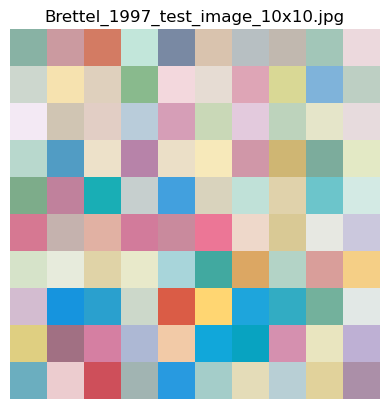

(10, 10, 3) (10, 10, 3) (3, 3)


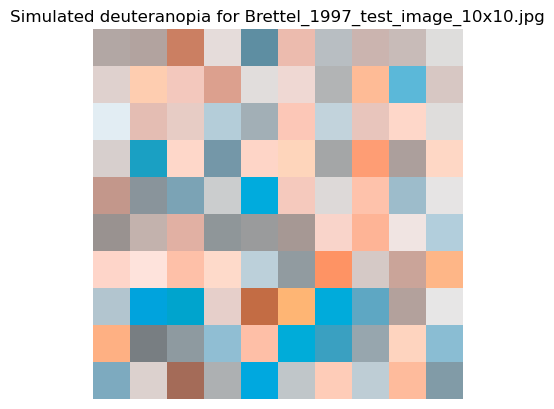

In [16]:
dantonize_Brettel_1997("deuteranopia", "./image_inputs/Brettel_1997_test_image_10x10.jpg", vischeck = False)

As an initial impression, it looks that the green squares have a reduced green channel values in the simulated image. Let's do the rest of the analysis to see exactly how the image changed. Compared to the Brettel result, it looks way too orange.

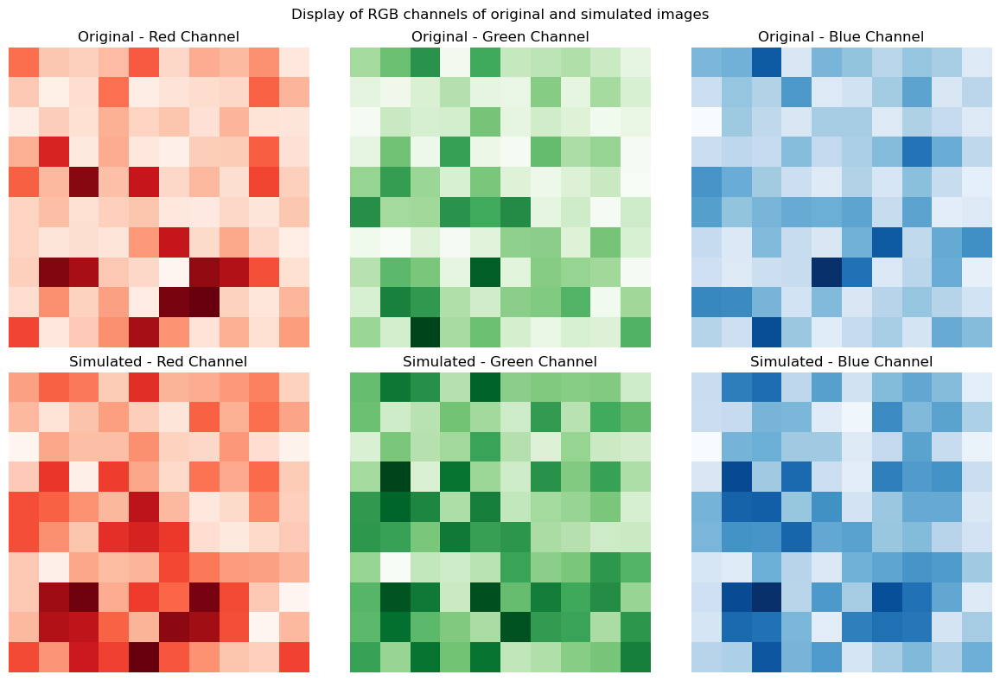

In [17]:
visualize_RGB_channels("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_False_Brettel_1997_test_image_10x10.jpg")

Indeed we can see a reduction in the green channel values (overall more darker squares), and what seems a reduction in the red channel values. Looking closer at the red channel, it seems that some squares have increased in red value (nearly white in the simulation picture). The blue channel values look like they have slightly reduced, too. Let's see by how much.

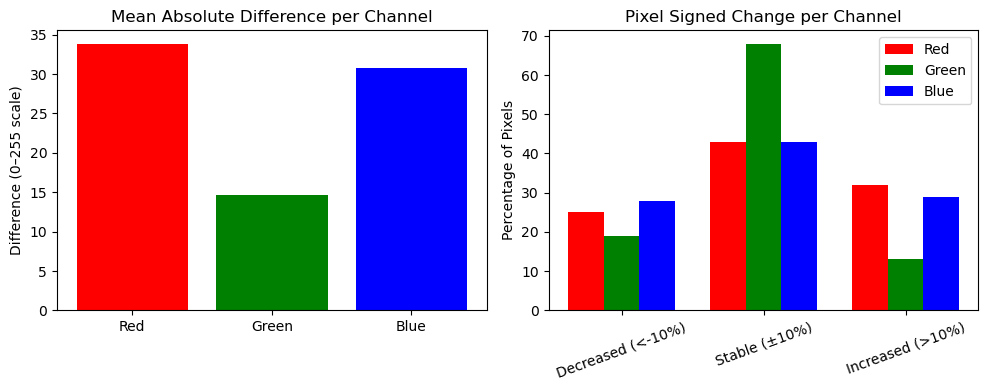

In [18]:
plot_mean_absolute_difference_and_signed_differences("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_False_Brettel_1997_test_image_10x10.jpg")

We see that the mean absolute difference in the red and blue channels is even more than the one in the green channel. 

Let's have a look of the signed changes. 

* Most of the pixels have retained a stable green value. Here I have defined "stable" as $\pm 10\%$ of the original channel value. Nearly half of the pixels have stable blue and red values, too. 
* Around $20\%$ of pixels have a decrease in green value.
* Only $10\%$ of pixels have experienced in increase in green value.

Let's now look at the heatmaps of these signed changes.

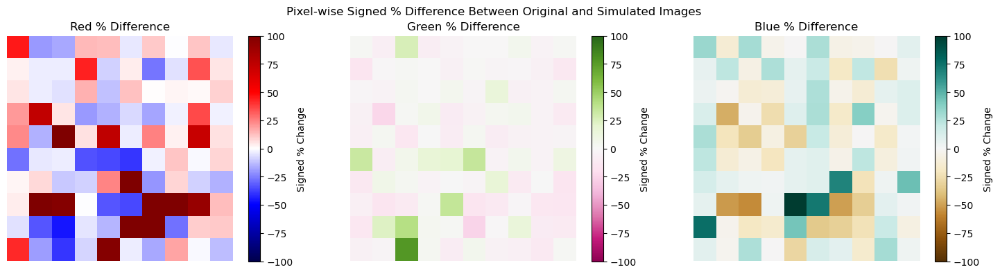

In [19]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_False_Brettel_1997_test_image_10x10.jpg")

We see the exact squares and their value changes.

As confirmed by the pixel signed value change per channel, most red pixels retain their value in the $\pm 10\%$ bound. Around $\frac{1}{5}$th increase their value, and $30\%$ decrease in value. From the second chart, we confirm that most squares retain their green channel values. Finally, for the blue channel around half of squares retain their blue channel values, while roughly an equal amount of the rest have an increased and respectively, decreased values.

Let's finally look at the histograms per channel.

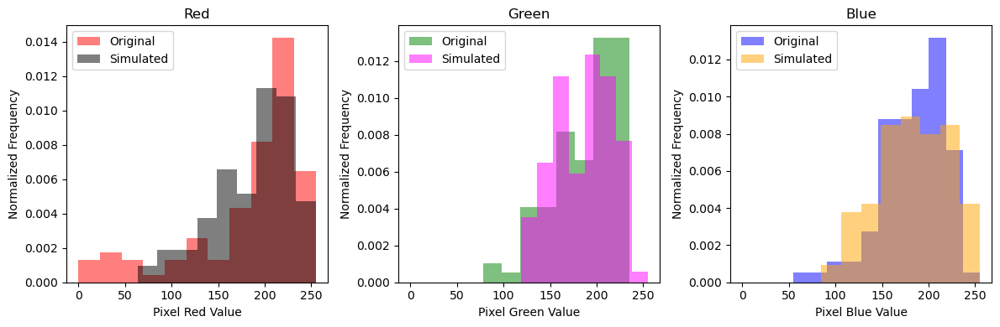

In [20]:
plot_histograms("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_False_Brettel_1997_test_image_10x10.jpg", bins="auto")

We see that there are less high value pixels in the simulated image for the green channel. The spread of the pixel distribution also seems to have narrowed for the simulated image for all three channels. Overall, we still see some high green values, and a bit less of lower green values. 

##### 3.4.1.1. ```vischeck = True```

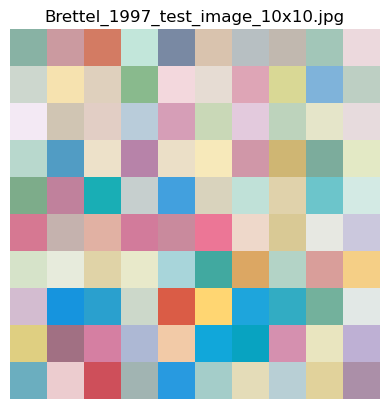

(10, 10, 3) (10, 10, 3) (3, 3)


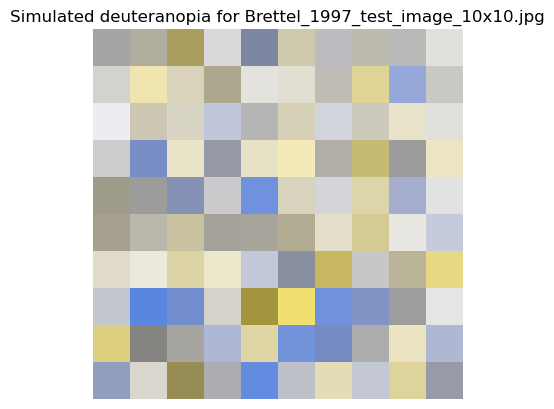

In [21]:
dantonize_Brettel_1997("deuteranopia", "./image_inputs/Brettel_1997_test_image_10x10.jpg", vischeck = True)

As an initial impression, this looks less orange than the ```vischeck=False``` variant. Let's check the visualization of the RGB channels.

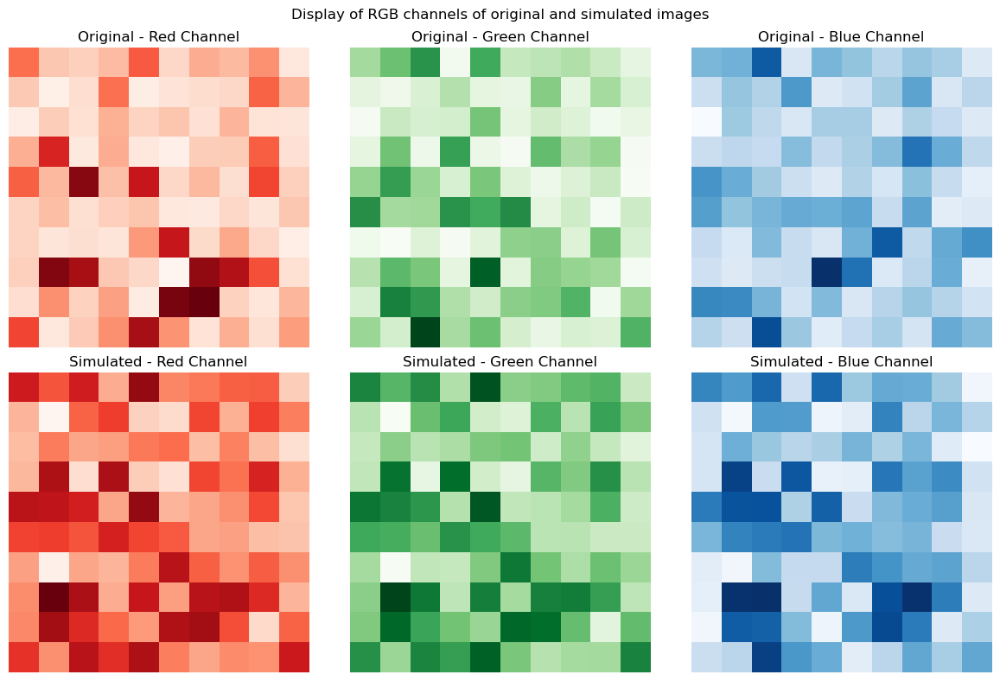

In [22]:
visualize_RGB_channels("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_True_Brettel_1997_test_image_10x10.jpg")

This looks very similar to the previous result - there are a lot of changes in red and blue values - both increases and decreases, while green experiences an overall slight decrease.

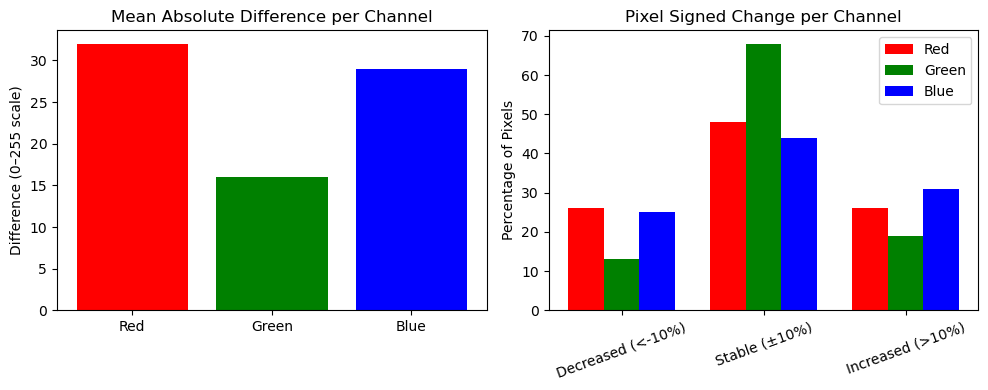

In [23]:
plot_mean_absolute_difference_and_signed_differences("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_True_Brettel_1997_test_image_10x10.jpg")

The pixel signed change per channel graph looks very similar to the previous result - most green pixels retain their values within the $10\%$ bound. Roughly a similar amount of red and blue pixels increase and decrease in value. Let's also confirm through the heatmap and the histogram:

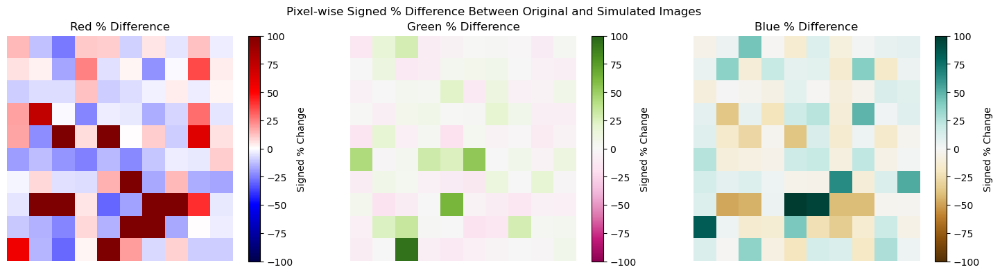

In [24]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_True_Brettel_1997_test_image_10x10.jpg")

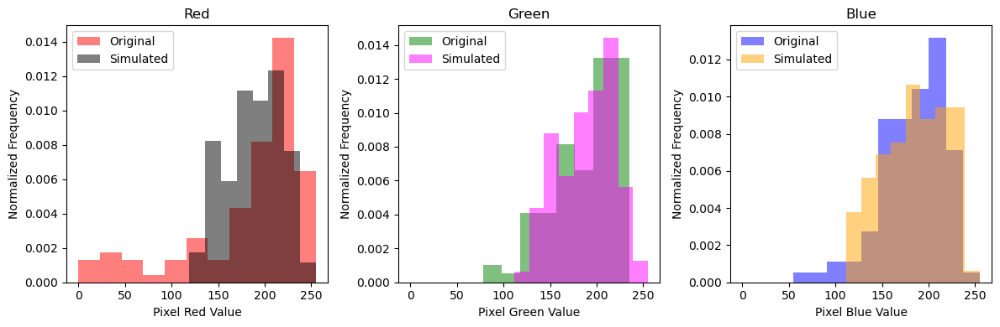

In [25]:
plot_histograms("./image_inputs/Brettel_1997_test_image_10x10.jpg", "./image_outputs/deuteranopia_True_Brettel_1997_test_image_10x10.jpg", bins="auto")

Verdict: Inconclusive. The ```vischeck=True``` result resembles the original Brettel result for deuteranopia a lot more than ```vischeck=False```. However, looking at the rest of the graphs and diagrams, the two results are very comparable and similar in achievement of deuteranopia.

Let's now discuss some of the Ishihara plates and how well the simulated image shows the expected result. We will only present the heatmaps for the numbered plates to visualize where the changes are happening in the pictures.

#### 3.4.2. Result and discussion for Ishihara plate 6 

Let's check how protanopia looks like for Ishihara plate $6$ and whether we still the $5$ on it. As this is a colour vision test, I will spend less time on the channels gain/loss discussions.

##### 3.4.2.1. ```vischeck = False```

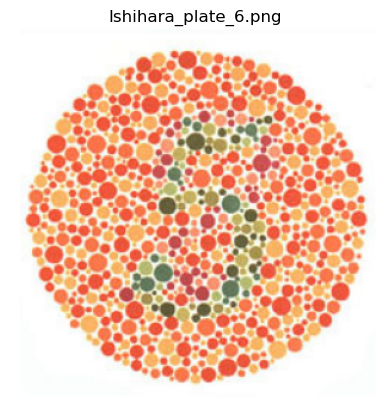

(302, 303, 3) (302, 303, 3) (3, 3)


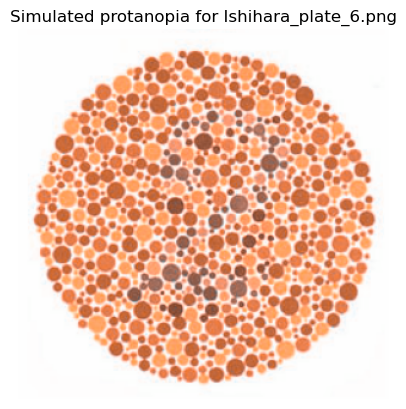

In [26]:
dantonize_Brettel_1997("protanopia", "./image_inputs/Ishihara_plate_6.png", vischeck = False)

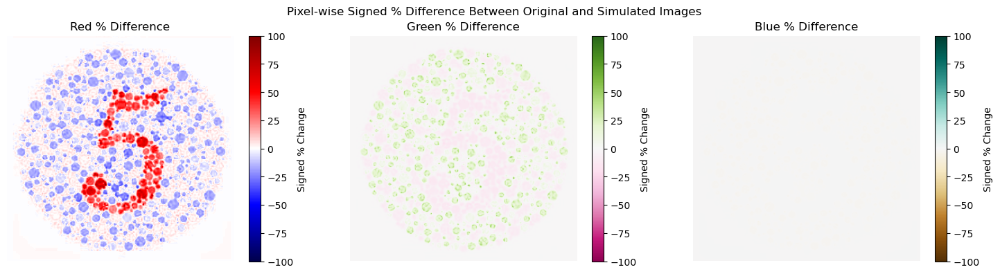

In [27]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Ishihara_plate_6.png", "./image_outputs/protanopia_False_Ishihara_plate_6.png")

We see the increase in red channel value exactly where the five is, and a decrease in red channel value around the number. There is the opposite effect for the green channel value, and no change in the blue channel values. The CVD simulated plate indeed now shows a number that resembles a two. The five is no longer visible.

##### 3.4.2.1. ```vischeck = True```

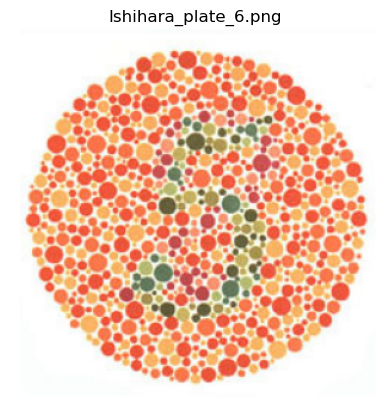

(302, 303, 3) (302, 303, 3) (3, 3)


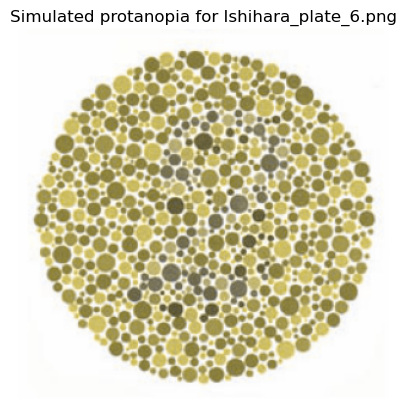

In [28]:
dantonize_Brettel_1997("protanopia", "./image_inputs/Ishihara_plate_6.png", vischeck = True)

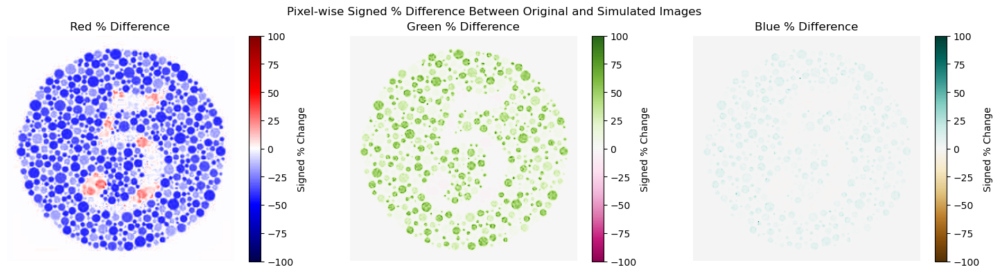

In [29]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Ishihara_plate_6.png", "./image_outputs/protanopia_True_Ishihara_plate_6.png")

The result here is very similar, but the increase in red channel value where the five lies is far less. The decrease in red value around the five and the increase in green value at the same place are far more noticeable. There is a slight increase of blue channel value around the five.

Overall, the result is satisfactory - the number five has disappeared completely, and a number resembling a two is visible. The plate is less red than the ```vischeck=False``` result, which is likely more correct, as with protanopia, the strong red values should decrease by a lot, and less of an increase in red values should be observed. 

Thus, although both results seem satisfactory to me, I think ```vischeck=True``` performed slightly better.

#### 3.4.3. Result and discussion for Ishihara plate 10

Let's also test the protanopia case for plate number $10$ and discuss the results briefly.

##### 3.4.3.1. ```vischeck = False```

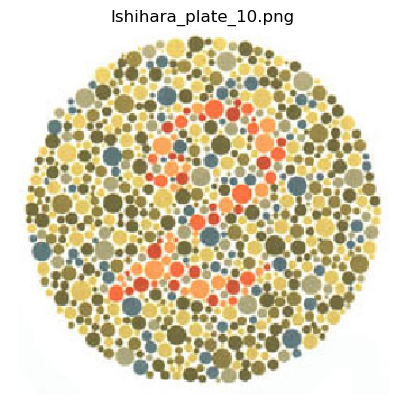

(330, 344, 3) (330, 344, 3) (3, 3)


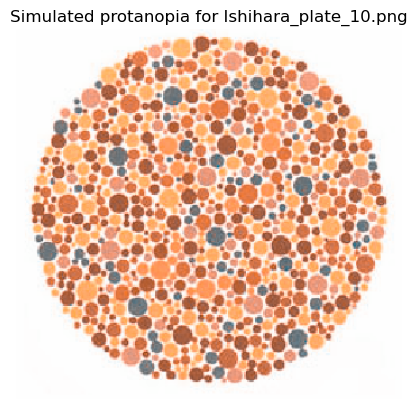

In [30]:
dantonize_Brettel_1997("protanopia", "./image_inputs/Ishihara_plate_10.png", vischeck = False)

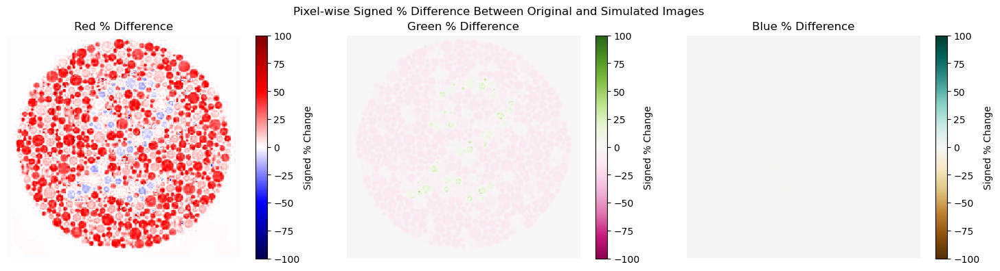

In [31]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Ishihara_plate_10.png", "./image_outputs/protanopia_False_Ishihara_plate_10.png")

##### 3.4.3.1. ```vischeck = True```

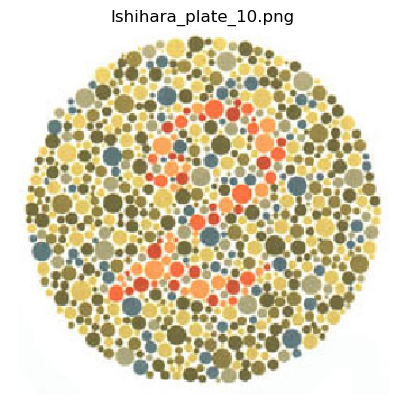

(330, 344, 3) (330, 344, 3) (3, 3)


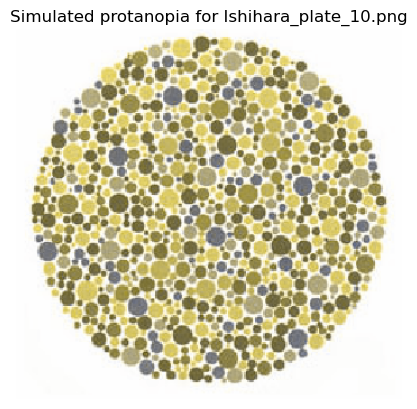

In [32]:
dantonize_Brettel_1997("protanopia", "./image_inputs/Ishihara_plate_10.png", vischeck = True)

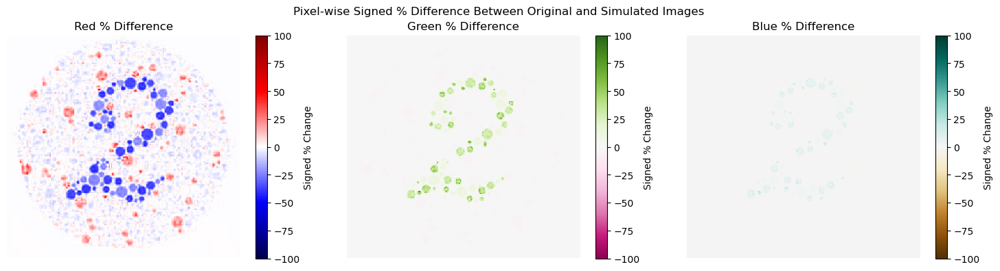

In [33]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Ishihara_plate_10.png", "./image_outputs/protanopia_True_Ishihara_plate_10.png")

The ```vischeck=False``` method shows a very large increase in red values around the number. Again, this is a bit counterintuitive for protanopia, as we expect that red will overall decrease. Therefore, with a similar argument as for plate number $6$, I award a point to ```vischeck=False``` for corectness. I find the decrease in red and increase in green where the number two is is strong, and expected. The increase in red around the number is still present but for far less of the pixels. There is even a slight overall decrease in red channel value around the number. This is in line with expectations. 

#### 3.4.4. Result and discussion for Ishihara plate 23

A quick overview of deuteranopia for plate number $23$. Expectation - the four will be visible to the deuteranope, but the two will disappear.

##### 3.4.4.1. ```vischeck = False```

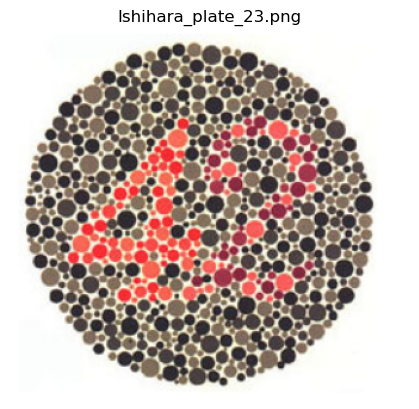

(300, 324, 3) (300, 324, 3) (3, 3)


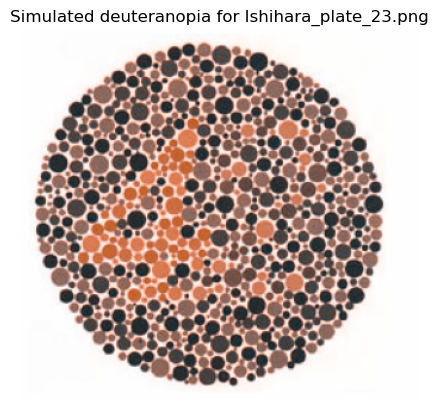

In [34]:
dantonize_Brettel_1997("deuteranopia", "./image_inputs/Ishihara_plate_23.png", vischeck = False)

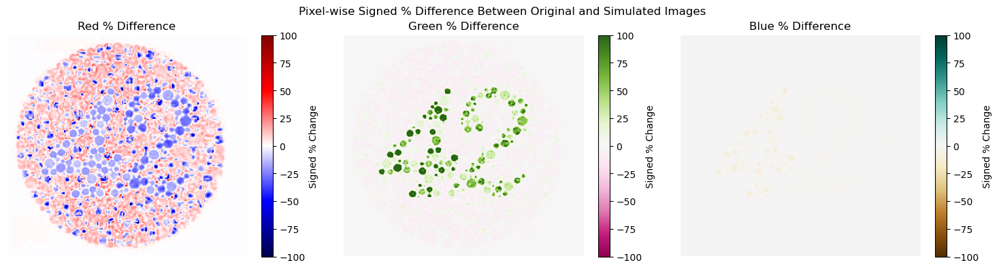

In [35]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Ishihara_plate_23.png", "./image_outputs/deuteranopia_False_Ishihara_plate_23.png")

##### 3.4.4.2. ```vischeck = True```

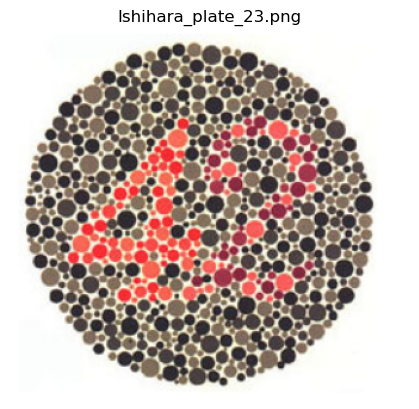

(300, 324, 3) (300, 324, 3) (3, 3)


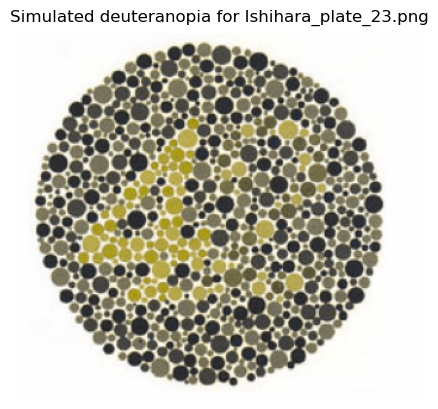

In [36]:
dantonize_Brettel_1997("deuteranopia", "./image_inputs/Ishihara_plate_23.png", vischeck = True)

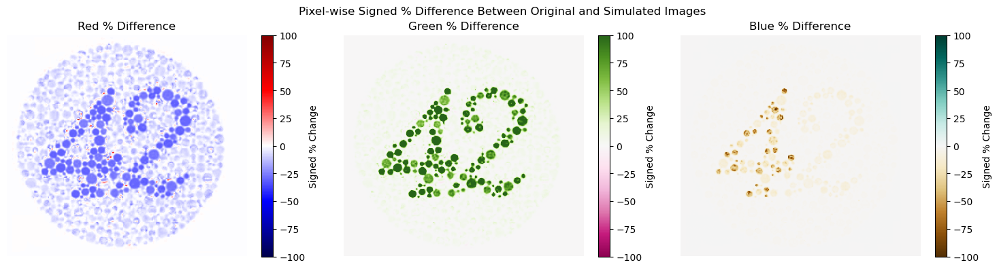

In [37]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Ishihara_plate_23.png", "./image_outputs/deuteranopia_True_Ishihara_plate_23.png")

Here both of the results show a visible four and a covered two. Strangely, ```vischeck=False``` again shows a very strong increase in red channel value around the numbers, while for ```vischeck=True``` there is an overall decrease. There is a noticeable difference in both methods for the green channel values - while ```vischeck=False``` shows a slight decrease in value around the numbers, the ```vischeck=True``` presents a slight increase instead. The number four has also noticeably decreased in blue channel value in the ```vischeck=True``` method.

This actually got me slightly confused, as to be far, I am not sure which one performs better. I would have expected a more noticeable decrease in green channel value, but then again the original image doesn't seem very green to begin with. I would expect that the blue channel changes are noticeable in the deuteranopia case, as the blue colour is close to the green (in terms of wavelength), so should be affected by green-colour blindness (the same way green channel values are affected for protanopia). So, maybe ```vischeck=True``` performs slightly better.

#### 3.4.5. Result and discussion for custom Reddit plates

Finally, let's see how our methods perform for the tritanopia customer plates.

##### 3.4.5.1. ```vischeck = False```

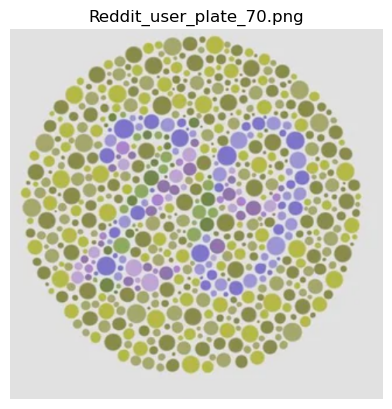

(477, 481, 3) (477, 481, 3) (3, 3)


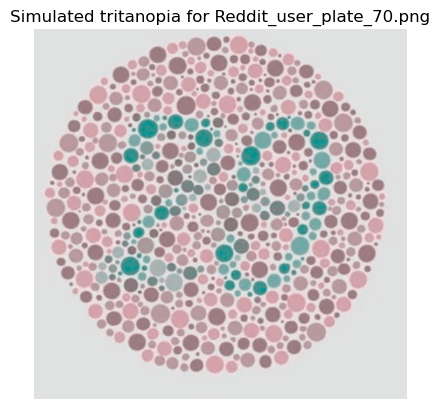

In [38]:
dantonize_Brettel_1997("tritanopia", "./image_inputs/Reddit_user_plate_70.png", vischeck = False)

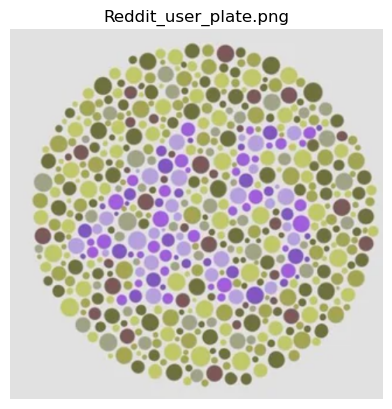

(477, 481, 3) (477, 481, 3) (3, 3)


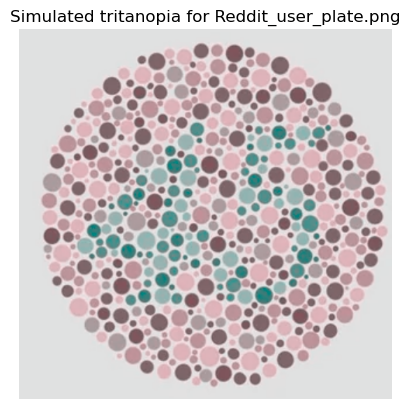

In [39]:
dantonize_Brettel_1997("tritanopia", "./image_inputs/Reddit_user_plate.png", vischeck = False)

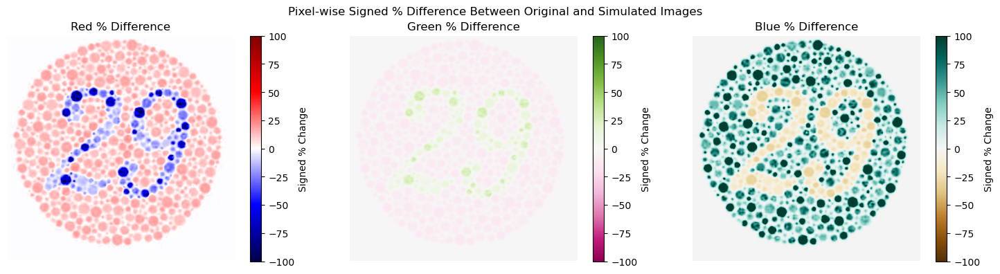

In [40]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Reddit_user_plate_70.png", "./image_outputs/tritanopia_False_Reddit_user_plate_70.png")

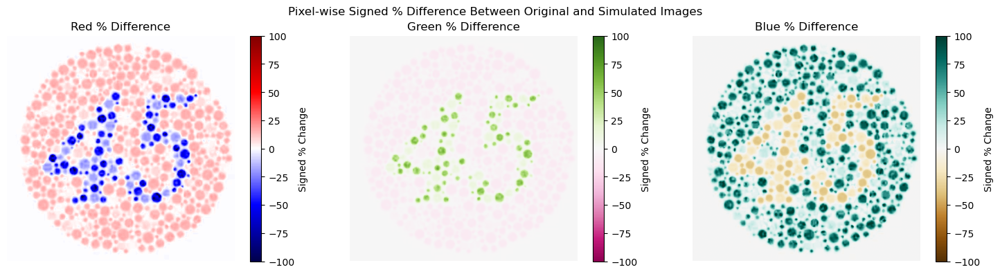

In [41]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Reddit_user_plate.png", "./image_outputs/tritanopia_False_Reddit_user_plate.png")

This is actually very unsatisfactory.

For the first plate, the number is indeed less visible, but does not resemble $70$ at all. 

In the second case, the $45$ has not disappeared.

##### 3.4.5.2. ```vischeck = True```

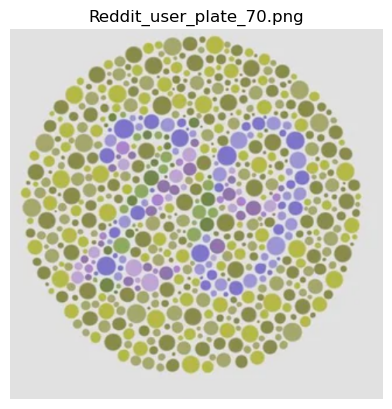

(477, 481, 3) (477, 481, 3) (3, 3)


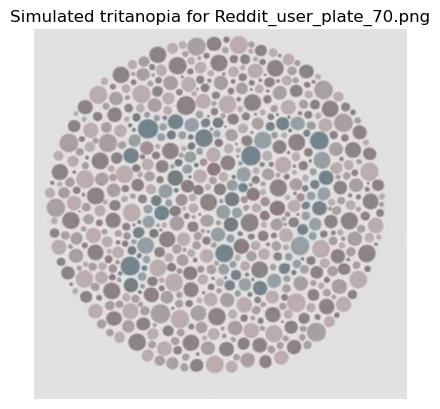

In [42]:
dantonize_Brettel_1997("tritanopia", "./image_inputs/Reddit_user_plate_70.png", vischeck = True)

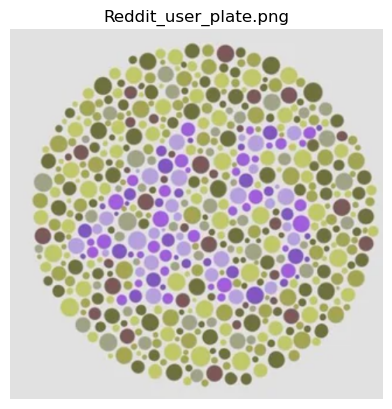

(477, 481, 3) (477, 481, 3) (3, 3)


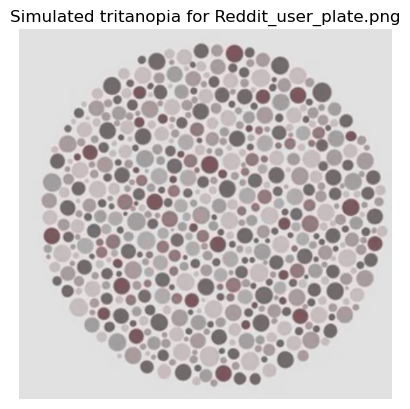

In [43]:
dantonize_Brettel_1997("tritanopia", "./image_inputs/Reddit_user_plate.png", vischeck = True)

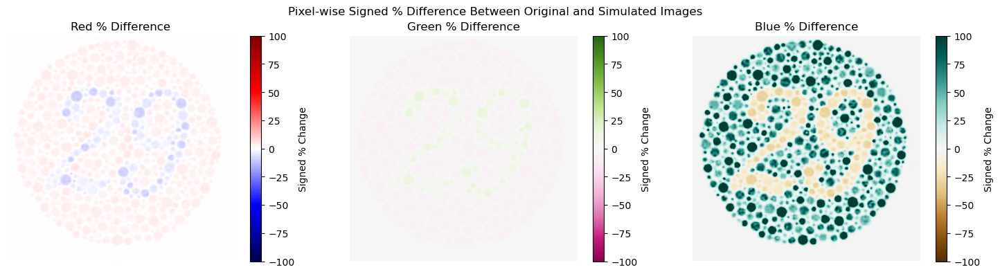

In [44]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Reddit_user_plate_70.png", "./image_outputs/tritanopia_True_Reddit_user_plate_70.png")

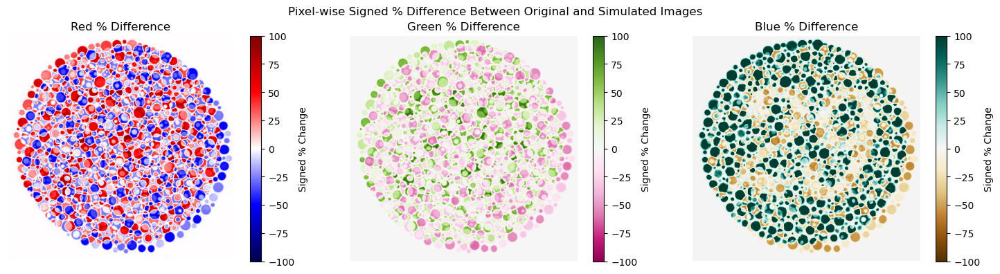

In [45]:
plot_signed_percentage_difference_heatmaps("./image_inputs/Reddit_user_plate_70.png", "./image_outputs/tritanopia_True_Reddit_user_plate.png")

The desired results are achieved here - we see $70$ in the first case and no number in the second. Could this be considered a success? I am not sure. Notice that the heatmaps look very strange compared to the traditional Ishihara plate tests. The pixels look to be carefully selected so that the desired result is achieved, but this is only true for the ```vischeck=True``` method, and completely fails with ```vischeck=False```. Why could that be?

##### 3.4.5.3. Discussion of results for the custom plates

It should be noted that these plates are not officially verified and not accepted as a colour vision medical test anywhere. We are not certain how they were developed, and as ```vischeck=True``` made it as a GIMP filter, it could be speculated that the person who developed the custom tritanopia plates, used that filter as a tool and reference point. This is probably why we see such a major difference between the ```vischeck=False``` and ```vischeck=True``` results for those plates, while we find that the ```vischeck=False``` performs well enough in the previous Ishihara plate protanopia/deuteranopia simulations.

Overall verdict: Completely uncertain (but still it was very entertaining to see). Likely the correct conclusion here would be that these plates are not a trustworthy source of CVD test for tritanopia.

#### 3.4.6. Final verdict ```vischeck=False``` vs ```vischeck=True```

Based on the performance on the Brettel et al (1997) test image, and the CVD plates, I have decided to proceed with using the **Vischeck** anchor points and transformation matrices. Thus, 3.4.7. and further chapters will be using the ```dantonize_Brettel_1997``` function with ```vischeck = True```.

Why are the Vischeck anchor points in LMS coordinates different than mine? Going back to the equations for $L$, $M$ and $S$ of a colour stimulus, there is an integral over the spectral distribution $\phi(\lambda)$ multiplied by the weight. What I use is simply the bar values, i.e. the weight. The reason behind that is the fact that it fell outside the scope of my knowledge of how a spectroradiometer is used to measure $\phi(\lambda)$, and I could not find a source to provide me with "easy and ready to use" results. 

I am actually very surprised that the anchor points seem to be close to the Vischeck values, namely we check the difference between the $L$, $M$ and $S$ values to get a list of differences for each of the anchorpoints. The results for the last $660\text{nm}$ anchorpoint are incredibly close.

In [46]:
[round(LMS_475_Brettel_i - LMS_475_Vischeck_i,2) for LMS_475_Brettel_i, LMS_475_Vischeck_i in zip(LMS_475_Brettel, LMS_475_Vischeck)]

[-0.08, -0.15, -0.54]

In [47]:
[round(LMS_485_Brettel_i - LMS_485_Vischeck_i,2) for LMS_485_Brettel_i, LMS_485_Vischeck_i in zip(LMS_485_Brettel, LMS_485_Vischeck)]

[-0.12, -0.22, -0.34]

In [48]:
[round(LMS_575_Brettel_i - LMS_575_Vischeck_i,2) for LMS_575_Brettel_i, LMS_575_Vischeck_i in zip(LMS_575_Brettel, LMS_575_Vischeck)]

[-0.96, -0.72, -0.0]

In [49]:
[round(LMS_660_Brettel_i - LMS_660_Vischeck_i,2) for LMS_660_Brettel_i, LMS_660_Vischeck_i in zip(LMS_660_Brettel, LMS_660_Vischeck)]

[-0.09, -0.01, 0.0]

The other (more major) difference between the ```vischeck=False``` and ```vischeck=True``` comes from the RGB to LMS transformation matrix, where the one from the Brettel et al (1997) paper seems to be tailored to a specific CRT monitor, while the Vischeck one, I assume has been measured and subsequently, adjusted to work for a much wider range of monitors. Nevertheless, I want to note that the ```vischeck=False``` results (apart from the tritanopia case) are very satisfactory.

I will continue with the assumption that the ```vischeck=True``` implementation produces correct simulation results for the three types of colour blindness. 

I will move on to a short discussion of other images that I have generated with Chat GPT (so that I would not end up violating a creator's rights). They are not photorealistic enough, but will suffice in demonstrating the three types of colour blindness outside of Ishihara tests. 

#### 3.4.7. Result and discussion for other images

##### 3.4.7.1. A single red flower

I have generated an image that will have a single red detail in the foreground with a predominantly green background setting. I will be interested how the flower detail loses it's colour for protanopes.

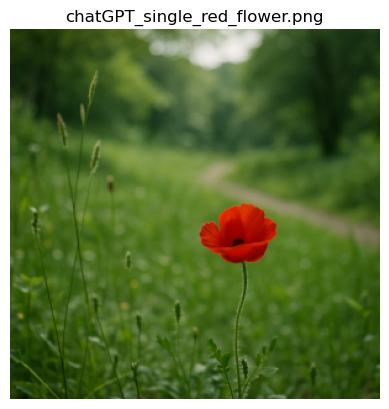

(300, 300, 3) (300, 300, 3) (3, 3)


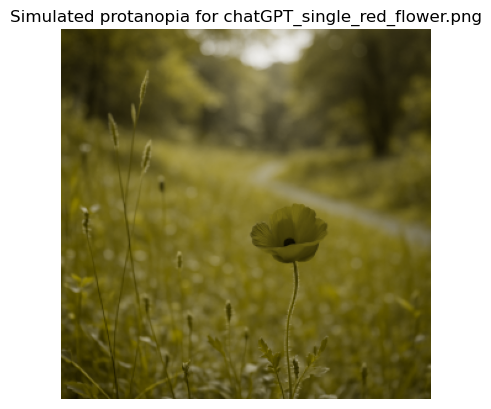

In [50]:
dantonize_Brettel_1997("protanopia", "./image_inputs/chatGPT_single_red_flower.png", vischeck = True)

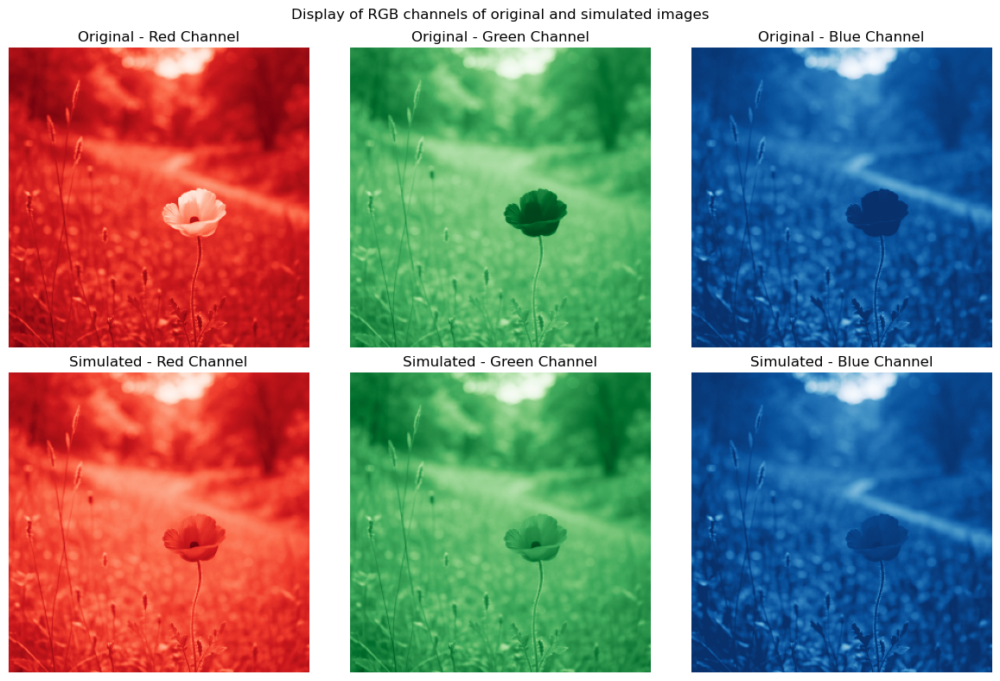

In [51]:
visualize_RGB_channels("./image_inputs/chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_chatGPT_single_red_flower.png")

We indeed see how the flower lost in red channel value. It also gained a bit of green channel value. This confirms our previous Ishihara test results for protanopia that protanopia leads to a loss in red channel value and a gain in green channel value for objects that are originally red. 

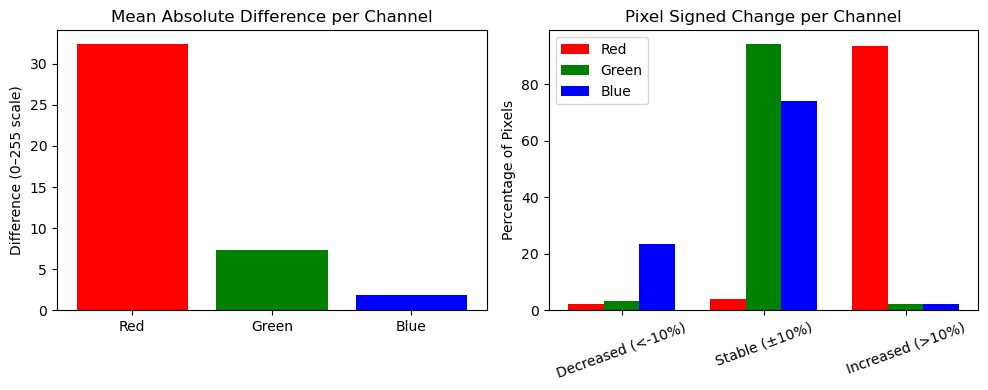

In [52]:
plot_mean_absolute_difference_and_signed_differences("./image_inputs/chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_chatGPT_single_red_flower.png")

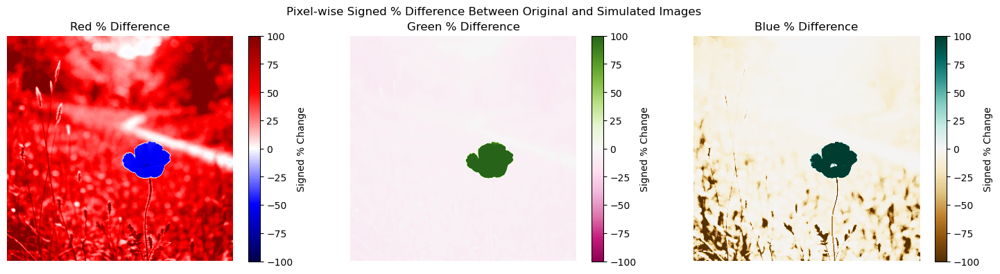

In [53]:
plot_signed_percentage_difference_heatmaps("./image_inputs/chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_chatGPT_single_red_flower.png")

Due to the increase in red channel value for the whole background, it turns out that most pixels have a red channel value gain. This confirms another result we have noticed for protanopia - that objects originally green will gain in red channel value. As the flower is the only red object, it is the only place where green channel values experience a large shift, while most pixels retain stable green. There is also a slight increase in blue channel value for the flower, with a decrease in blue for the background.

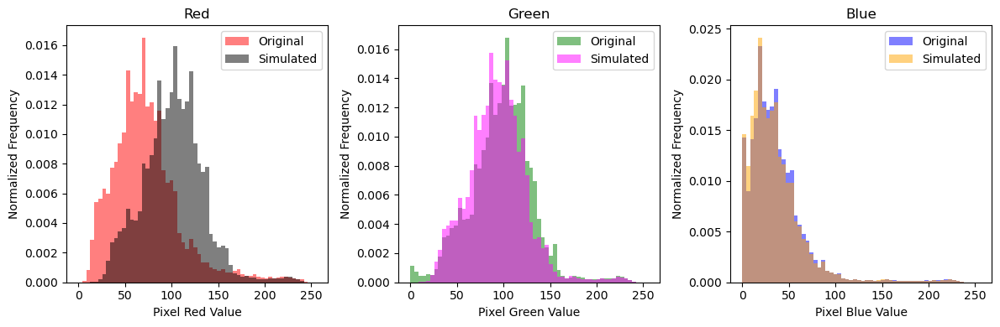

In [54]:
plot_histograms("./image_inputs/chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_chatGPT_single_red_flower.png", bins=60)

Due to the large green background segment, the histogram of the red channel shifts right, so we see an overall increase in large red channel values. Green stays almost the same, maybe experiecing a slight shift to the left. 

##### 3.4.7.2. Find the correct coloured ball

I have generated an image with one green, one red and one blue ball. I will simulate all three types of colour blindness to see how a colour blind person may confuse the balls. This may be especially frustrating to e.g. a colour blind child told to "go pick the red ball". Let's see how this looks.

* protanopia: expectation - the red and the green ball will look very similar

Why is that? We saw on the previous image with the red flower that there was a gain in red where the original had green. Where the original had red, there was a loss of red and a gain of green. Let's see if this is confirmed.

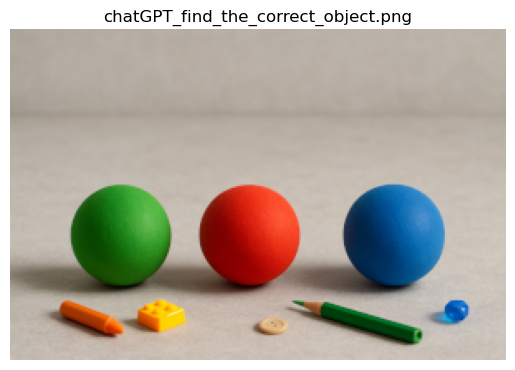

(200, 300, 3) (200, 300, 3) (3, 3)


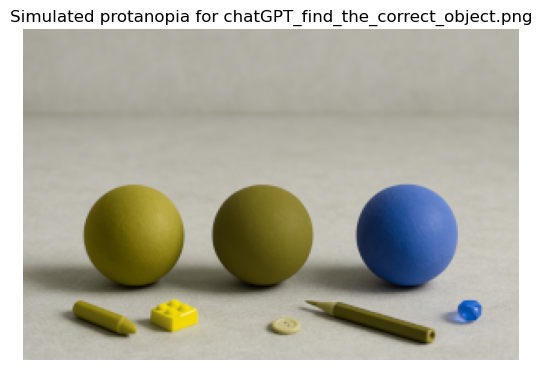

In [55]:
dantonize_Brettel_1997("protanopia", "./image_inputs/chatGPT_find_the_correct_object.png", vischeck = True)

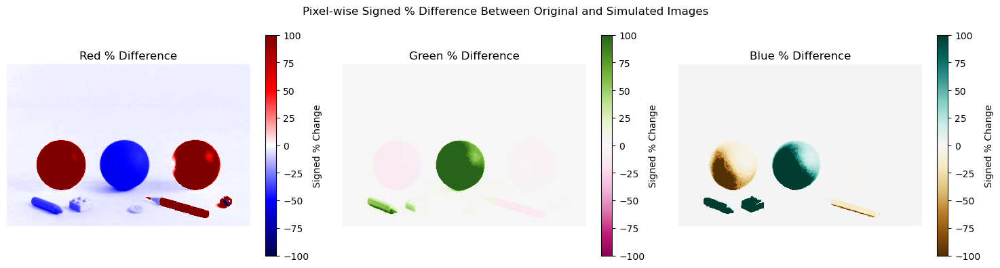

In [56]:
plot_signed_percentage_difference_heatmaps("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/protanopia_True_chatGPT_find_the_correct_object.png")

So, indeed - the red ball lost a lot of red and gained a lot of green. The green one gained a lot of red and lost a tiny bit of green. They now look fairly identical.

* deuteranopia: expectation - the blue and the red ball will look very similar

Expected are very similar colour losses and gains as for protanopia.

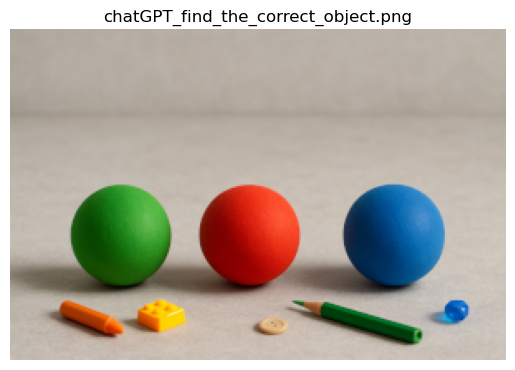

(200, 300, 3) (200, 300, 3) (3, 3)


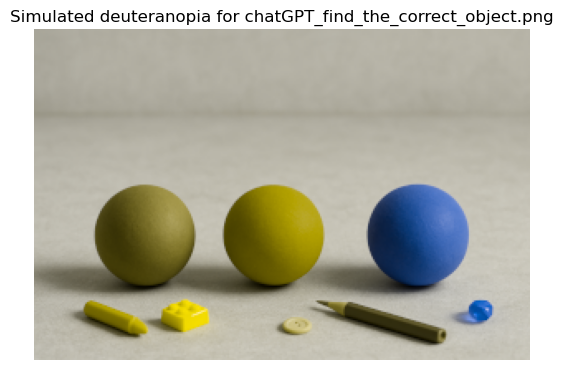

In [57]:
dantonize_Brettel_1997("deuteranopia", "./image_inputs/chatGPT_find_the_correct_object.png", vischeck = True)

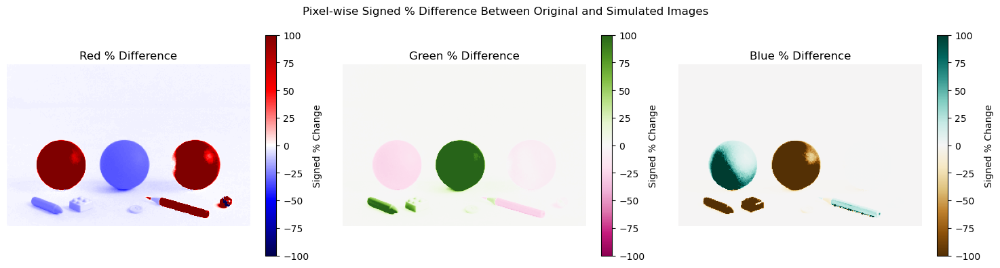

In [58]:
plot_signed_percentage_difference_heatmaps("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/deuteranopia_True_chatGPT_find_the_correct_object.png")

Confirmed! The red ball gained in green and lost in red. The green ball lost a bit of green and gained in red. Now they look very similar. The green ball gained some blue, while in the protanopia case it lost a bit of blue. Nevertheless, I personally see the protanopia and the deuteranopia simulated images as almost identical colour wise.

* tritanopia: expectation - the blue and the green ball will look very similar.

Why is that? As green is closest to blue in wavelength, it is likely that both will end up a confusingly similar colour for a tritanope.

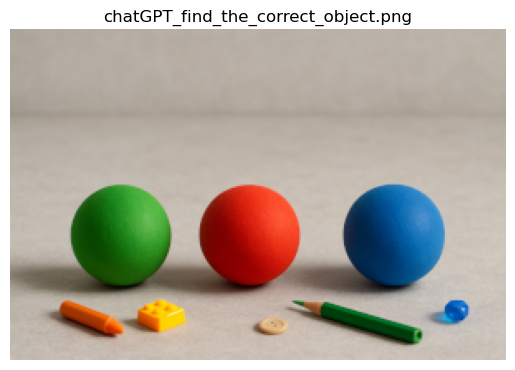

(200, 300, 3) (200, 300, 3) (3, 3)


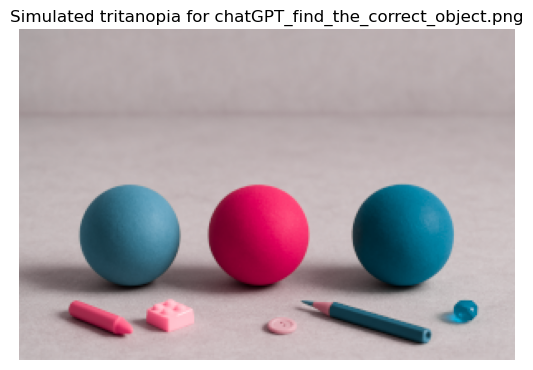

In [59]:
dantonize_Brettel_1997("tritanopia", "./image_inputs/chatGPT_find_the_correct_object.png", vischeck = True)

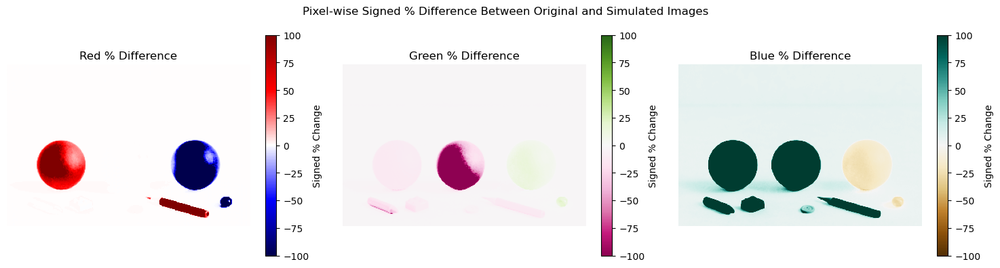

In [60]:
plot_signed_percentage_difference_heatmaps("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/tritanopia_True_chatGPT_find_the_correct_object.png")

My speculation turned out to be correct. The green ball gained a lot of red, while the blue ball lost a lot of red. The green ball gained a lot of blue, while the blue one lost in blue channel value. They are still differentiable, but ended up a similar shade of blue.

Let's now turn our attention to the following problem - how could we possibly uncover a lost detail in colour blindness simulation? We aim to uncover the following: Ishihara plate numbers, identify the red flower, and be able to accurately select the correct colour ball. 

For this purpose we will use k-means clustering analysis ran on a single channel (the one that we simulate blindness for).

## 4. Using k-means clustering analysis to uncover Ishihara plate numbers/patterns and identify lost objects in the CVD simulation

### 4.1. What is clustering?

Clustering is a method to group similar data points into a cluster, so that data points in one cluster are more similar to each other than to points in another cluster. In our case, we will define the similarity of data points in terms of colour, and try to form clusters of similar colours, using k-means clustering. 

### 4.2. What is k-means clustering? 

k-means clustering is a **centroid-based** clustering model, where clusters are represented by a central vector (which is itself not necessarily a member of the data set). The k-means clustering method finds $k$ cluster centers and assigns data points to each cluster. Distances of the data points from all cluster centers (**centrods**) are calculated, and a point is assigned to the cluster, where the distance to its centroid is minimal. As k-means clustering organizes data into clusters for an unlabeled and uncategorized dataset, it falls under unsupervised learning models. For such models, we do not have a training dataset with data already classified and labelled, that the model will analyse in advance. Rather, we provide our model with a dataset and require from it to find patterns and similarities, and thus, group the points. 

<figure>
  <img src="./pictures_and_graphs/k-means_clustering.png" alt="k-means clustering" style="width:30%">
  <figcaption><b>Fig 9.</b> k-means clustering visualization: k centroids are found for an unlabelled dataset and points are clustered around them.
       <br> Source: https://www.geeksforgeeks.org/k-means-clustering-introduction/  </figcaption>
</figure>

### 4.3. More on k-means clustering and chosen implementation. 

#### 4.3.1. Distance metric and colour space

We will use Euclidean distance to determine how far is a data point from a centroid. In 3D space, the Euclidean distance between points $A$ with coordinates $(x_A; y_A; z_A)$ and $B$ with coordinates $(x_B; y_B; z_B)$ could be represented as: 

$$ d = \sqrt{(x_B-x_A)^2 + (y_B-y_A)^2 + (z_B-z_A)^2} = \sqrt{(\Delta x)^2 + (\Delta y)^2 + (\Delta z)^2} $$

If we now take $Q_{c}$ a centroid of a colour cluster and $Q_{1}$ - a colour in a RGB colour space, then we would have $Q_{c} (R_{Q_{c}}; G_{Q_{c}}; B_{Q_{c}})$ and $Q_{1} (R_{Q_{1}}; G_{Q_{1}}; B_{Q_{1}})$ with Euclidean distance between them of:

$$ d = \sqrt{(R_{Q_{1}}-R_{Q_{c}})^2 + (G_{Q_{1}}-G_{Q_{c}})^2 + (B_{Q_{1}}-B_{Q_{c}})^2} = \sqrt{(\Delta R)^2 + (\Delta G)^2 + (\Delta B)^2} $$

We will not consider reducing the dimensions of our colour space without experiencing a loss of information. Through a dimension reduction, we will simplify the Euclidean distance measure a little to ease computation: consider now a 2D space for points $A$ with coordinates $(x_A; y_A;)$ and $B$ with coordinates $(x_B; y_B;)$, so the Euclidean distance between them will be: 

$$ d = \sqrt{(x_B-x_A)^2 + (y_B-y_A)^2} = \sqrt{(\Delta x)^2 + (\Delta y)^2} $$ 

Let's now take our $Q_{c}$ a centroid of a colour cluster and $Q_{1}$ - a colour in the ab-space, a reduced space from CIE LAB colour space. We will decide to ignore the $L$ component for the scope of this project, as $a$ and $b$ already preserve all colour information that RGB contains. So, we would have $Q_{c} (a_{Q_{c}}; b_{Q_{c}};)$ and $Q_{1} (a_{Q_{1}}; b_{Q_{1}}; )$ with Euclidean distance between them of:

$$ d = \sqrt{(a_{Q_{1}}-a_{Q_{c}})^2 + (b_{Q_{1}}-b_{Q_{c}})^2} = \sqrt{(\Delta a)^2 + (\Delta b)^2} $$ 

Here we should note that Euclidean distance is also considered as an Euclidean norm, i.e. $d(a,b) = \| a-b\|$ . 

#### 4.3.2. Initialization of centroids and clusters

We will use a random initialization of the centroids, by assigning them to a random selection of $k$ data points from the dataset. This has the drawback of the initial centroids being not well positioned and not well spaced to capture all the differences in the data points (we will discuss this later in more detail). So, this so called "naive k-means algorithm" will look as follows: 

**Step 1.** Assign $k$ centroids $m_{1}, m_{2} \dots m_{k}$ for the $k$ clusters.

**Step 2.** Assign each data point (in our case - colour in ab-space) to the nearest cluster, determined by the least squared Euclidean distance to the cluster's mean.

$$ S_{i} = \{ x_{p}: \|x_{p}-m_{i}\|^{2} \leq \|x_{p}-m_{j}\|^{2}, \forall j, 1 \leq j \leq k \} $$

**Step 3.** Recalculate the centroids, by taking the new cluster centroid to be the mean of the assigned points to that cluster.

$$ m_{i} = \frac{1}{\lvert S_{i}\rvert} \sum_{x_{j}\in S_{j}} x_{j} $$

Repeat Step 2. and Step 3. for $t$ iterations, where iteration number has been predefined.


<span style="color:blue">***</span>

![Explanation](./pictures_and_graphs/excl_mark.png)

Why have we chosen to minimize the squared distance instead? Firstly, we note that if distance $d_{1}$ is greater than distance $d_{2}$, then this also holds for the squares: $d_{1}^2>d_{2}^2$, so using squared values will not change the result. Secondly, having a square root in our calculations is tedious, so considering the squares, we essentially remove the square root without a change in the final result: 

$$ \|x-y\|^2 = \left( \left( \sum_{i=1}^{d} x_{i}-y_{i} \right)^{ \frac{1}{2} } \right)^2 = \sum_{i=1}^{d} x_{i}-y_{i} $$ 


In the code part of this chapter, I will proceed to use the non-squared Euclidean distance, as suggested by https://www.geeksforgeeks.org/calculate-the-euclidean-distance-using-numpy/ who advise using the numpy norm function. For the subsequent mathematical discussion, I will, however, focus on the squared distance, as it is also the one mostly present in the sources online.

<span style="color:blue">***</span>

But how are we confident that the centroids will update in a meaninful way? 

#### 4.3.3. Convergence of k-means

We will have reached **convergence**, when for iterations $t$ and $t+1$, the calculated centroids in Step 3. will be the same. It means no more updating of centroids and cluster assignments could be achieved. However, how are we confident that the above proposed algorithm will ever converge?

We can reformulate convergence: the sum of minimal Euclidean distances for points from their cluster centroids at iteration $i$ is bigger or equal than the one at iteration $i+1$. This would mean that recalculating centroids by taking means of points assigned to the cluster, we would find new centroids, for which the sum of minimal Euclidean distances is now smaller than the previous iteration. We would reach equality when we reach convergence - the sum of minimal Euclidean distances will stay the same, and no more updating that optimizes on Euclidean distances can be done. 

Let's begin by the following observation (Lemma): 

Consider points $z_{1}, z_{2}, \dots , z_{n}, n \geq 1$, such that $z_{i} \in \mathbb{R}^d$ ($d$-dimensional space), $i=1,\dots,n$. Let the mean of these points be $\bar{z} = \frac{1}{m}\sum_{i=1}^{n} z_{i}$ , and take an arbitrary point in the same space $z \in \mathbb{R}^d$ . Then, we see that 

$$ \begin{align}
\sum_{i=1}^{n} \| z_{i} -z \|^2 &=  \sum_{i=1}^{n} \| (z_{i} - \bar{z}) + (\bar{z}-z) \|^2 = \\ 
& = \sum_{i=1}^{n} \| z_{i} - \bar{z} \|^2 + \| \bar{z} -z \|^2 +2(z_{i}-\bar{z})(\bar{z}-z)) =\\
& =  \sum_{i=1}^{n} \| z_{i} - \bar{z} \|^2 + \sum_{i=1}^{n} \| \bar{z} -z \|^2 + 2\sum_{i=1}^{n} (z_{i}\bar{z} - \bar{z}\bar{z} - z_{i}z + \bar{z}z) = \\ 
& = \sum_{i=1}^{n} \| z_{i} - \bar{z} \|^2 + n \| \bar{z} -z \|^2 + 2\sum_{i=1}^{n} z_{i}(\bar{z}-z) - 2n\bar{z}(\bar{z}-z) = \\ 
& = \sum_{i=1}^{n} \| z_{i} - \bar{z} \|^2 +  n \| \bar{z} -z \|^2 + 2n\bar{z}(\bar{z}-z) - 2n\bar{z}(\bar{z}-z) = \\ 
& = \sum_{i=1}^{n} \| z_{i} - \bar{z} \|^2 +  n \| \bar{z} -z \|^2  \\ 
& \geq \sum_{i=1}^{n} \| z_{i} - \bar{z} \|^2 
\end{align} $$

Then, we denote the centroids at iteration $t$ and $t+1$ as $m^{t}$ and $m^{t+1}$ respectively, and cluster $k^\prime$ at iterations $t$ and $t+1$ as  $S_{k^\prime}^{t}$ and $S_{k^\prime}^{t+1}$ for $k^\prime=1,\dots,k$ . The elements in a cluster are denoted the same way as set cardinality: $\lvert S_{k^\prime} \rvert$. Then, the sum of squared Euclidean distances at iteration $t+1$ for the $n$ points in a single cluster is:

$$ \sum_{i=1}^{n} \| x_{i} - m^{t+1} \|^2 $$

, and for $k$ clusters this is: 

$$ \sum_{k^\prime = 1}^{k} \sum_{i=1}^{\lvert S_{k^\prime}^{t+1}\rvert}  \| x_{i} - m_{S_{k^\prime}^{t+1}}^{t+1} \|^2  $$

, which by the above Lemma is necessarily less or equal than the squared Euclidean distances of the previous iteration $t$, so: 

$$ \sum_{k^\prime = 1}^{k} \sum_{i=1}^{\lvert S_{k^\prime}^{t+1}\rvert}  \| x_{i} - m_{S_{k^\prime}^{t+1}}^{t+1} \|^2 \leq \sum_{k^\prime = 1}^{k} \sum_{i=1}^{\lvert S_{k^\prime}^{t}\rvert}  \| x_{i} - m_{S_{k^\prime}^{t}}^{t} \|^2$$ 


Which means that the k-means clustering will eventually converge. 

**TODO: fix vector notation with arrows**

https://www.cse.iitb.ac.in/~swaprava/courses/cs217/references/kmeans-convergence.pdf 

https://en.wikipedia.org/wiki/Euclidean_distance 

https://www.kdnuggets.com/2020/06/centroid-initialization-k-means-clustering.html 

https://www.toptal.com/machine-learning/clustering-algorithms 

https://medium.com/data-science/the-math-behind-the-curse-of-dimensionality-cf8780307d74  (??) 

https://hal.science/hal-03594986/file/3_publication%20No3.pdf - discussion of alternative distance metrics 

https://www.geeksforgeeks.org/k-means-clustering-introduction/ 

https://www.techtarget.com/searchenterpriseai/definition/clustering-in-machine-learning 

https://www.geeksforgeeks.org/data-mining-cluster-analysis/ 

https://www.mathworks.com/discovery/clustering.html - alternative clustering options 



k-means clustering: 

What are clusters of points? Why does real-world data tend to clusterize?
What is clustering analysis? (Optional: What is unsupervised learning?)
Provide examples of clustering analysis in 2D
How are clusters defined?
What is k-means clustering? Why does it converge?


(Use a custom metric. For example, this might be a function defined manually) 

In which cases is a custom metric applicable?


https://medium.com/data-science/image-color-segmentation-by-k-means-clustering-algorithm-5792e563f26e 

https://hpsuresh12345.medium.com/cluster-analysis-6757d6c6acc9 

apply k-means clustering to identify image colour clusters on original image and compare colours on simulated images between the clusters. clusters with too similar colours - enhance the one with less pixels by adding blue for r-g CVD and red for tritanopia until the colour you get is not present in the simulated image. clusters as masks on top.

0.001040583* WxH <- significant "object" contour

https://medium.com/@juanc.olamendy/back-to-basics-mastering-k-means-clustering-with-numpy-ae7e6f1cb9a3 - k-means clusters implementation

use https://medium.com/data-science/image-color-segmentation-by-k-means-clustering-algorithm-5792e563f26e to find colour clusters of images?

find 5-10 clusters of colours of simulated image
find centers' RGB values
see if points in cluster belong to more than one cluster of original image
if no, pass
if yes, colour adjust the points that belong to another cluster of original image by adding blue for R-G colour blindness and R for tritanopia

https://medium.com/data-science/k-means-without-libraries-python-feb3572e2eef - k-means clustering with no libraries (THIS ONE!!!)

https://medium.com/analytics-vidhya/color-separation-in-an-image-using-kmeans-clustering-using-python-f994fa398454 - show colors of clusters

https://stackoverflow.com/questions/1401712/how-can-the-euclidean-distance-be-calculated-with-numpy - Euclidean distance np norm

1. find significant object contours

### 4.4. Implementation

Let's now code in the above algorithm, and apply it to the original image channel, where colour vision is reduced - red for protanopia, green for deuteranopia and blue for tritanopia.

We will restrict the clusters to $k=2$. For the a-channel, there will be one cluster for the red or green objects, and one for the rest. For the b-channel, one cluster will contain either all blue or all yellow objects, and the other - the rest. 

This will be sufficient to identify the lost object, which will belong to one of the two clusters, and tint that cluster. This will provide a difference in colour for the "lost" object or Ishihara number. Therefore, when comparing the simulated image from the Brettel algorithm with the tinted image, we would have a visual clue which object was of the colour we are colour blind for. 

Assumptions: 

* that Brettel et al (1997) provides an accurate simulation for CVD

Method: 
* convert the original image in LAB space and apply k-means clustering to either the a or the b channels, to ensure that the "lost" object is contained in one of the two clusters
* tint one of these clusters on the CVD simulated image
* the tint will increase the non-CVD channel values, and decrease the CVD one, hoping that the CVD individual would be able to see these changes
* if possible, refine the k-means clustering to ensure better image results, and that only the "lost" objects are tinted
* re-daltonize tinted image to visualize how it is seen by the CVD individual
* analyse if perceptual difference has been achieved, and "lost" objects are now distinguishable

I will also compare the Euclidean distance between the pixels of the tinted cluster and the same cluster on the original image. As a perceptual difference, I have decided to use the value $2,3$. (Chasing Delta-E, Light Illusion website). We will also check out of curiosity if the chroma contrast has changed.


#### 4.4.1. Summary of functions

| Function                      | Summary                                                      | Purpose                                                               |
|------------------------------|--------------------------------------------------------------|------------------------------------------------------------------------|
|```initialize_centroids```| Randomly selects k initial cluster centers from data         | Provides starting points for the k-means clustering algorithm          |
|```recalc_points_clusters```| Assigns each data point to the closest centroid              | Forms clusters based on proximity to centroids (using 1D absolute diff)|
|```recalc_centroids```| Updates each centroid to the mean of its assigned points     | Refines centroids after each iteration of clustering                   |
|```k_means_color_clustering```| Runs k-means on LAB a or b channel based on CVD type         | Segments image by color dimension most affected by color blindness     |
|```tint_cluster_by_cvd_type```| Tints a specific cluster depending on CVD type       | Making desired regions/objects stand out         |
|```visualize_clusters_on_image```| Shows original image and its color-clustered representation  | Helps visually inspect cluster segmentation on the image               |
|```plot_delta_e_on_tinted_cluster```| Plot the Euclidean distance measure calculated between the new tinted cluster and the original cluster on the CVD image| Show the preceptional difference achieved.|
|```visualize_and_tint_cvd_clusters```| Main function to run all the above functions and produce a final image with tinted cluster| Identify and tint "lost" object. Show analysis of result compared to original CVD simulation|
|```analyze_correction_effectiveness```|Computes Delta E and contrast difference between simulated and corrected images. Displays a Delta E heatmap between the original and corrected simulation|Evaluates the visual impact of correction via perceptual color distance and contrast|
|```analyze_chroma_contrast```|Computes and plots chroma ($\sqrt{a^2 + b^2}$) histograms for both images|Measures and visualizes perceptual color contrast (saturation/vividness)|

#### 4.4.2. Code

In [61]:
def initialize_centroids(data: np.ndarray, k: int) -> np.ndarray:
    """
    Randomly select k initial centroids from the input data.

    Args:
        data (np.ndarray): The input data of shape (N, 1) or (N, 2), typically LAB a or b channel.
        k (int): Number of clusters to form.

    Returns:
        np.ndarray: Initial centroid positions of shape (k, 1) or (k, 2).
    """
    
    rng = np.random.default_rng()
    random_points = rng.choice(data, k, replace=False)
    
    return random_points

In [62]:
def recalc_points_clusters(data: np.ndarray, centroids: np.ndarray) -> tuple[dict[int, np.ndarray], np.ndarray]:
    """
    Assign each data point to the nearest centroid using 1D absolute distance.

    Args:
        data (np.ndarray): Input data of shape (N, 1), usually a single LAB channel.
        centroids (np.ndarray): Current centroids of shape (k, 1).

    Returns:
        tuple:
            clusters (dict): Mapping of cluster index to data points.
            indices (np.ndarray): Array of cluster labels for each data point (N,).
    """
    
    # Distance matrix between each point and each centroid (broadcasted)
    distances = np.abs(data - centroids.T)  # (N, k)
    indices = np.argmin(distances, axis=1)  # Closest centroid for each point
    
    clusters = {i: data[indices == i] for i in range(centroids.shape[0])}
    
    return clusters, indices

In [63]:
def recalc_centroids(data: np.ndarray, indices: np.ndarray, k: int) -> np.ndarray:
    """
    Recalculate the centroid of each cluster as the mean of its data points.

    Args:
        data (np.ndarray): Input data (N, 1).
        indices (np.ndarray): Current cluster assignments (N,).
        k (int): Number of clusters.

    Returns:
        np.ndarray: Updated centroids (k, 1).
    """
    
    new_centroids = np.zeros((k, 1))

    for i in range(k):
        cluster_points = data[indices == i]
        if len(cluster_points) > 0:
            # Regular mean for non-empty clusters
            new_centroids[i] = np.mean(cluster_points)
        else:
            # If there is an empty cluster, assign farthest point from any existing centroid
            all_distances = np.abs(data - new_centroids.T)
            min_distances = np.min(all_distances, axis=1)
            farthest_point = data[np.argmax(min_distances)]
            new_centroids[i] = farthest_point

    return new_centroids

In [64]:
def k_means_color_clustering(image_path: str, k: int, iterations: int = 10, cvd_type=None) -> tuple[dict[int, list], np.ndarray, np.ndarray, np.ndarray, np.ndarray]:
    """
    Perform 1D k-means clustering on the 'a' or 'b' LAB channel of an image based on CVD type.

    Args:
        image_path (str): Path to the sRGB image file.
        k (int): Number of clusters to form.
        iterations (int): Number of k-means update steps.
        cvd_type (str): 'protanopia', 'deuteranopia', or 'tritanopia'. Determines which LAB channel to cluster.

    Returns:
        Tuple:
            clusters_RGB (dict): Mapping from cluster index to list of RGB pixels.
            srgb_img (np.ndarray): Original sRGB image.
            indices (np.ndarray): Cluster label for each pixel (flattened).
            cluster_mask (np.ndarray): Cluster label reshaped to image shape.
            centroids (np.ndarray): Final centroids (k, 1).
    """
    srgb_img = np.asarray(Image.open(image_path).convert("RGB"))
    lab_img = rgb2lab(srgb_img / 255.0)
    H, W, _ = lab_img.shape
    a = lab_img[:, :, 1]
    b = lab_img[:, :, 2]

    # Select channel based on color vision deficiency type
    mode = 'a' if cvd_type in ('protanopia', 'deuteranopia') else 'b'
    data = (a if mode == 'a' else b).ravel().reshape(-1, 1)

    centroids = initialize_centroids(data, k)

    for _ in range(iterations):
        cluster_dict, indices = recalc_points_clusters(data, centroids)
        centroids = recalc_centroids(data, indices, k)

    cluster_mask = indices.reshape(H, W)
    visualize_clusters_on_image(cluster_mask, srgb_img)

    rgb_flat = srgb_img.reshape(-1, 3)
    clusters_RGB = {i: rgb_flat[indices == i].tolist() for i in range(k)}

    return clusters_RGB, srgb_img, indices, cluster_mask, centroids

In [65]:
def visualize_clusters_on_image(cluster_mask: np.ndarray, original_img: np.ndarray):
    """
    Visualize the clustering result on the image using randomly assigned colors.

    Args:
        cluster_mask (np.ndarray): Cluster labels reshaped to image dimensions.
        original_img (np.ndarray): Original RGB image.

    Returns: 
        None
    """
    H, W = cluster_mask.shape
    color_map = np.array([[0, 0, 0], [255, 255, 0]], dtype=np.uint8)
    overlay = color_map[cluster_mask]
    overlay = overlay.reshape(H, W, 3)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(original_img)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 2, 2)
    plt.imshow(overlay)
    plt.title("Clustered Mask")
    plt.axis("off")
    plt.show() 

In [236]:
def tint_cluster_by_cvd_type(srgb_cvd: np.ndarray, cluster_mask: np.ndarray, cluster_to_tint: int, cvd_type: str) -> np.ndarray:
    """
    Apply different tinting strategies to a given cluster in the CVD-simulated image based on CVD type.

    Args:
        srgb_cvd (np.ndarray): Simulated RGB image (uint8).
        cluster_mask (np.ndarray): Cluster labels (HxW).
        cluster_to_tint (int): Which cluster to modify (usually 0 or 1).
        cvd_type (str): 'protanopia', 'deuteranopia', or 'tritanopia'.

    Returns:
        modified (np.ndarray): Tinted image.
    """
    assert cvd_type in ('protanopia', 'deuteranopia', 'tritanopia'), "Invalid CVD type"

    modified = srgb_cvd.copy().astype(np.int16)  # prevent overflow. np.int8 max number is 255, and may be temporarily exceed with correction before np.clip
    mask = cluster_mask == cluster_to_tint

    if cvd_type == 'protanopia':
        modified[mask, 0] = np.clip(modified[mask, 0] - 90, 0, 255)  # red ↓
        modified[mask, 1] = np.clip(modified[mask, 1] + 20, 0, 255)  # green ↑
        modified[mask, 2] = np.clip(modified[mask, 2] + 70, 0, 255)  # blue ↑
        cvd_type_title = "red"

    elif cvd_type == 'deuteranopia':
        modified[mask, 1] = np.clip(modified[mask, 1] - 90, 0, 255)  # green ↓
        modified[mask, 0] = np.clip(modified[mask, 0] + 20, 0, 255)  # red ↑
        modified[mask, 2] = np.clip(modified[mask, 2] + 70, 0, 255)  # blue ↑
        cvd_type_title = "green"

    elif cvd_type == 'tritanopia':
        modified[mask, 2] = np.clip(modified[mask, 2] - 90, 0, 255)  # blue ↓
        modified[mask, 0] = np.clip(modified[mask, 0] + 70, 0, 255)  # red ↑
        modified[mask, 1] = np.clip(modified[mask, 1] + 20, 0, 255)  # green ↑
        cvd_type_title = "blue"

    modified = modified.astype(np.uint8)
    
    plt.imshow(modified)
    plt.title(f"{cvd_type.title()} Simulated Image with original image cluster with highest {cvd_type_title} value tinted")
    plt.axis("off")
    plt.show()

    plot_delta_e_on_tinted_cluster(srgb_cvd, modified, cluster_mask, cluster_to_tint)

    return modified

In [67]:
def visualize_and_tint_cvd_clusters(image_original_path: str, image_cvd_path: str, cvd_type: str, k: int = 2):
    """
    Cluster the original image and apply perceptual tint fix to the simulated image based on CVD type.
    The most red/green/blue centroid is chosen depending on the CVD.

    Args:
        image_original_path (str): Path to original image.
        image_cvd_path (str): Path to simulated CVD image.
        cvd_type (str): 'protanopia', 'deuteranopia', or 'tritanopia'.

    Returns:
        None
    """

    # Run k-means clustering and get RGB centroids
    clusters_rgb, srgb_orig, cluster_indices_flat, cluster_mask, centroids = k_means_color_clustering(
        image_original_path, k=k, iterations=6, cvd_type=cvd_type
    )

    # Open the simulated image
    srgb_cvd = np.asarray(Image.open(image_cvd_path).convert("RGB"))

    img_name = Path(image_cvd_path).name

    # # Choose which channel to maximize based on CVD type
    # channel_index = {'protanopia': 0, 'deuteranopia': 1, 'tritanopia': 2}[cvd_type]

    if cvd_type == 'protanopia':
        cluster_to_tint = int(np.argmax(centroids))  # max a (red direction)
    elif cvd_type == 'deuteranopia':
        cluster_to_tint = int(np.argmin(centroids))  # min a (green direction)
    elif cvd_type == 'tritanopia':
        cluster_to_tint = int(np.argmin(centroids))  # min b (blue direction)

    # Apply tint to that cluster in the simulated image
    srgb_cvd_tinted = tint_cluster_by_cvd_type(srgb_cvd, cluster_mask, cluster_to_tint=cluster_to_tint, cvd_type=cvd_type)

    plt.imsave(f"./image_outputs/k-means_{img_name}", srgb_cvd_tinted)

In [68]:
def plot_delta_e_on_tinted_cluster(simulated_rgb, corrected_rgb, cluster_mask, cluster_to_tint):
    """
    Plots histogram of Delta E (Euclidean in Lab) between simulated and corrected images,
    focusing only on the pixels belonging to the tinted cluster.

    Args:
        simulated_rgb (np.ndarray): Simulated RGB image (HxWx3, uint8).
        corrected_rgb (np.ndarray): Corrected RGB image (HxWx3, uint8).
        cluster_mask (np.ndarray): Cluster labels mask (HxW).
        cluster_to_tint (int): Cluster index that was tinted.

    Returns:
        None
    """

    # Mask for tinted cluster pixels
    mask = cluster_mask == cluster_to_tint

    # Convert RGB to Lab
    simulated_lab = rgb2lab(simulated_rgb / 255.0)
    corrected_lab = rgb2lab(corrected_rgb / 255.0)
    
    # Extract pixels in the tinted cluster
    sim_flat = simulated_lab[mask]
    corr_flat = corrected_lab[mask]

    # Compute Delta E (Euclidean distance)
    delta_e = np.linalg.norm(corr_flat - sim_flat, axis=1)

    # Plot histogram
    plt.figure(figsize=(8, 4))
    plt.hist(delta_e, bins=40, color='orange', alpha=0.7, label='ΔE on tinted cluster')
    plt.axvline(2.3, color='red', linestyle='--', label='Perceptual threshold (ΔE ≈ 2.3)')
    plt.xlabel('Delta E (Euclidean)')
    plt.ylabel('Pixel Count')
    plt.title(f'Delta E Distribution on Tinted Cluster (Cluster #{cluster_to_tint})')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [172]:
def analyze_correction_effectiveness(sim_orig_path:str, sim_corrected_path:str):
    """
    Analyzes the effectiveness of the Lee and Santos correction by:
    - Computing Delta E between simulated original and corrected images.
    - Comparing the contrast in the L channel.
    - Visualizing the Delta E distribution.

    Args:
        sim_orig_path (str): Path to the simulated original image.
        sim_corrected_path (str): Path to the simulated corrected image.

    Returns:
        None
    """

    # Load and normalize images
    sim_orig = np.asarray(Image.open(sim_orig_path).convert("RGB"), dtype=np.float32) / 255.0
    sim_corrected = np.asarray(Image.open(sim_corrected_path).convert("RGB"), dtype=np.float32) / 255.0

    # Convert to Lab color space
    lab_orig = rgb2lab(sim_orig)
    lab_corrected = rgb2lab(sim_corrected)

    # Compute Delta E (Euclidean distance)
    delta_e = np.linalg.norm(lab_orig - lab_corrected, axis=2)

    # Compute standard deviation of the L channel
    std_l_orig = np.std(lab_orig[..., 0])
    std_l_corrected = np.std(lab_corrected[..., 0])

    # Print contrast comparison
    print(f"L Channel Std Dev - Simulated Original:  {std_l_orig:.2f}")
    print(f"L Channel Std Dev - Simulated Corrected: {std_l_corrected:.2f}")
    if std_l_corrected > std_l_orig:
        print("✅ Contrast increased after correction.")
    else:
        print("⚠️ No contrast improvement.")

    # Plot Delta E histogram
    plt.figure(figsize=(8, 4))
    plt.hist(delta_e.ravel(), bins=50, color='purple', alpha=0.75)
    plt.axvline(2.3, color='red', linestyle='--', label='ΔE ≈ 2.3 perceptual threshold')
    plt.title('ΔE Between Simulated Original and Corrected Image')
    plt.xlabel('Delta E (Euclidean)')
    plt.ylabel('Pixel Count')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Plot Delta E change heatmap
    plt.figure(figsize=(6, 6))
    plt.imshow(delta_e, cmap='hot', vmin=-50, vmax=50)
    plt.colorbar(label='ΔE Change (after - before)')
    plt.title("ΔE Heatmap (Correction Effectiveness)")
    plt.axis('off')
    plt.show()

#### 4.4.3. A brief description of chroma

For analyzing the chroma contrast, it is necessary to define what chroma is in LAB-space. 

I will use the CHNSpec website as a reference.

Chroma $C=\sqrt{a^{*2} +b^{*2}}$ represents the saturation of colours. Let's recap that a highly negative $a^{*}$ would be a very saturated green, while a highly positive $a^{*}$ will be very saturated red. For $b^{*}$ a highly positive value indicates saturated yellow, while a highly negative one - saturated blue. The $0$ values for $a^{*}$ and $b^{*}$ would indicate a neutral colour, therefore when then tend to $0$, we lose on saturation. Let's briefly visualize how the colours will change for different $a^{*}$ and $b^{*}$ values. We will hold luminance $L^{*}=70$

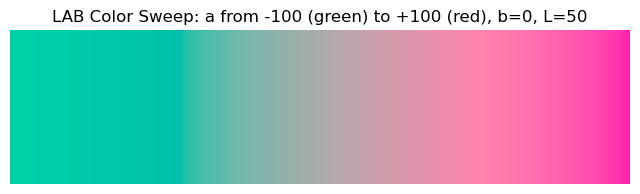

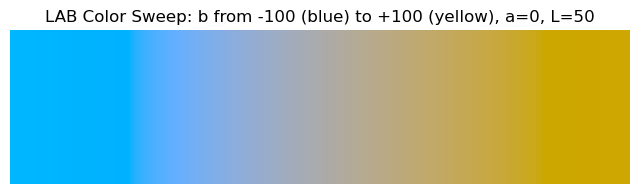

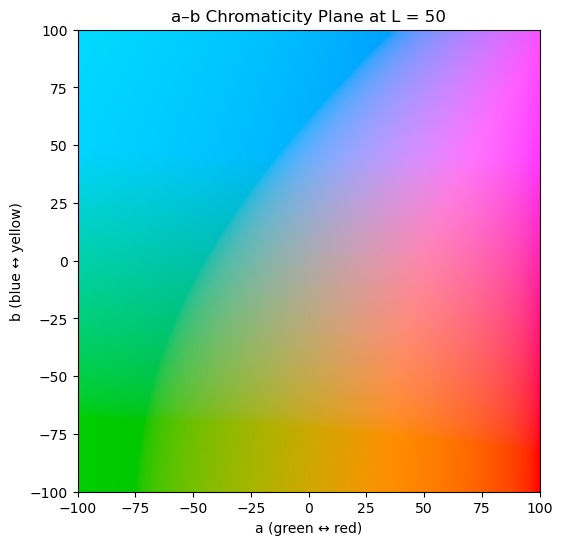

In [290]:
# Step size and range
a_values = np.linspace(-100, 100, 400)
b_values = np.linspace(-100, 100, 400)
L = 70  # Constant lightness

# --- 1. Varying a, with b = 0 ---
lab_colors_a = np.zeros((1, len(a_values), 3))
lab_colors_a[..., 0] = L
lab_colors_a[..., 1] = a_values
lab_colors_a[..., 2] = 0
rgb_colors_a = lab2rgb(lab_colors_a)

plt.figure(figsize=(8, 2))
plt.imshow(rgb_colors_a, aspect='auto')
plt.title("LAB Color Sweep: a from -100 (green) to +100 (red), b=0, L=50")
plt.axis('off')
plt.show()

# --- 2. Varying b, with a = 0 ---
lab_colors_b = np.zeros((1, len(b_values), 3))
lab_colors_b[..., 0] = L
lab_colors_b[..., 1] = 0
lab_colors_b[..., 2] = b_values
rgb_colors_b = lab2rgb(lab_colors_b)

plt.figure(figsize=(8, 2))
plt.imshow(rgb_colors_b, aspect='auto')
plt.title("LAB Color Sweep: b from -100 (blue) to +100 (yellow), a=0, L=50")
plt.axis('off')
plt.show()

# --- 3. 2D Grid of a and b ---
aa, bb = np.meshgrid(np.linspace(-100, 100, 400), np.linspace(-100, 100, 400))
lab_ab_grid = np.zeros((400, 400, 3))
lab_ab_grid[..., 0] = L
lab_ab_grid[..., 1] = aa
lab_ab_grid[..., 2] = bb
rgb_ab_grid = lab2rgb(lab_ab_grid)

plt.figure(figsize=(6, 6))
plt.imshow(rgb_ab_grid, extent=[-100, 100, -100, 100])
plt.title("a–b Chromaticity Plane at L = 50")
plt.xlabel("a (green ↔ red)")
plt.ylabel("b (blue ↔ yellow)")
plt.grid(False)
plt.show()

We see that the most desaturated region is around $a^{*}=0, b^{*}=0$ and is the colour gray. Therefore squaring the values of $a^{*}, b^{*}$ we get a positive number and avoid negative values. The farther this number is from $0$, the more saturation we have in the colour. By taking the square root of the sum of the two squared values, we get the following Chroma heatmap, showing how Chroma values vary with changing $a^{*}, b^{*}$

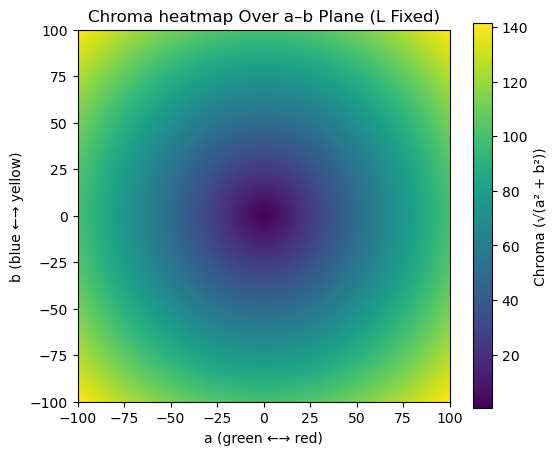

In [292]:
# Define range for a and b channels
a_vals = np.linspace(-100, 100, 400)
b_vals = np.linspace(-100, 100, 400)
a_grid, b_grid = np.meshgrid(a_vals, b_vals)

# Compute chroma
chroma = np.sqrt(a_grid**2 + b_grid**2)

# Plot
plt.figure(figsize=(6, 5))
chroma_plot = plt.imshow(chroma, extent=[-100, 100, -100, 100], origin='lower',
                         cmap='viridis', interpolation='nearest')
plt.colorbar(chroma_plot, label='Chroma (√(a² + b²))')
plt.title('Chroma heatmap Over a–b Plane (L Fixed)')
plt.xlabel('a (green ←→ red)')
plt.ylabel('b (blue ←→ yellow)')
plt.grid(False)
plt.show()

What are the actual colour values for Chroma? Let's see in the following picture. The center of the Chroma colour graph is a gray colour - showing that when both $a^{*}$ and $b^{*}$ tend to $0$, we achieve less vividness, and we get a neutral colour. 

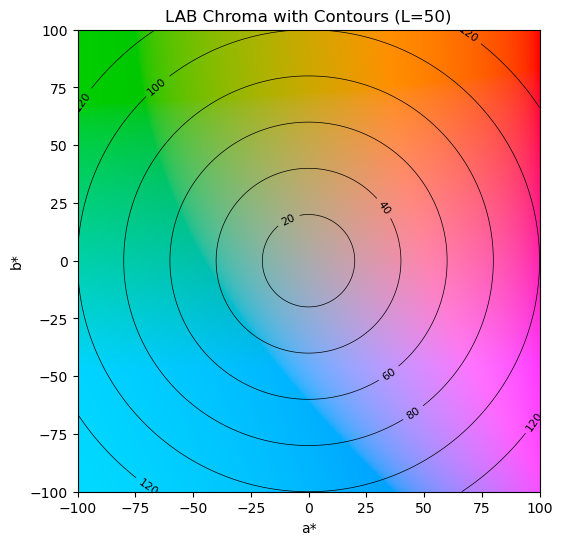

In [296]:
# Grid of a and b
a_vals = np.linspace(-100, 100, 400)
b_vals = np.linspace(-100, 100, 400)
A, B = np.meshgrid(a_vals, b_vals)

# Fixed L
L = 70
L_channel = np.full_like(A, L)

# Chroma calculation
chroma = np.sqrt(A**2 + B**2)

# Convert to RGB
lab = np.stack((L_channel, A, B), axis=-1)
rgb = lab2rgb(lab)

# Plot
fig, ax = plt.subplots(figsize=(6, 6))
ax.imshow(rgb, extent=[-100, 100, -100, 100], origin='lower')
contours = ax.contour(A, B, chroma, levels=[20, 40, 60, 80, 100, 120], colors='black', linewidths=0.5)
ax.clabel(contours, inline=True, fontsize=8, fmt="%.0f")
ax.set_title("LAB Chroma with Contours (L=50)")
ax.set_xlabel("a*")
ax.set_ylabel("b*")
plt.show()

So, the spread of the distribution of chroma contrast will show us how much more difference in colours we have added in the corrected picture. The shape will show us how saturated is the newly simulated picture as compared to the old one. A lot of values around $0$ would suggest low saturation.

In [163]:
def analyze_chroma_contrast(sim_orig_path:str, sim_corrected_path:str, cvd_type:str="protanopia"):
    """
    Compares chroma contrast between simulated original and corrected images.
    Chroma = sqrt(a^2 + b^2), representing perceptual colorfulness in Lab space.

    Args:
        sim_orig_path (str): Path to simulated original image.
        sim_corrected_path (str): Path to simulated corrected image.
        cvd_type (str): Type of CVD ('protanopia', 'deuteranopia', 'tritanopia').

    Returns:
        None
    """
    # Load and normalize images
    sim_orig = np.asarray(Image.open(sim_orig_path).convert("RGB"), dtype=np.float32) / 255.0
    sim_corrected = np.asarray(Image.open(sim_corrected_path).convert("RGB"), dtype=np.float32) / 255.0

    # Convert to Lab
    lab_orig = rgb2lab(sim_orig)
    lab_corr = rgb2lab(sim_corrected)

    # Compute chroma = sqrt(a^2 + b^2)
    chroma_orig = np.sqrt(lab_orig[..., 1]**2 + lab_orig[..., 2]**2)
    chroma_corr = np.sqrt(lab_corr[..., 1]**2 + lab_corr[..., 2]**2)

    # Compute std deviation for contrast
    std_orig = np.std(chroma_orig)
    std_corr = np.std(chroma_corr)

    print(f"Chroma Std Dev - Simulated Original:  {std_orig:.2f}")
    print(f"Chroma Std Dev - Simulated Corrected: {std_corr:.2f}")
    if std_corr > std_orig:
        print("✅ Chroma contrast increased after correction.")
    else:
        print("⚠️ No chroma contrast improvement.")

    # Plot overlaid histograms
    plt.figure(figsize=(10, 5))
    bins = np.linspace(0, np.max([chroma_orig.max(), chroma_corr.max()]), 50)
    plt.hist(chroma_orig.ravel(), bins=bins, alpha=0.5, label='Original Simulated', color='gray')
    plt.hist(chroma_corr.ravel(), bins=bins, alpha=0.5, label='Corrected Simulated', color='orange')
    plt.title(f'Chroma Contrast Comparison ({cvd_type})')
    plt.xlabel(r'Chroma $\sqrt{a^2 + b^2}$')
    plt.ylabel('Pixel Count')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

Okay, this should work but we have somewhat of a problem. Let's look at the case of uncovering the red ball from the picture. On Clustered mask we will see the two clusters coloured - one in black, and one in yellow. 

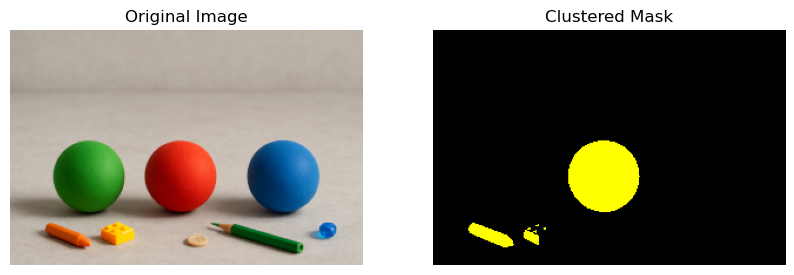

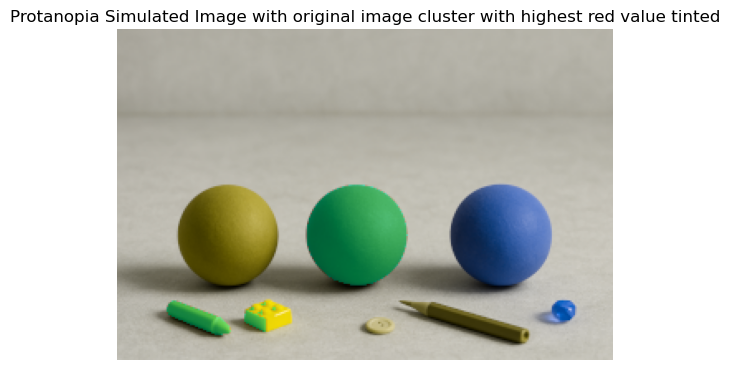

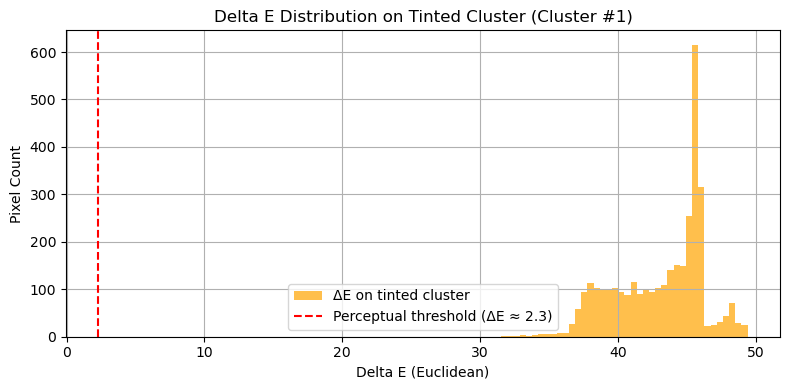

In [69]:
visualize_and_tint_cvd_clusters("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/protanopia_True_chatGPT_find_the_correct_object.png", k=2, cvd_type="protanopia")

Okay, so the image was successfully clustered into two clusters: one containing the red ball, and the other - the rest of the picture. Then, the red ball was coloured. So, knowing that we always colour the cluster from the original image that contains the most red, we are confident that it is indeed the red ball coloured.

However, the other option is that the *green* ball is seperated into its own cluster and the other cluster will contain the rest of the image. As we run the centroid initialization randomly on the a-channel, then we cannot be certain which way our clustering would turn.

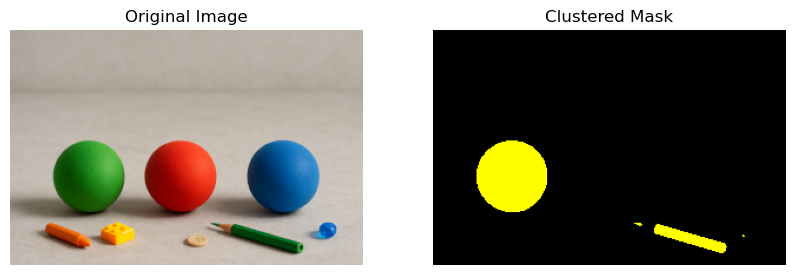

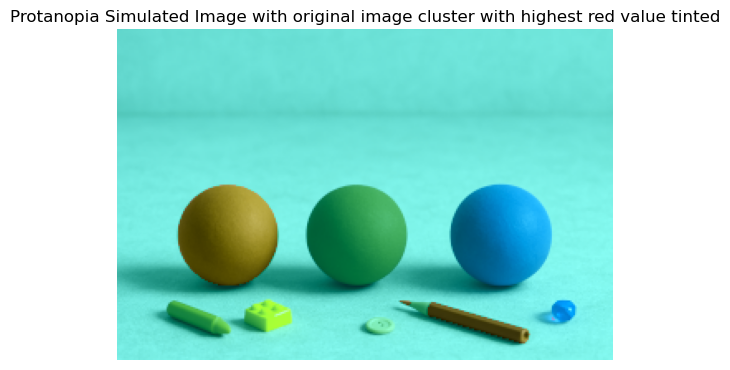

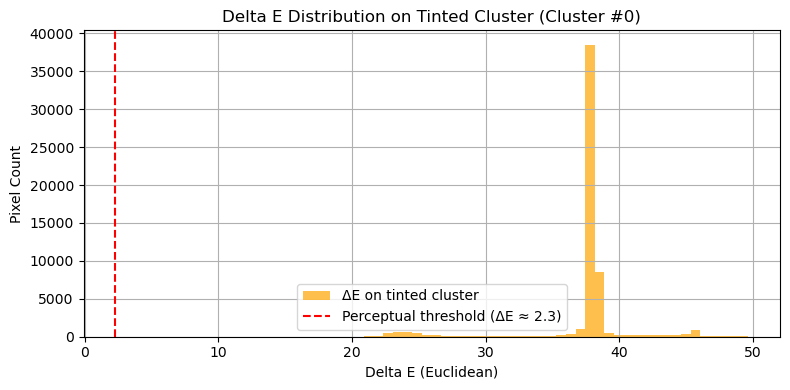

In [72]:
visualize_and_tint_cvd_clusters("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/protanopia_True_chatGPT_find_the_correct_object.png", k=2, cvd_type="protanopia")

Now one cluster has a green colour centroid, and the other - a centroid with a higher red value (as it contains the red ball). Then, the cluster containing the red ball is indeed the one coloured, but that means most of the image gets distorted. 

To get around this problem of random centroid initialization, I will make use of the fact that I have constrained the number of clusters to always be $k=2$, and amend the centroid initialization to make sure that one of the clusters contains the desired elements to be coloured.

I will amend the ```initialize_centroids``` function to now depending on ```cvd_type``` initialize non-random clusters: one "neutral" and one of the desired channel value.

#### 4.4.4. Sumarry of function changes 

| Function                      | Change                                                     | Purpose                                                               |
|------------------------------|--------------------------------------------------------------|-----------------------------------------------------------------------|
|```initialize_centroids```| Initializes k-means centroids based on CVD type and LAB axis. | Ensures optimal starting points for clustering based on expected color confusion. |
|```k_means_color_clustering```| Uses the new ```initialize_centroids``` function. Now takes in ```cvd_type``` as input. |  |

#### 4.4.5. Additional code and results with updated centroid initialization

In [75]:
def initialize_centroids(data: np.ndarray, k: int, mode: str = None, cvd_type: str = None) -> np.ndarray:
    """
    Initialize centroids either randomly or heuristically based on CVD type.
    
    Args:
        data (np.ndarray): Input data (Nx1).
        k (int): Number of clusters.
        mode (str): 'a', 'b', or 'ab'.
        cvd_type (str): 'protanopia', 'deuteranopia', or 'tritanopia'.

    Returns:
        np.ndarray: Initialized centroids (kx1).
    """
    if k == 2 and data.shape[1] == 1 and mode in ('a', 'b') and cvd_type:
        # Non-random initial centroid values
        if mode == 'a':  # red-green axis
            if cvd_type == 'protanopia':
                return np.array([[100.0], [0.0]])  # Very red and neutral
            elif cvd_type == 'deuteranopia':
                return np.array([[-100.0], [0.0]])  # Very green and neutral
        elif mode == 'b' and cvd_type == 'tritanopia':
            return np.array([[-100.0], [0.0]])  # Very blue and neutral

In [76]:
def k_means_color_clustering(image_path: str, k: int, iterations: int = 10, cvd_type: str = None) -> tuple[dict[int, list], np.ndarray, np.ndarray, np.ndarray, np.ndarray]:
    """
    Perform k-means clustering on selected LAB channel(s) of the image.
    
    Args:
        image_path (str): Path to the sRGB image file.
        k (int): Number of clusters.
        iterations (int): Number of k-means iterations.
        mode (str): 'a' or 'b', to cluster based on a-channel or b-channel.

    Returns:
        Tuple:
        - clusters_RGB (dict[int, list]): Mapping of cluster index to RGB pixel values.
        - srgb_img (np.ndarray): Original RGB image array.
        - indices (np.ndarray): Flat array of cluster indices for each pixel.
        - cluster_mask (np.ndarray): 2D cluster label map (H, W).
        - centroids (np.ndarray): Final centroid positions (a or b-space).
    """
    srgb_img = np.asarray(Image.open(image_path).convert("RGB"))
    lab_img = rgb2lab(srgb_img / 255.0)
    H, W, _ = lab_img.shape
    a = lab_img[:, :, 1]
    b = lab_img[:, :, 2]

    # Choose LAB channel for clustering based on CVD type
    mode = 'a' if cvd_type in ('protanopia', 'deuteranopia') else 'b'
    

    if mode == 'a':
        data = a.ravel().reshape(-1, 1)
    elif mode == 'b':
        data = b.ravel().reshape(-1, 1)
    else:
        raise ValueError("Mode must be a or b")

    centroids = initialize_centroids(data, k, mode=mode, cvd_type=cvd_type)

    for _ in range(iterations):
        cluster_dict, indices = recalc_points_clusters(data, centroids)
        centroids = recalc_centroids(data, indices, k)

    cluster_mask = indices.reshape(H, W)
    visualize_clusters_on_image(cluster_mask, srgb_img)

    rgb_flat = srgb_img.reshape(-1, 3)
    clusters_RGB = {i: rgb_flat[indices == i].tolist() for i in range(k)}
    
    return clusters_RGB, srgb_img, indices, cluster_mask, centroids

And finally let's see if this solved our issue:

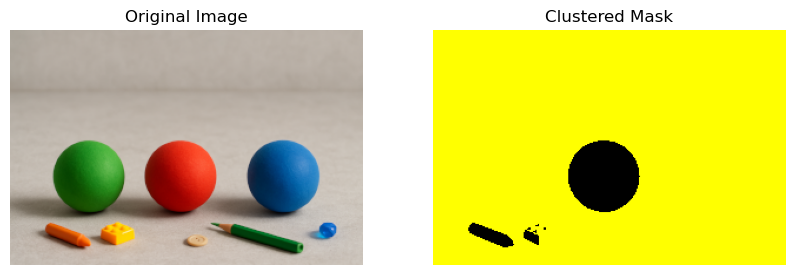

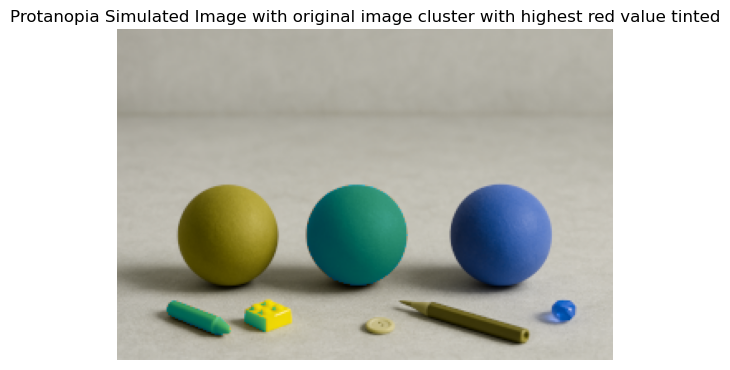

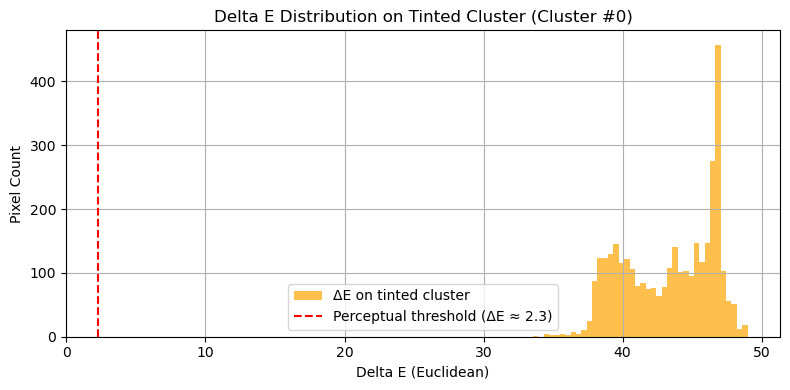

In [237]:
visualize_and_tint_cvd_clusters("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/protanopia_True_chatGPT_find_the_correct_object.png", k=2, cvd_type="protanopia")

Much better! Now we are confident that the part of the simulated image that changed colour as compared to the initial simulated image, is the one that contains objects with a high channel value, of the channel we are colour blind for. The tint is also chosen, so that (at least from trichromatic point of view), there is sufficient perceptual difference gained. 

Let's proceed to daltonize this corrected image to see how much of this perceptual difference is actually achieved. In theory, a protanope should be able to see green and blue hues, but this is not precicely the case. We have seen earlier, that colour blindness leads to colour confusion, rather than a simple inability to see a certain colour. We remember from the Brettel results that all three channels can be affected by the CVD simulation. 

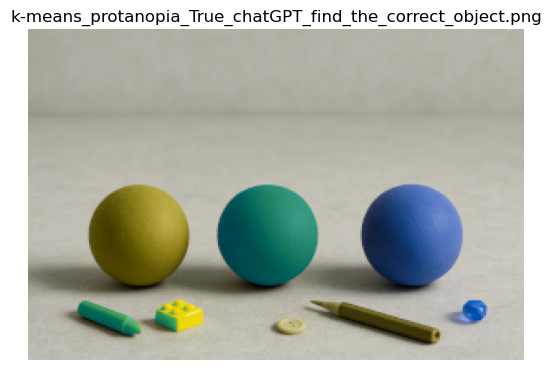

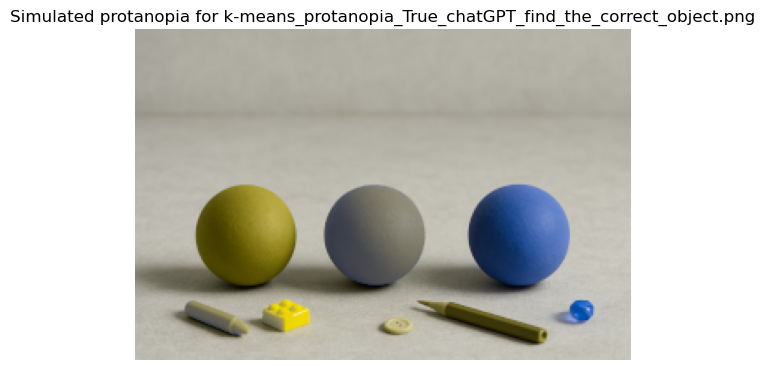

In [238]:
dantonize_Brettel_1997("protanopia", "./image_outputs/k-means_protanopia_True_chatGPT_find_the_correct_object.png", vischeck=True)

L Channel Std Dev - Simulated Original:  16.59
L Channel Std Dev - Simulated Corrected: 16.11
⚠️ No contrast improvement.


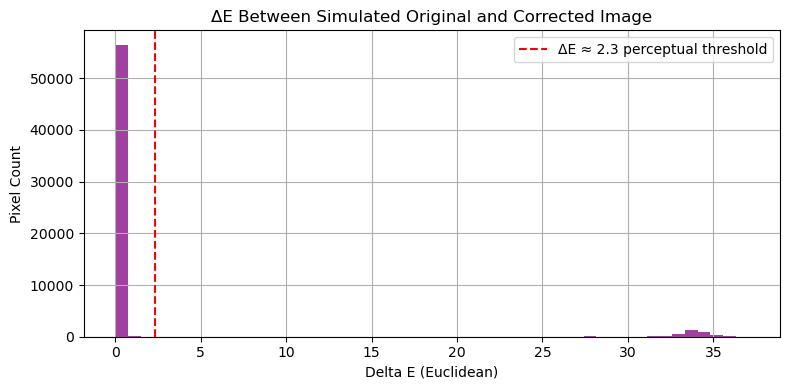

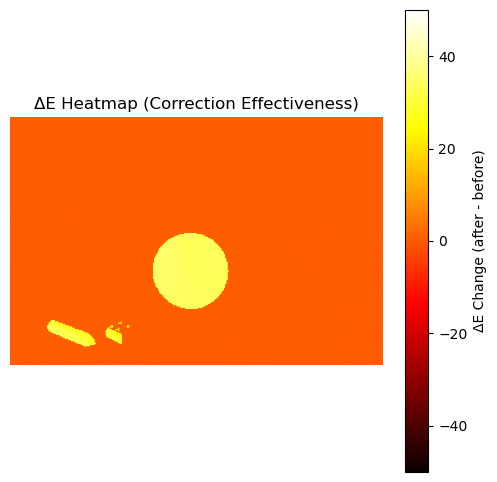

In [239]:
analyze_correction_effectiveness("./image_outputs/protanopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/protanopia_True_k-means_protanopia_True_chatGPT_find_the_correct_object.png")

Form the histogram, we see that there are some pixels with a Euclidean distance around $35$, and we verify these pixels are the red ball ones on the heatmap. So we have achieved a perceptual difference with our correction, and now the red ball is distingiushable from the green ball!

Chroma Std Dev - Simulated Original:  13.57
Chroma Std Dev - Simulated Corrected: 12.06
⚠️ No chroma contrast improvement.


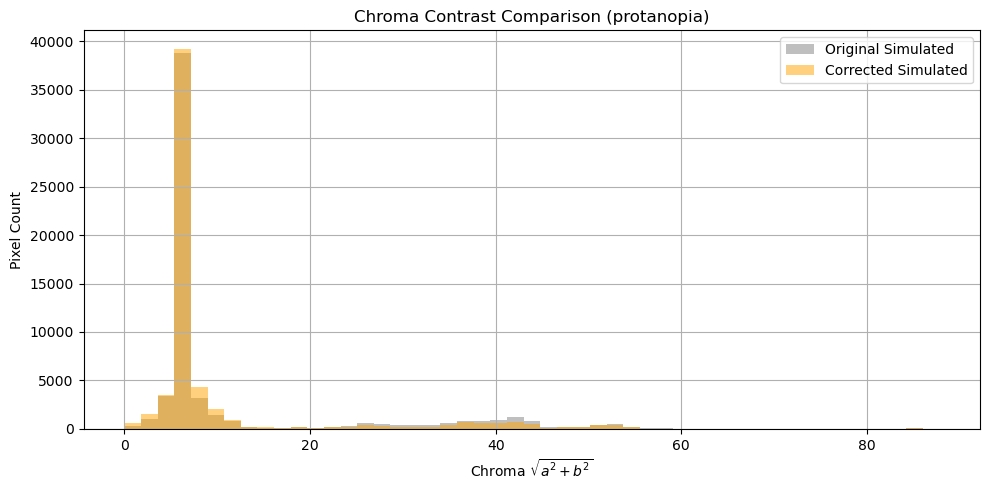

In [240]:
analyze_chroma_contrast("./image_outputs/protanopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/protanopia_True_k-means_protanopia_True_chatGPT_find_the_correct_object.png")

Not unexpectedly, the chroma contrast hasn't improved. The red and the green ball should be distinguishable now, but we haven't affected the overall colour vivdness of the image. 

Let's now see quickly how this works for the green ball (deuteranopia) and the blue ball (tritanopia).

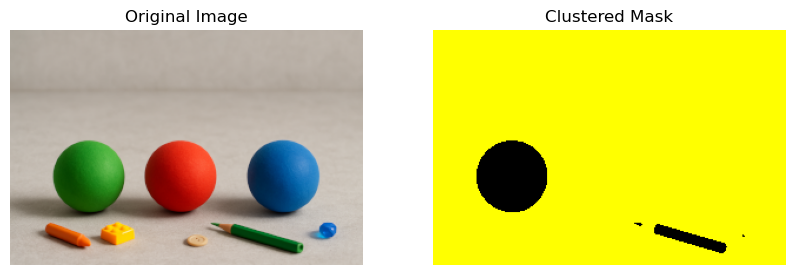

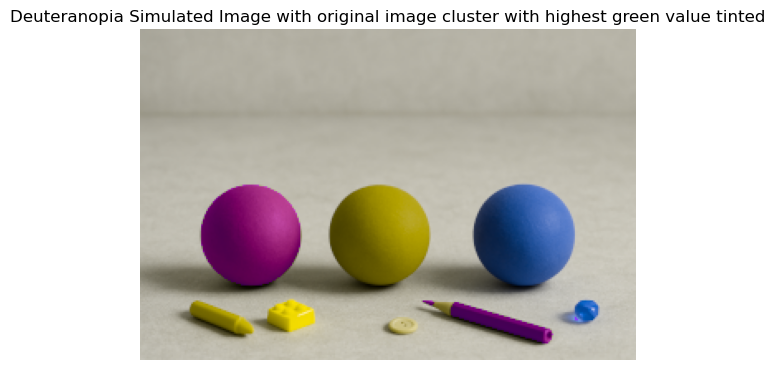

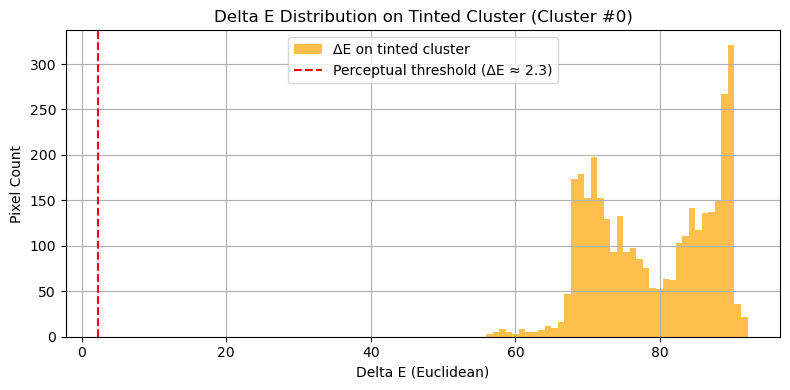

In [241]:
visualize_and_tint_cvd_clusters("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/deuteranopia_True_chatGPT_find_the_correct_object.png", k=2, cvd_type="deuteranopia")

As with the previous case, we get high values of Euclidean pixel distances between the originally simulated green ball and the tinted one. Let's do a quick daltonization of the result to verify that the red and the green ball look different now, after tinting.

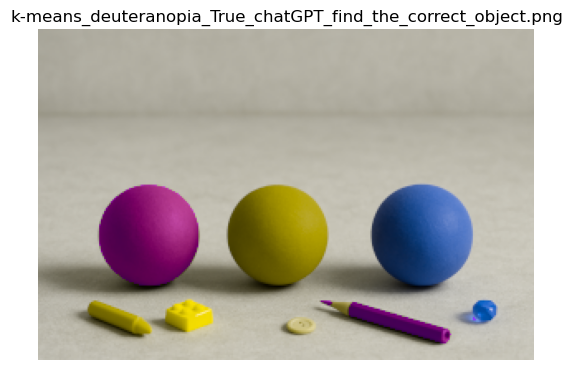

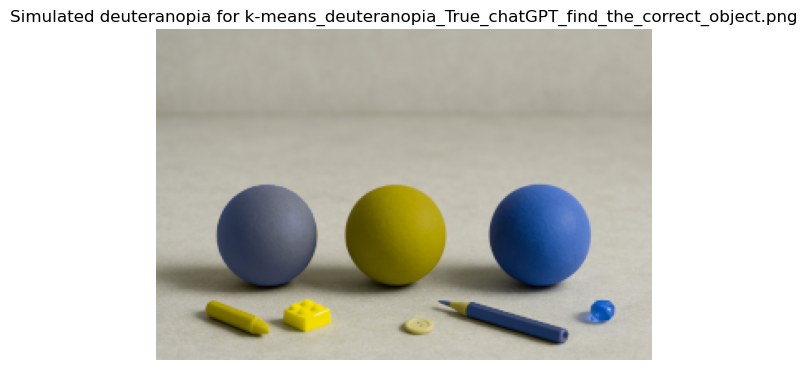

In [242]:
dantonize_Brettel_1997("deuteranopia", "./image_outputs/k-means_deuteranopia_True_chatGPT_find_the_correct_object.png", vischeck=True) 

L Channel Std Dev - Simulated Original:  16.32
L Channel Std Dev - Simulated Corrected: 16.61
✅ Contrast increased after correction.


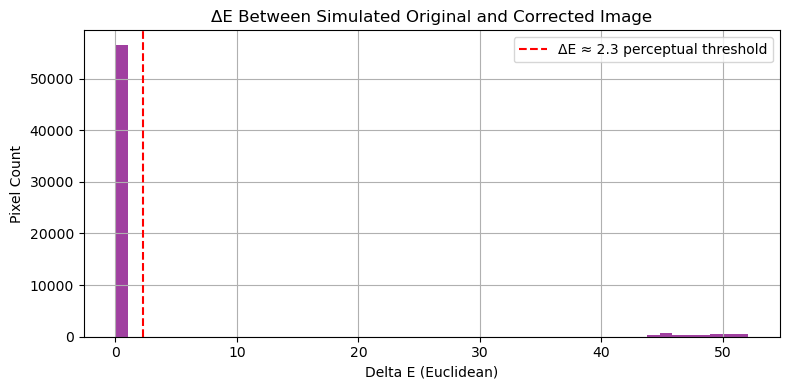

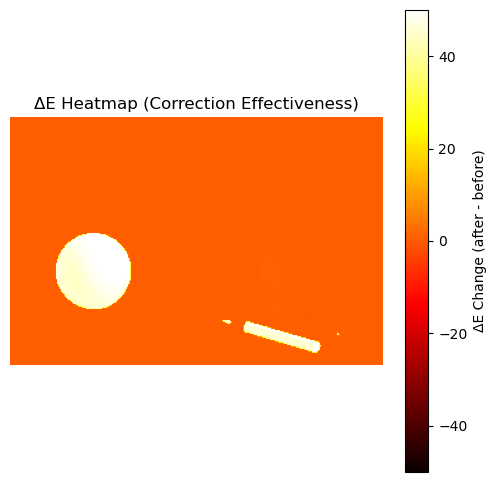

In [243]:
analyze_correction_effectiveness("./image_outputs/deuteranopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/deuteranopia_True_k-means_deuteranopia_True_chatGPT_find_the_correct_object.png")

Here we have achieved an even greater perceptual difference via our tinting - the Euclidean distance for the green ball pixels between the original deuteranopia simulation, and the corrected image is more than $45$! 

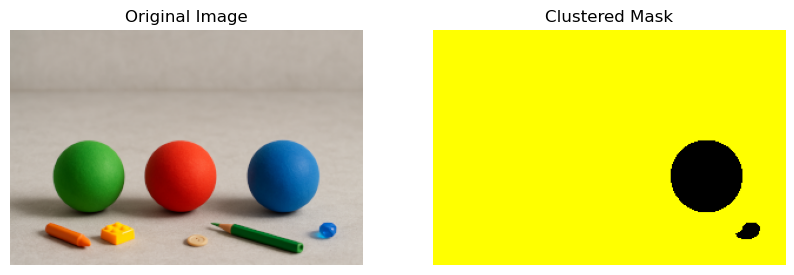

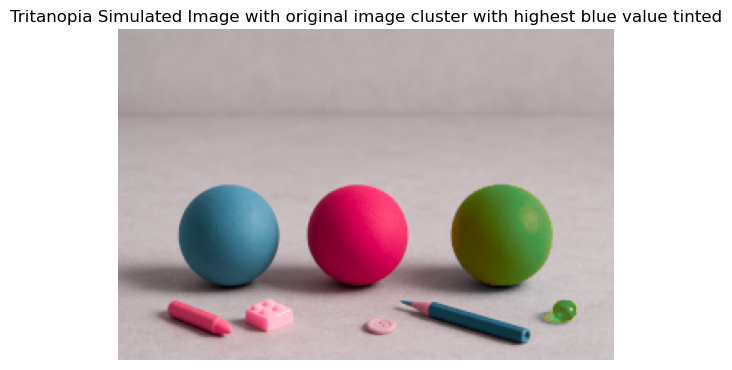

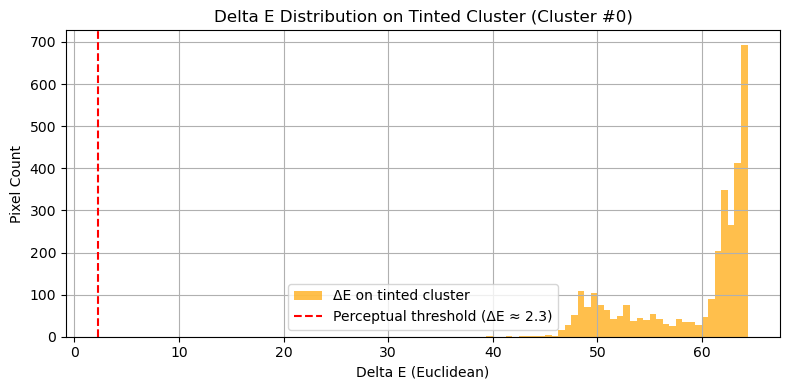

In [244]:
visualize_and_tint_cvd_clusters("./image_inputs/chatGPT_find_the_correct_object.png", "./image_outputs/tritanopia_True_chatGPT_find_the_correct_object.png", k=2, cvd_type="tritanopia")

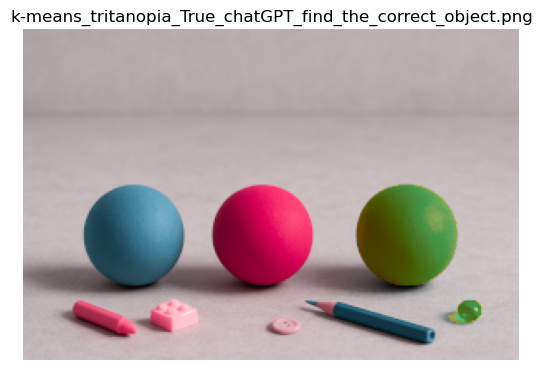

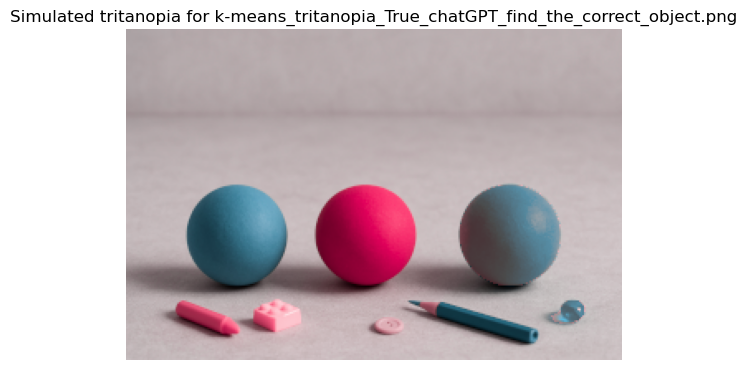

In [245]:
dantonize_Brettel_1997("tritanopia", "./image_outputs/k-means_tritanopia_True_chatGPT_find_the_correct_object.png", vischeck=True)

L Channel Std Dev - Simulated Original:  16.34
L Channel Std Dev - Simulated Corrected: 15.60
⚠️ No contrast improvement.


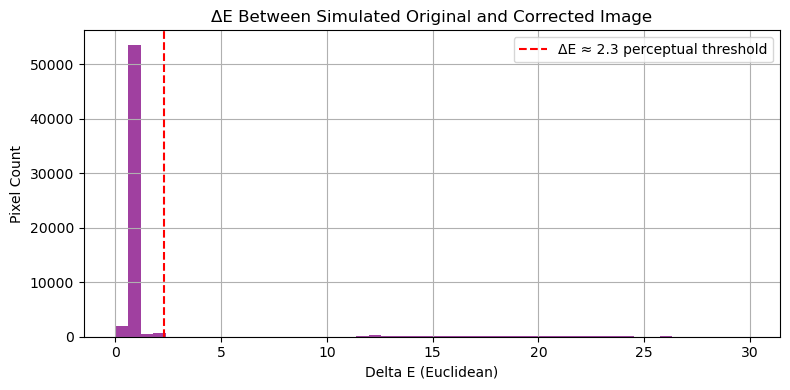

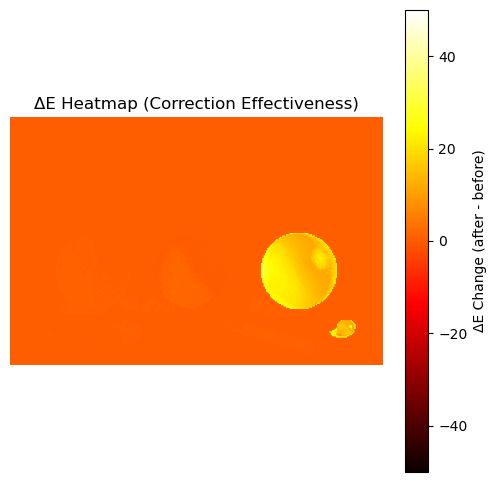

In [246]:
analyze_correction_effectiveness("./image_outputs/tritanopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/tritanopia_True_k-means_tritanopia_True_chatGPT_find_the_correct_object.png")

Here a perceptual difference of above $10$ was achieved, but the result is less impressive, as the blue ball still visually resembles the green ball.

Let's finally check how the flower picture would look like for a protanope after the correction.

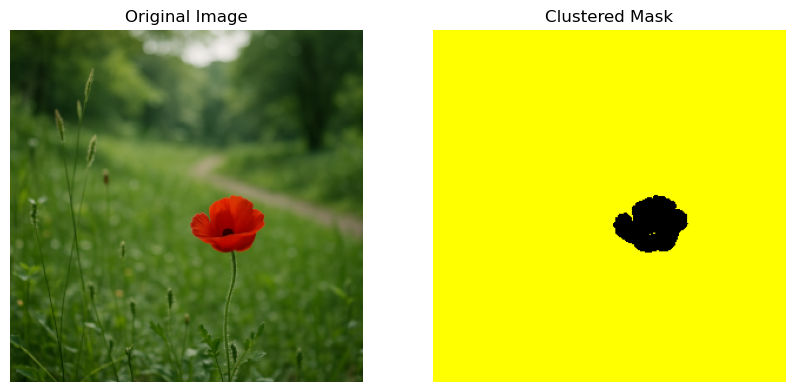

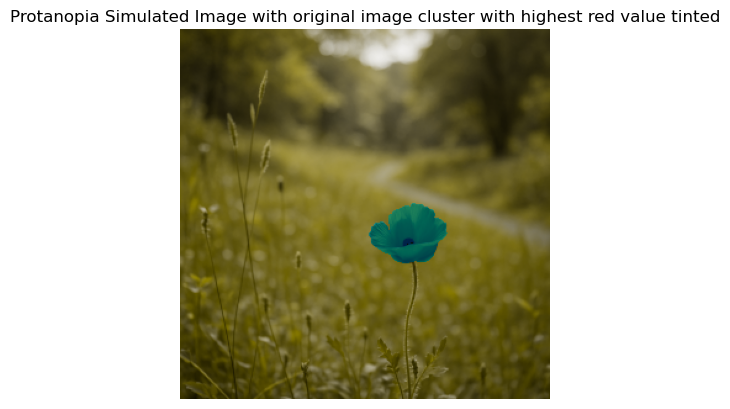

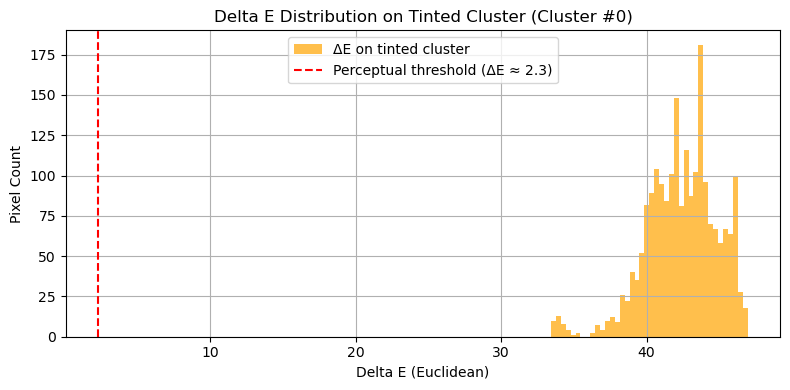

In [247]:
visualize_and_tint_cvd_clusters("./image_inputs/chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_chatGPT_single_red_flower.png", k=2, cvd_type="protanopia")

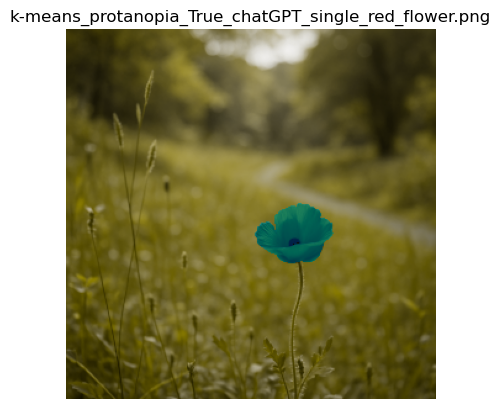

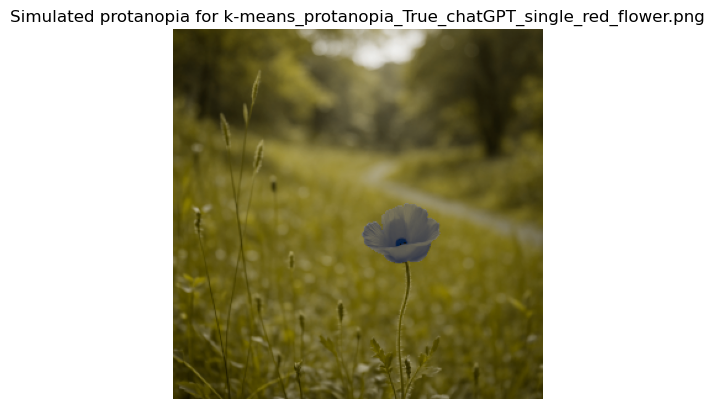

In [248]:
dantonize_Brettel_1997("protanopia", "./image_outputs/k-means_protanopia_True_chatGPT_single_red_flower.png", vischeck=True)

L Channel Std Dev - Simulated Original:  12.81
L Channel Std Dev - Simulated Corrected: 12.76
⚠️ No contrast improvement.


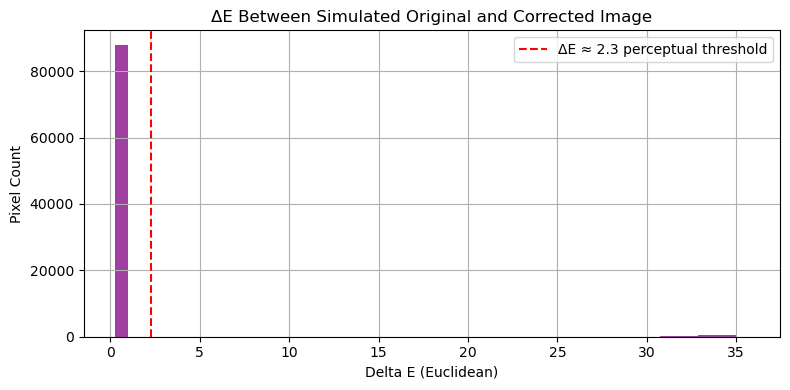

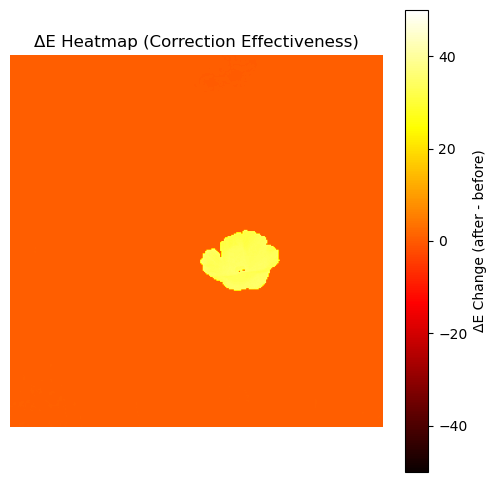

In [249]:
analyze_correction_effectiveness("./image_outputs/protanopia_True_chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_k-means_protanopia_True_chatGPT_single_red_flower.png")

A perceptual difference of around $35$ was ahieved for the flower as compared to before.

Overall, this is a success! Let's verify some of the Ishihara plates below, as well.

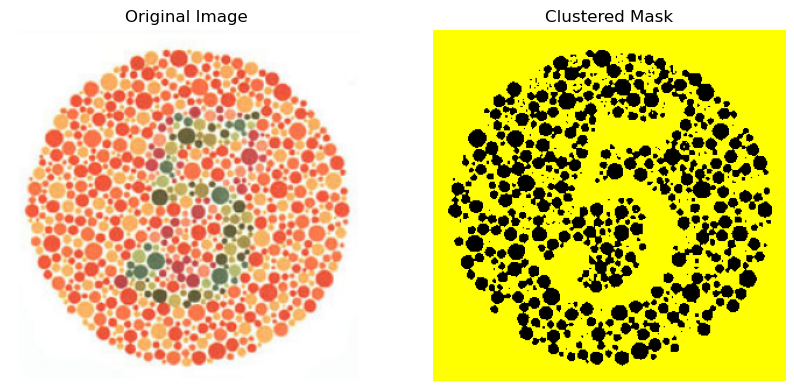

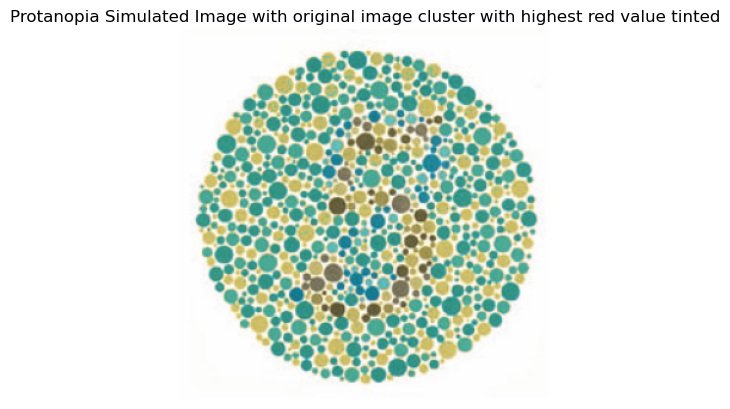

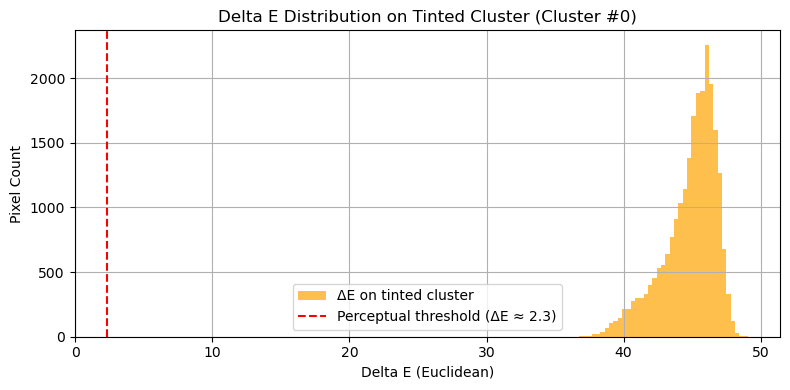

In [250]:
visualize_and_tint_cvd_clusters("./image_inputs/Ishihara_plate_6.png", "./image_outputs/protanopia_True_Ishihara_plate_6.png", k=2, cvd_type="protanopia")

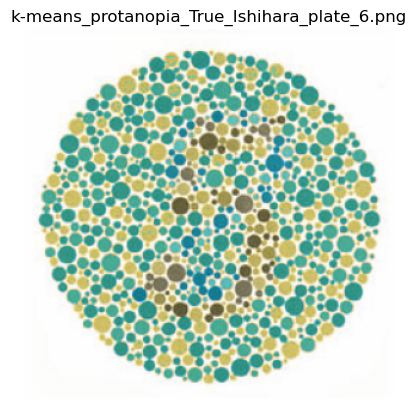

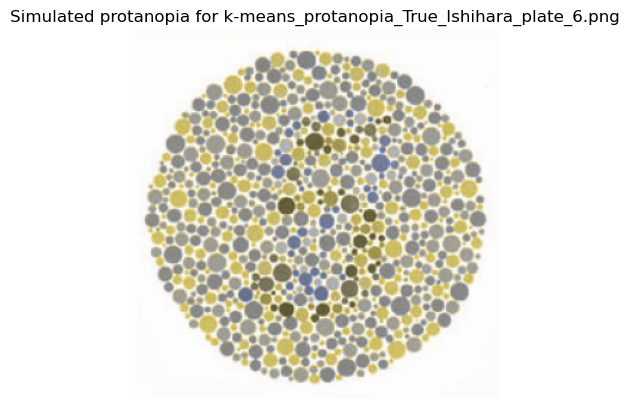

In [251]:
dantonize_Brettel_1997("protanopia", "./image_outputs/k-means_protanopia_True_Ishihara_plate_6.png", vischeck=True)

L Channel Std Dev - Simulated Original:  17.79
L Channel Std Dev - Simulated Corrected: 16.56
⚠️ No contrast improvement.


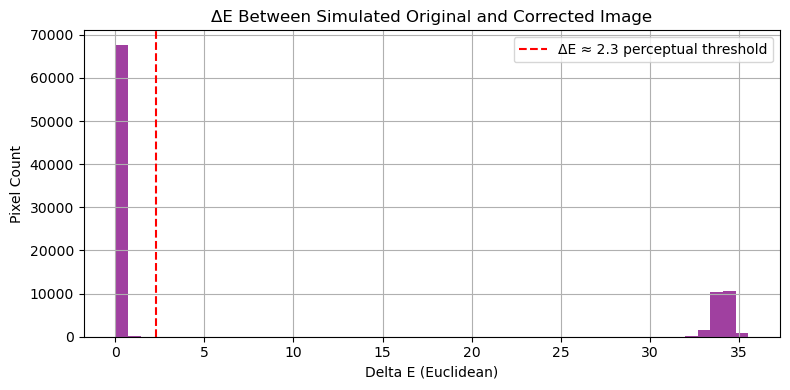

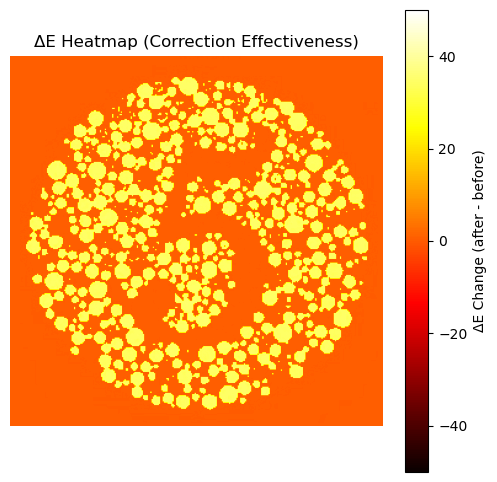

In [252]:
analyze_correction_effectiveness("./image_outputs/protanopia_True_Ishihara_plate_6.png", "./image_outputs/protanopia_True_k-means_protanopia_True_Ishihara_plate_6.png")

The five is not very visible in the daltonized corrected image, but nevertheless, can be distinguished. We see from the heatmap that the most difference has been achieved for the region around the five, but some of the small circles are still the same colour as the number, so they make it blend with the background and be hard to distinguish.

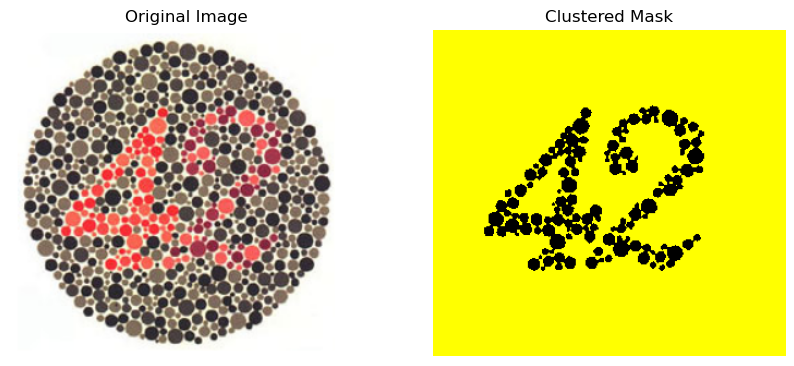

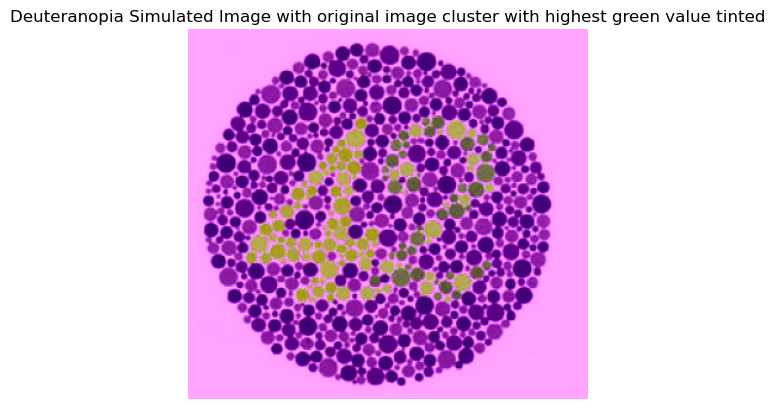

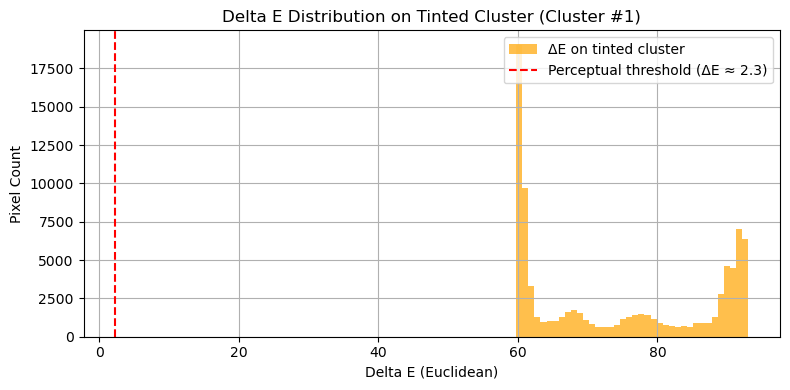

In [253]:
visualize_and_tint_cvd_clusters("./image_inputs/Ishihara_plate_23.png", "./image_outputs/deuteranopia_True_Ishihara_plate_23.png", k=2, cvd_type="deuteranopia")

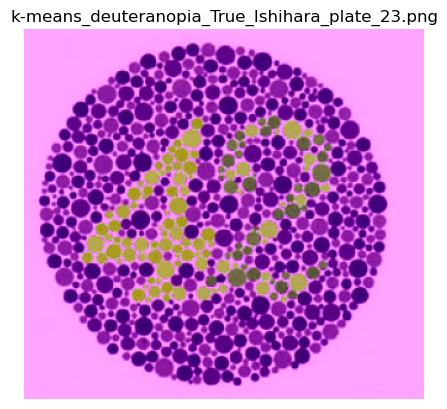

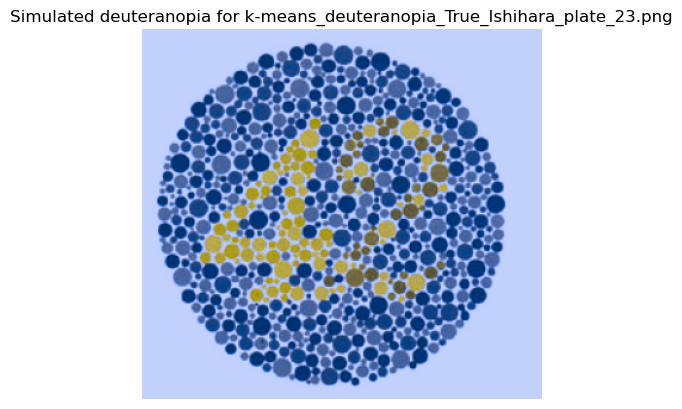

In [254]:
dantonize_Brettel_1997("deuteranopia", "./image_outputs/k-means_deuteranopia_True_Ishihara_plate_23.png", vischeck=True)

L Channel Std Dev - Simulated Original:  28.99
L Channel Std Dev - Simulated Corrected: 22.76
⚠️ No contrast improvement.


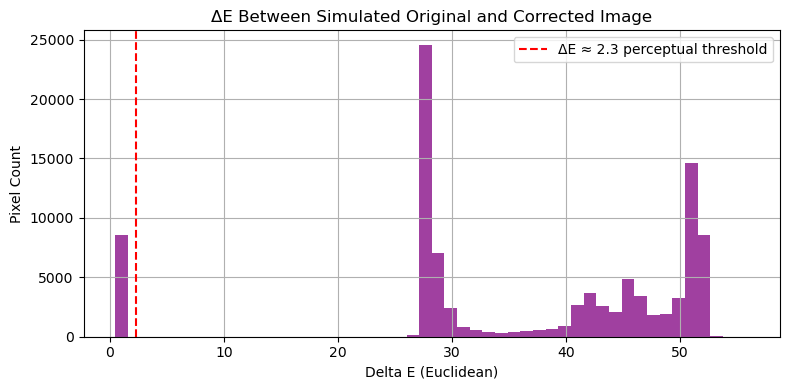

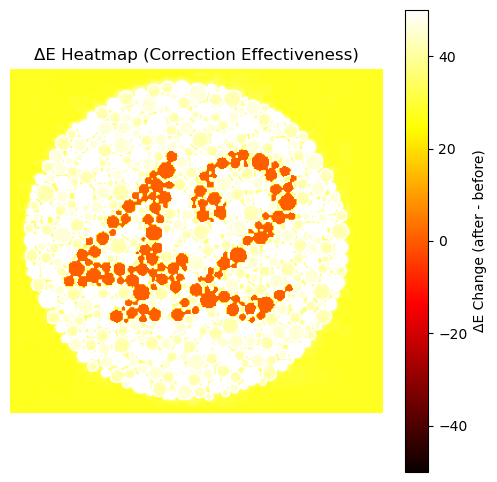

In [255]:
analyze_correction_effectiveness("./image_outputs/deuteranopia_True_Ishihara_plate_23.png", "./image_outputs/deuteranopia_True_k-means_deuteranopia_True_Ishihara_plate_23.png")

This plate has more success - the $42$ is visible, and we have a very high perceptual difference for the whole background, making the number stand out!

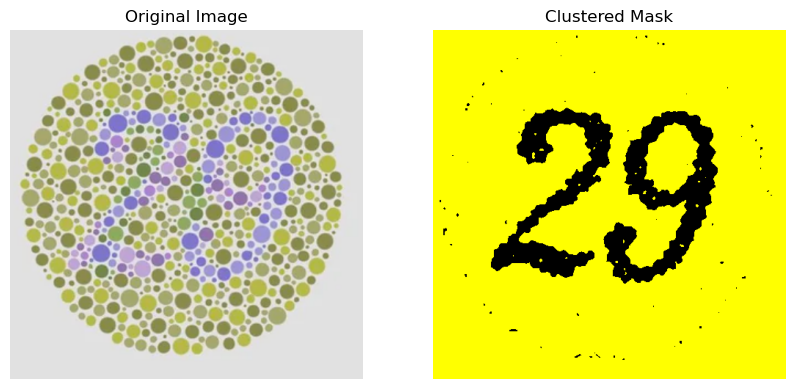

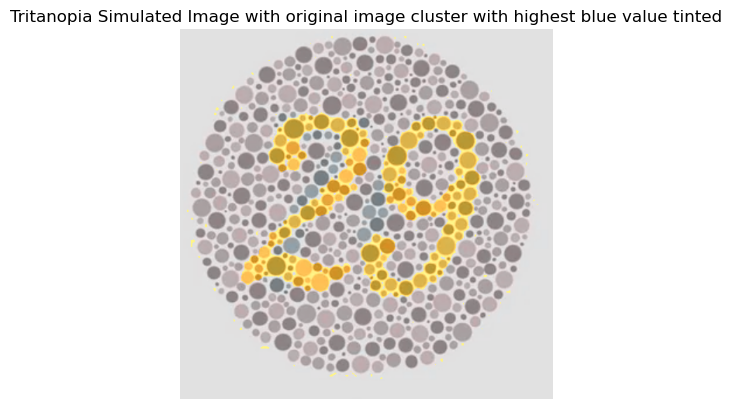

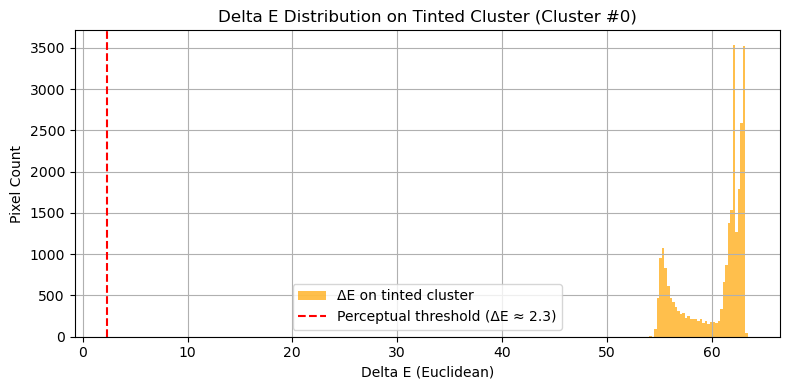

In [256]:
visualize_and_tint_cvd_clusters("./image_inputs/Reddit_user_plate_70.png", "./image_outputs/tritanopia_True_Reddit_user_plate_70.png", k=2, cvd_type="tritanopia")

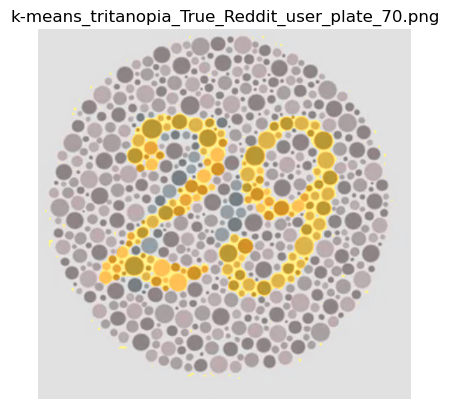

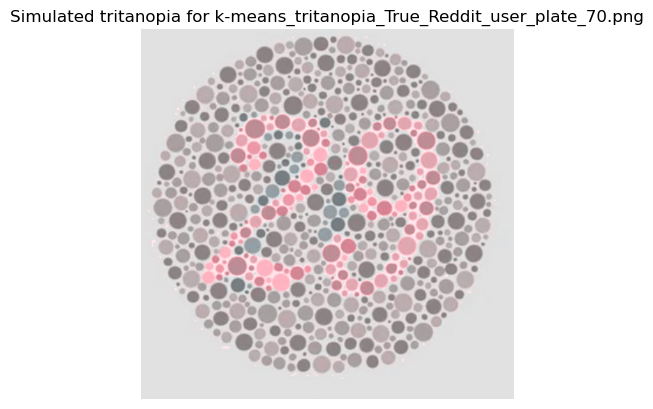

In [257]:
dantonize_Brettel_1997("tritanopia", "./image_outputs/k-means_tritanopia_True_Reddit_user_plate_70.png", vischeck=True)

L Channel Std Dev - Simulated Original:  12.57
L Channel Std Dev - Simulated Corrected: 11.98
⚠️ No contrast improvement.


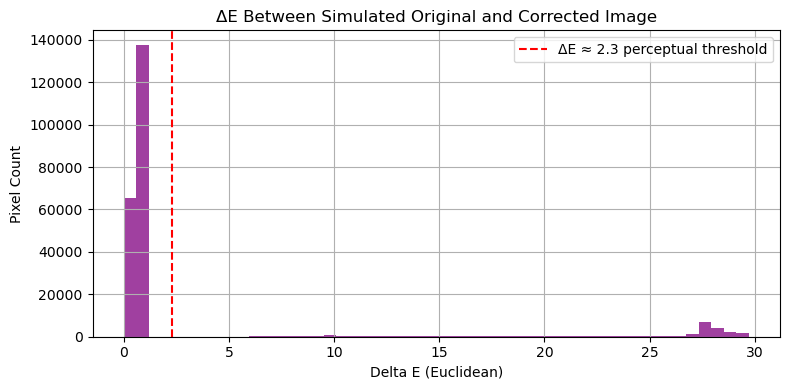

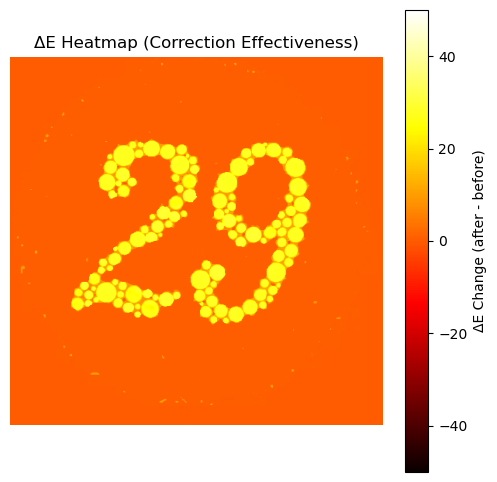

In [258]:
analyze_correction_effectiveness("./image_outputs/tritanopia_True_Reddit_user_plate_70.png", "./image_outputs/tritanopia_True_k-means_tritanopia_True_Reddit_user_plate_70.png")

Again, very successful! We have achieved a high perceptual difference for the number, and it really stands out.

### 4.5. Summary of results

What I have achieved is a reduced dependency on the initialization by essentially determining the initial clusters myself. Is this a good approach for k-means clustering in general? Likely not. Does it work for our specific case and the constraint of $k=2$ clusters? Yes. Overall, I am happy of the Ishihara plate number uncovering, and the lost detail uncovering on the other two pictures.

### 4.6. What is missing?

However, I wanted to see if it is possible to both uncover the lost details and Ishihara plate numbers, and increase the chroma contrast, as well, while maintaining fairly visually pleasing results. Therefore, I have decided to look at the Lee and Santos (2010) paper. The reason behind it is a proposed model that transforms the original colours, therefore, changing the original image $a^{*}$ and $b^{*}$ values, which I expect to have an effect on the chroma contrast. A further argument is the fact that they do a histogram equalization of the non-CVD channels, which would also affect the $L^{*}$ distrubtion, and likely add more contrast on our original image. Contrast is the difference in brightness between the light and the dark parts of an image, therefore, a histogram equalization would add to a higher perception of contrast.  

After daltonizing this transformed and equalized image, I am curious to see whether the contrast of brightness and of chroma would transfer to the simulated image, thus, making colours that blended in stand out more.

Here is a summary of our next correction method:

* Task: Uncover Ishihara plate numbers and lost details, while maintaining a visually pleasing CVD simulated image
* Assumption (as usual): that ```dantonize_Brettel_1997``` with ```vischeck=True``` gives an accurate representation of CVD
* Another assumption: that ```equalize_hist``` from ```skimage.exposure``` works as intended in the paper
* Final assumption: that my extension of the Method B model is correct and doesn't affect the model implementation after

## 5. Lee and Santos (2010)

As we have already observed, the k-means clustering algorithm above will work only for deciphering the correct pattern or number on Ishihara plates, and for pictures with focus objects in the channel where colour vision is reduced. However, we have seen that it does not work well for the picture with a forest. 

For completeness, I have decided to implement a simple final algorithm proposed by See and Santos (2010), that could be used for such pictures, where k-means produces undesirable results and doesn't bring about many visual benefits. 

### 5.1. Method B - discussion 

The algorithm proposed by Lee and Santos (2010) that I have decided to use is Method B. The main idea is a linear transformation that aims to correct the effects of colour blindness. This paper defines as $\alpha_{p}$ the degree of protanopia and as $\alpha_{d}$ the degree of deuteranopia. Let the original image colours $\vec{f}$ have red, green and blue components, such that $\vec{f}=(f_{r}, f_{g}, f_{b})$ and let us equally distribute the information of the colour channel where information is lost to the other two channels. 

So, for protanopia, the new green component $f_{g}^\prime$ will be such that $f_{g}^\prime = \frac{\alpha_{p}}{2}f_{r} + \frac{2-\alpha_{p}}{2}f_{g}$ and the new blue component $f_{b}^\prime$ will be such that $f_{b}^\prime = \frac{\alpha_{p}}{2}f_{r} + \frac{2-\alpha_{p}}{2}f_{b}$ . 

For deuteranopia, the new red component $f_{r}^\prime$ will be such that $f_{r}^\prime =  \frac{\alpha_{d}}{2}f_{g} + \frac{2-\alpha_{d}}{2}f_{r}$ and the new blue component $f_{b}^\prime$ will be such that $f_{b}^\prime = \frac{\alpha_{d}}{2}f_{g} + \frac{2-\alpha_{d}}{2}f_{b}$ .

Here, I propose the following for the new red component $f_{r}^\prime$ for tritanopia $f_{r}^\prime =  \frac{\alpha_{t}}{2}f_{b} + \frac{2-\alpha_{t}}{2}f_{r}$ and a new green component $f_{g}^\prime$ will be such that $f_{g}^\prime = \frac{\alpha_{t}}{2}f_{b} + \frac{2-\alpha_{t}}{2}f_{g}$, for $\alpha_{t}$ the degree of tritanopia. 

Therefore, we have that for $f_{r}^\prime$:

$$ 2 f_{r}^\prime = \frac{\alpha_d}{2}f_{g} + \frac{2-\alpha_d}{2}f_{r} + \frac{\alpha_t}{2}f_b + \frac{2-\alpha_t}{2}f_r $$

$$ f_{r}^\prime = \frac{\alpha_d}{4}f_{g} + \frac{\alpha_t}{4}f_{b} + \frac{4-\alpha_d-\alpha_t}{4}f_{r}$$ 

, for $f_{g}^\prime$

$$ 2 f_{g}^\prime = \frac{\alpha_p}{2}f_{r} + \frac{2-\alpha_p}{2}f_{g} + \frac{\alpha_t}{2}f_{b} + \frac{2-\alpha_t}{2}f_{r} $$

$$ f_{g}^\prime = \frac{\alpha_p}{4}f_{r} + \frac{\alpha_t}{4}f_{b} + \frac{4-\alpha_p-\alpha_t}{4}f_{g}$$ 

, and similarly for $f_{b}^\prime$: 

$$ 2 f_{b}^\prime = \frac{\alpha_p}{2}f_{r} + \frac{2-\alpha_p}{2}f_{b} + \frac{\alpha_d}{2}f_{g} + \frac{2-\alpha_d}{2}f_{b} $$

$$ f_{b}^\prime = \frac{\alpha_p}{4}f_{r} + \frac{\alpha_d}{4}f_{g} + \frac{4-\alpha_p-\alpha_d}{4}f_{b}$$ 

So, our transformation metrix from $\begin{pmatrix} R \\ G \\ B \end{pmatrix}$ to $\begin{pmatrix} R^\prime \\ G^\prime \\ B^\prime \end{pmatrix}$ will be: 

$$ \begin{pmatrix} R^\prime \\ G^\prime \\ B^\prime \end{pmatrix} = \begin{pmatrix} \frac{4-\alpha_d-\alpha_t}{4} & \frac{\alpha_d}{4} & \frac{\alpha_t}{4} \\ \frac{\alpha_p}{4} &   \frac{4-\alpha_p-\alpha_t}{4} & \frac{\alpha_t}{4} \\ \frac{\alpha_p}{4} & \frac{\alpha_d}{4} & \frac{4-\alpha_p-\alpha_d}{4} \end{pmatrix} \begin{pmatrix} R \\ G \\ B \end{pmatrix} $$

Afterwards, a histogram equalization is applies to the non-CVD channels. Due to time constraints, I will use the ```equalize_hist``` function from ```skimage.exposure```to do that.

Finally, after the original image has been transformed, it is daltonized with the Brettel et al (1997) algorithm. We will see if the result shows any added contrast, and discuss.

### 5.2. Method B in code

#### 5.2.1. Summary of functions that will be used

| Function                      | Summary                                                      | Purpose                                                               |
|------------------------------|--------------------------------------------------------------|------------------------------------------------------------------------|
|```Lee_and_Santos_correction```|Applies Lee & Santos color correction for a selected CVD type|Enhances color distinction in images for protanopia, deuteranopia, or tritanopia|
|```equalize_non_cvd_channels```|Performs histogram equalization on non-CVD RGB channels|Improves contrast by enhancing unaffected color channels|
|```plot_rgb_histograms```|Plots original vs. equalized histograms for each RGB channel|Visualizes changes in channel distributions after histogram equalization|
|```analyze_correction_effectiveness``` (from before)|Computes Delta E and contrast difference between simulated and corrected images|Evaluates the visual impact of correction via perceptual color distance and contrast|
|```plot_l_channel_histograms```|Overlays histograms of the L (lightness) channel for original and corrected images|Assesses correction impact on brightness and contrast in CIE Lab space|
|```analyze_chroma_contrast``` (from before)|Computes and plots chroma ($\sqrt{a^2 + b^2}$) histograms for both images|Measures and visualizes perceptual color contrast (saturation/vividness)|

#### 5.2.2. Code

Let's define the transformation matrices for our pure CVD cases with the respective $\alpha$ being equal to one, as I am focusing on the pure protanopia, deuteranopia and tritanopia cases.

In [90]:
T_correction_protanopia = np.array(
    [
        [1, 0, 0],
        [0.25, 0.75, 0], 
        [0.25, 0, 0.75]
    ]
)

In [91]:
T_correction_deuteranopia = np.array(
    [
        [0.75, 0.25, 0],
        [0, 1, 0], 
        [0, 0.25, 0.75]
    ]
)

In [92]:
T_correction_tritanopia = np.array(
    [
        [0.75, 0, 0.25],
        [0, 0.75, 0.25], 
        [0, 0, 1]
    ]
)

In [96]:
def Lee_and_Santos_correction(orig_image_path: str, cvd_type: str):
    """
    Applies the Lee and Santos linear color transformation to correct images 
    for a given type of color vision deficiency (CVD), and displays the 
    original vs. corrected result side by side.

    Args:
        orig_image_path (str): Path to the original RGB image.
        cvd_type (str): Type of color vision deficiency to correct for - 'protanopia', 'deuteranopia', or 'tritanopia'.

    Returns:
        None.
    """
    srgb_img = np.asarray(Image.open(orig_image_path).convert("RGB"))

    img_name = Path(orig_image_path).name

    if(cvd_type == "protanopia"): 
        T = T_correction_protanopia
    elif(cvd_type == "deuteranopia"):
        T = T_correction_deuteranopia
    else: 
        T = T_correction_tritanopia
        
    corrected = srgb_img @ T.T

    corrected = np.clip(corrected / 255.0, 0, 1)  # Normalize and clip

    # Prepare the original image for display (normalize to 0-1)
    original = np.clip(srgb_img / 255.0, 0, 1)
    
    # Plot side-by-side comparison
    plt.figure(figsize=(10, 5))
    plt.suptitle("Original (left) vs. Lee and Santos Corrected Image (right)")

    plt.subplot(1, 2, 1)
    plt.imshow(original)
    plt.axis("off")
    plt.title("Original")

    plt.subplot(1, 2, 2)
    plt.imshow(corrected)
    plt.axis("off")
    plt.title(f"Corrected ({cvd_type})")

    plt.tight_layout()
    plt.subplots_adjust(top=0.85)
    plt.show()

    # Save the corrected image

    plt.imsave(f"./image_outputs/Lee_Santos_{cvd_type}_{img_name}", corrected)   

In [261]:
def equalize_non_cvd_channels(image_path:str, cvd_type:str="protanopia"):
    """
    Equalizes the histogram of non-deficient color channels in an image 
    based on the specified type of color vision deficiency (CVD).

    Args:
        image_path (str): Path to the input RGB image.
        cvd_type (str): One of 'protanopia', 'deuteranopia', 'tritanopia'.

    Returns:
        None
    """
    # Load and normalize image to [0, 1]
    img = np.asarray(Image.open(image_path).convert("RGB"), dtype=np.float32) / 255.0
    img_name = Path(image_path).name

    # Define non-deficient channels for each CVD type
    channel_indices = {
        "protanopia": [1, 2],     # Green and Blue
        "deuteranopia": [0, 2],   # Red and Blue
        "tritanopia": [0, 1]      # Red and Green
    }

    # Validate CVD type
    if cvd_type not in channel_indices:
        raise ValueError("cvd_type must be one of 'protanopia', 'deuteranopia', or 'tritanopia'.")

    # Apply histogram equalization to selected channels
    equalized_img = img.copy()
    for i in channel_indices[cvd_type]:
        equalized_img[..., i] = equalize_hist(equalized_img[..., i])

    # Clip values to [0.05,0.95] to avoid regions that are too dark or too bright
    equalized_img = np.clip(equalized_img, 0.05, 0.95)

    # Display the result
    plt.imshow(equalized_img)
    plt.title(f"Histogram-Equalized Image ({cvd_type})")
    plt.axis("off")
    plt.show()

    # Plot histograms of original vs. equalized channels
    plot_rgb_histograms(img, equalized_img, img_name=img_name)

    # Save the equalized image
    plt.imsave(f"./image_outputs/hist_eq_{img_name}", equalized_img)

In [307]:
def plot_rgb_histograms(original_img:np.array, equalized_img:np.array, img_name:str):
    """
    Plot RGB histograms of the original and equalized images for visual comparison.
    
    Args:
        original_img (np.ndarray): Original RGB image, normalized to [0, 1].
        equalized_img (np.ndarray): Histogram-equalized RGB image, normalized to [0, 1].
        img_name (str or None): Optional name for the figure window or title context.
    
    Returns:
        None
    """
    color_labels = ['Red', 'Green', 'Blue']
    color_codes = ['red', 'green', 'blue']

    for i, (label, color) in enumerate(zip(color_labels, color_codes)):
        plt.figure()
        plt.hist(equalized_img[..., i].ravel(), bins=30, alpha=0.5, color=color, label=f"{label} (after equalizing)")
        plt.hist(original_img[..., i].ravel(), bins=30, alpha=0.5, color='black', label="Lee and Santos corrected image")
        title = f"{label} Channel Histogram"
        if img_name:
            title += f" - {img_name}"
        plt.title(title)
        plt.legend()
        plt.xlabel("Intensity")
        plt.ylabel("Pixel Count")
        plt.tight_layout()
        plt.show()

In [263]:
def plot_l_channel_histograms(sim_orig_path:str, sim_corrected_path:str, cvd_type:str ="protanopia"):
    """
    Plots overlapping histograms of the L channel for simulated original and corrected images.
    Shows within 1 standard deviation range around the mean for each image.

    Args:
        sim_orig_path (str): Path to the simulated original image.
        sim_corrected_path (str): Path to the simulated corrected image.
        cvd_type (str): Type of color vision deficiency.
    """

    # Load and normalize images
    sim_orig = np.asarray(Image.open(sim_orig_path).convert("RGB"), dtype=np.float32) / 255.0
    sim_corrected = np.asarray(Image.open(sim_corrected_path).convert("RGB"), dtype=np.float32) / 255.0

    # Convert to Lab and extract L channels
    lab_orig = rgb2lab(sim_orig)
    lab_corrected = rgb2lab(sim_corrected)
    L_orig = lab_orig[..., 0].ravel()
    L_corrected = lab_corrected[..., 0].ravel()

    # Compute means and stds
    mean_orig, std_orig = np.mean(L_orig), np.std(L_orig)
    mean_corr, std_corr = np.mean(L_corrected), np.std(L_corrected)

    # Plot histograms
    plt.figure(figsize=(10, 5))
    bins = np.linspace(0, 100, 50)

    plt.hist(L_orig, bins=bins, alpha=0.5, label=f'Original Simulated ({cvd_type})', color='gray')
    plt.hist(L_corrected, bins=bins, alpha=0.5, label=f'Corrected Simulated ({cvd_type})', color='orange')

    # Plot ±1 SD lines for original
    plt.axvline(mean_orig - std_orig, color='blue', linestyle='--', label='Orig ±1 SD')
    plt.axvline(mean_orig + std_orig, color='blue', linestyle='--')
    plt.text(mean_orig + std_orig + 1, plt.ylim()[1]*0.8, f'SD={std_orig:.2f}', color='blue')

    # Plot ±1 SD lines for corrected
    plt.axvline(mean_corr - std_corr, color='green', linestyle='--', label='Corr ±1 SD')
    plt.axvline(mean_corr + std_corr, color='green', linestyle='--')
    plt.text(mean_corr + std_corr + 1, plt.ylim()[1]*0.6, f'SD={std_corr:.2f}', color='green')

    plt.title(f'L-Channel Contrast Comparison ({cvd_type})')
    plt.xlabel('L Value')
    plt.ylabel('Pixel Count')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

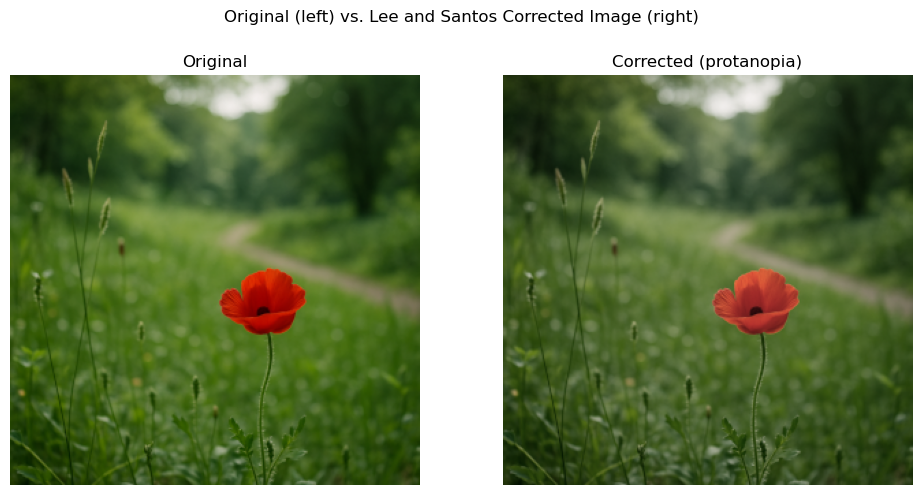

In [259]:
Lee_and_Santos_correction("./image_inputs/chatGPT_single_red_flower.png", "protanopia") 

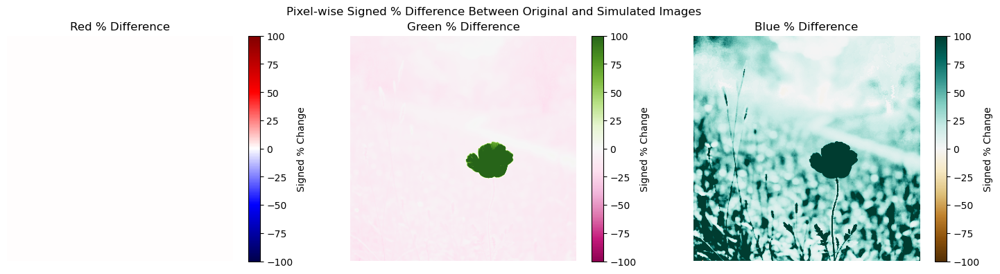

In [260]:
plot_signed_percentage_difference_heatmaps("./image_inputs/chatGPT_single_red_flower.png", "./image_outputs/Lee_Santos_protanopia_chatGPT_single_red_flower.png")

So, as expected, the green and the blue channel values for the red flower have increased. Let's now simulate CVD on the corrected original image.

Let's now equalize the histogram of the non-CVD channels, and analyse the final daltonized output.

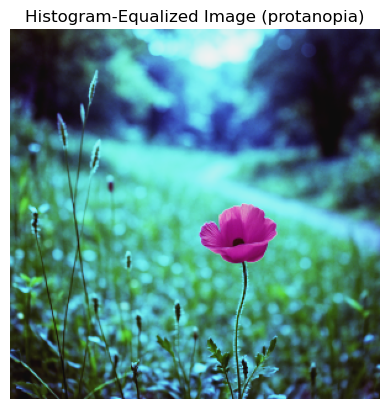

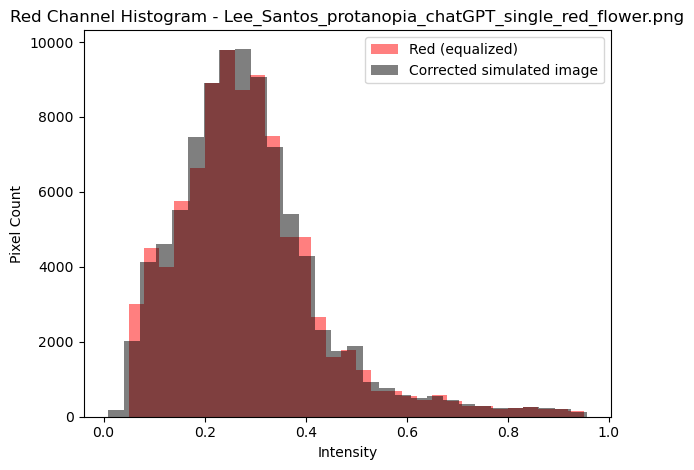

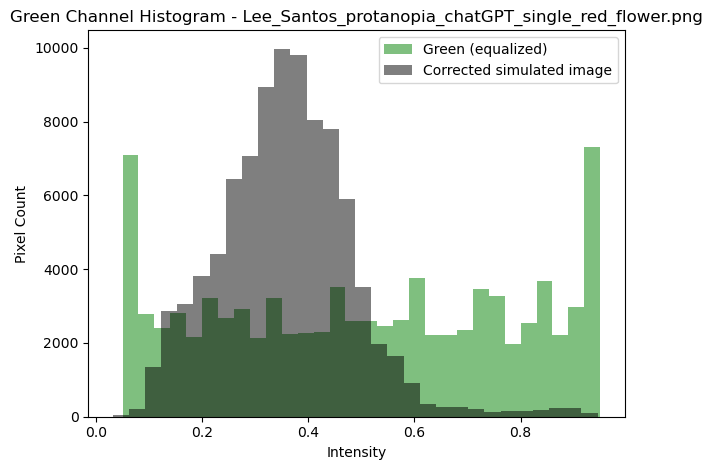

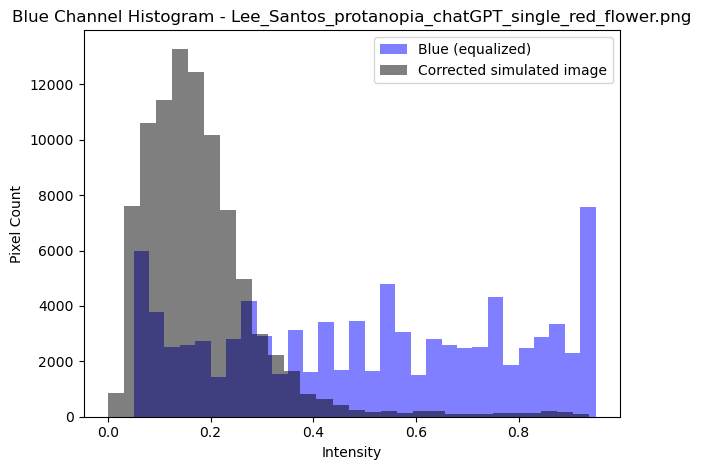

In [264]:
equalize_non_cvd_channels("./image_outputs/Lee_Santos_protanopia_chatGPT_single_red_flower.png", "protanopia")

The green and blue channel seems a lot more spread out, so equalization has ran successfully. Let's now daltonize this.

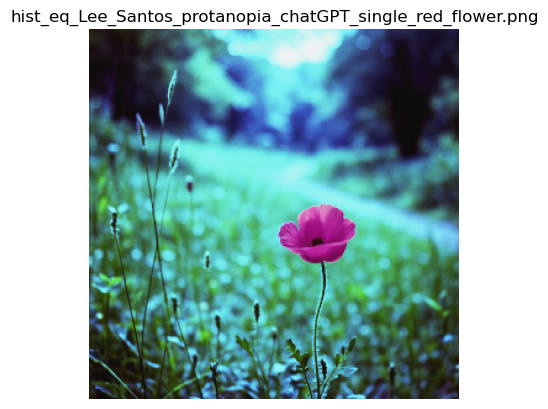

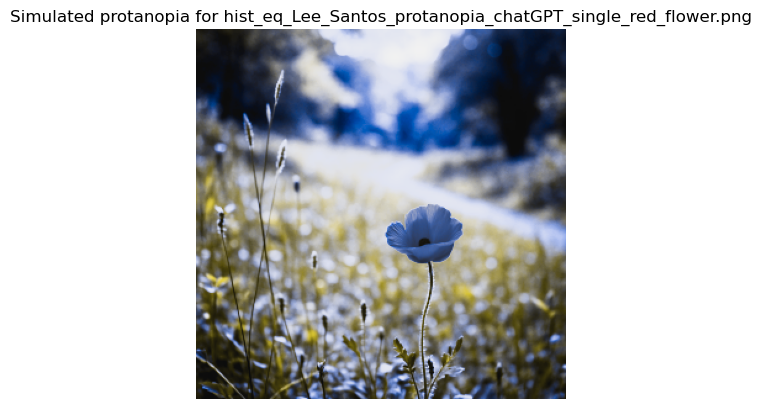

In [265]:
dantonize_Brettel_1997("protanopia", "./image_outputs/hist_eq_Lee_Santos_protanopia_chatGPT_single_red_flower.png", vischeck=True)

As a first impression, the output looks a lot better! The flower is no longer blending in with the background, and with the introduction of blue, the contrast has been improved.

L Channel Std Dev - Simulated Original:  12.81
L Channel Std Dev - Simulated Corrected: 26.69
✅ Contrast increased after correction.


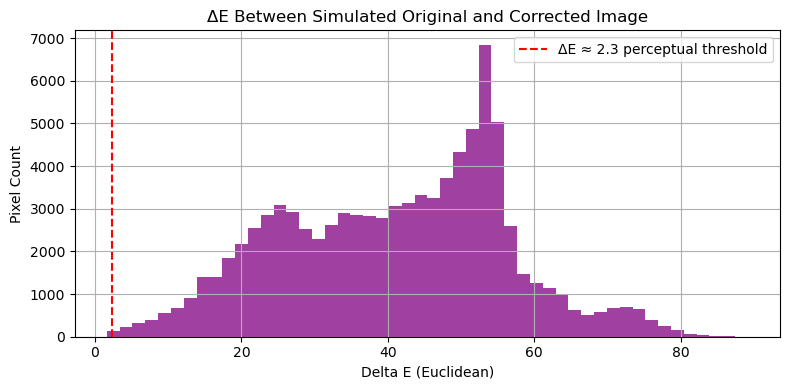

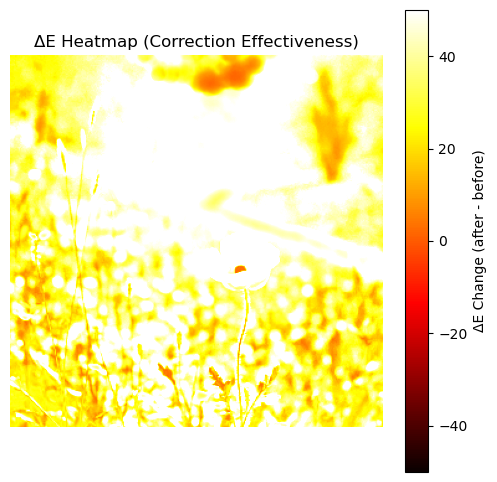

In [299]:
analyze_correction_effectiveness("./image_outputs/protanopia_True_chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_hist_eq_Lee_Santos_protanopia_chatGPT_single_red_flower.png")

The standard deviation of the lightness channel has increased, meaning that the values are more spread out, confirming more contrast has been achieved. The heatmap also shows the Euclidean distances have increased mostly the areas that now appear blue. Let's see the histogram of the L-channel:

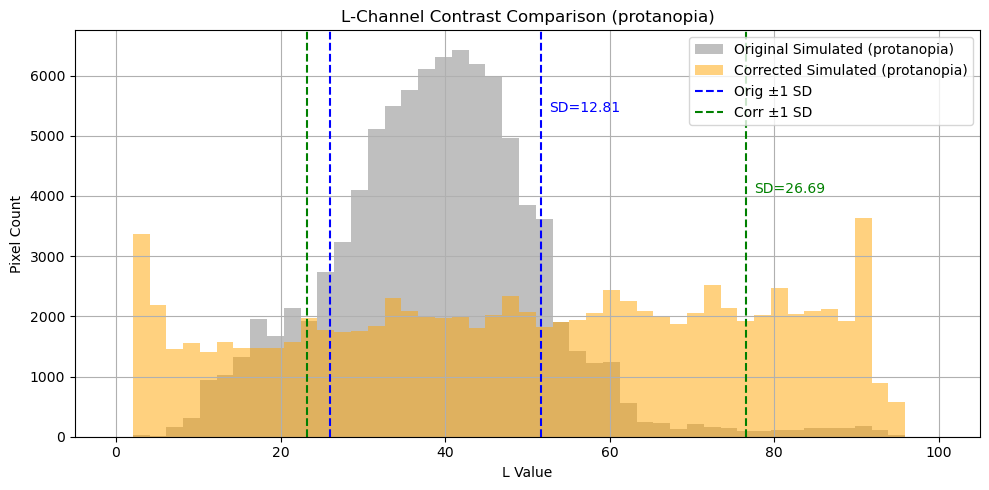

In [303]:
plot_l_channel_histograms("./image_outputs/protanopia_True_chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_hist_eq_Lee_Santos_protanopia_chatGPT_single_red_flower.png", cvd_type="protanopia")

Confirmed - the values are far more spread out, so the histogram equalization has worked, as intended. The distribution has flattened significantly. How would the distribution look like for the chroma contrast though?

Chroma Std Dev - Simulated Original:  9.40
Chroma Std Dev - Simulated Corrected: 12.75
✅ Chroma contrast increased after correction.


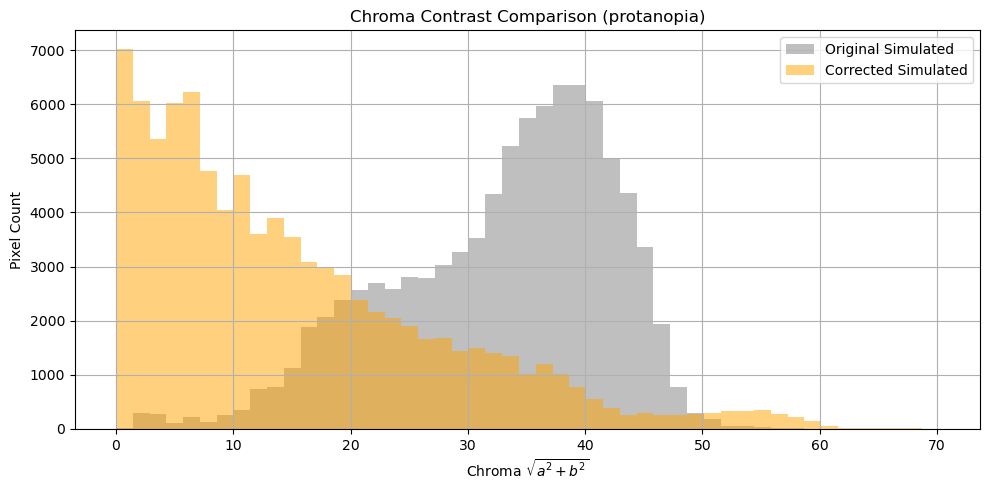

In [304]:
analyze_chroma_contrast("./image_outputs/protanopia_True_chatGPT_single_red_flower.png", "./image_outputs/protanopia_True_hist_eq_Lee_Santos_protanopia_chatGPT_single_red_flower.png", cvd_type="protanopia")

The distribution of chroma values has a higher standard deviation, and values are more spread out. This means that colours have changed from the original, and are more diverse in the newly simulated picture. We have more values that tend to $0$ though, meaning we didn't achieve a saturation effect, and the new image is overall more gray-ish. As we have observed in the picture, the colours are more dynamic with the correction, and the loss in saturation is predominantly at the background. The presence of blue tints for the flower and the grass, gives a nice feeling and makes the picture overall more pleasant to look at.

Let's look at the balls picture now for deuteranopia.

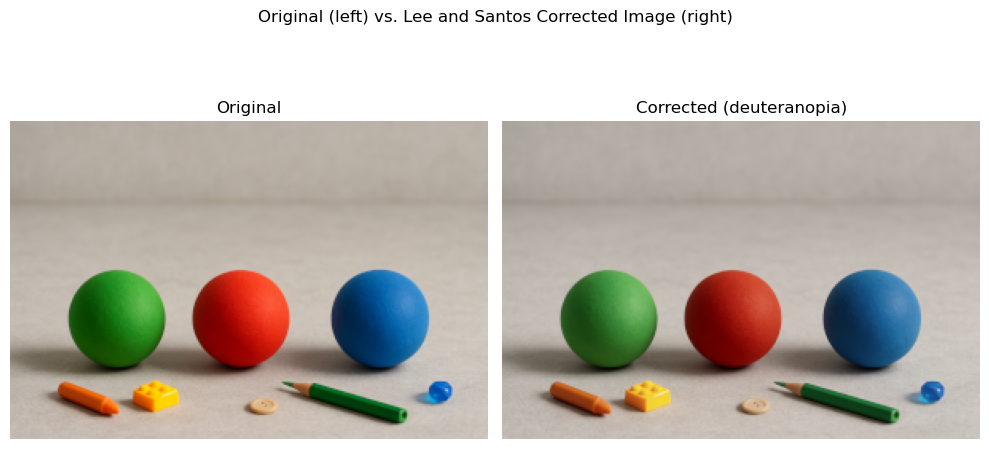

In [308]:
Lee_and_Santos_correction("./image_inputs/chatGPT_find_the_correct_object.png", "deuteranopia")

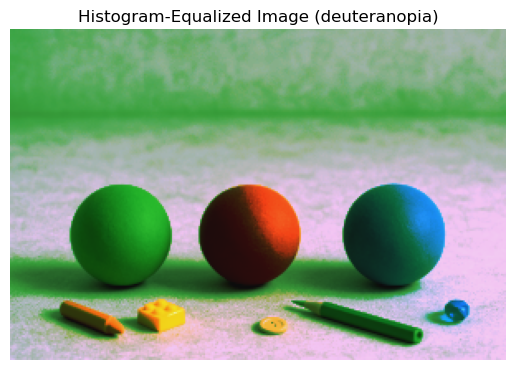

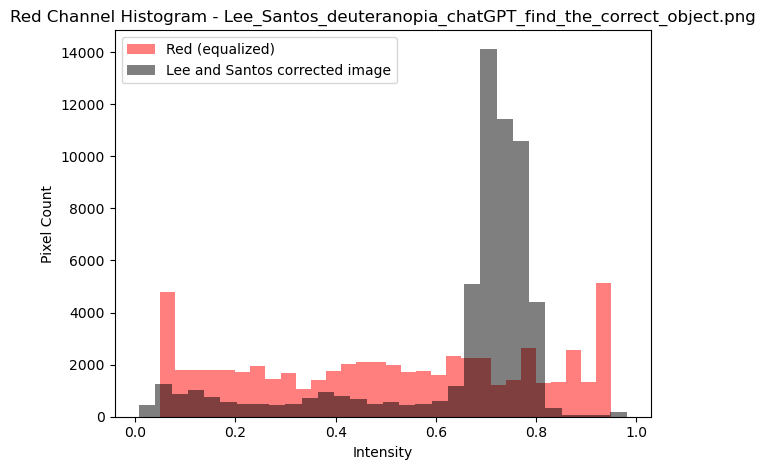

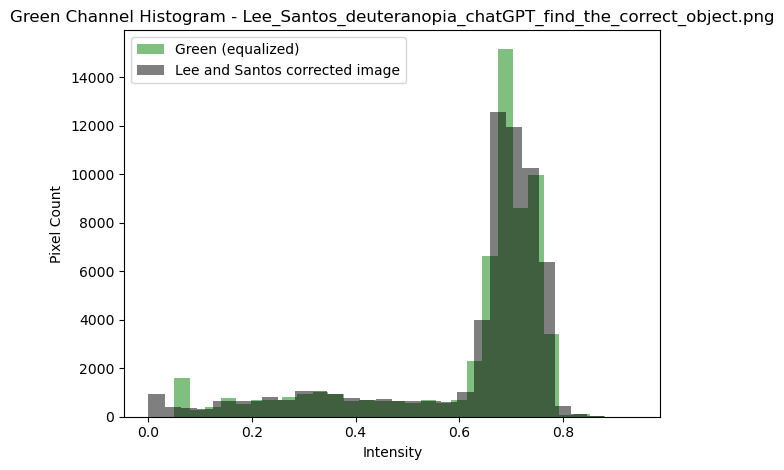

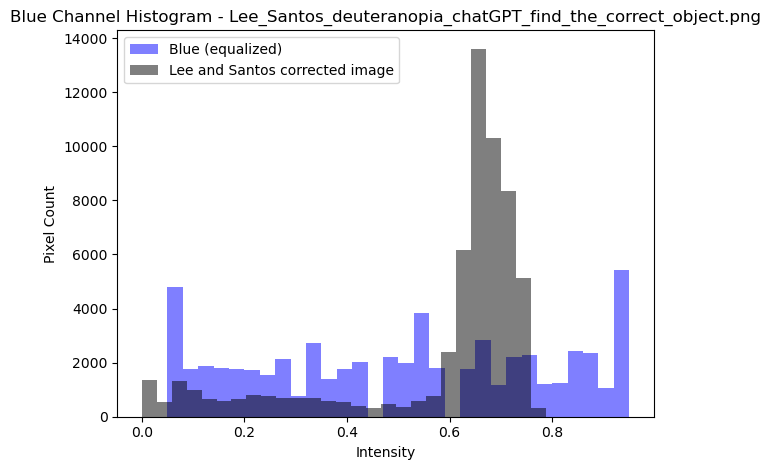

In [306]:
equalize_non_cvd_channels("./image_outputs/Lee_Santos_deuteranopia_chatGPT_find_the_correct_object.png", "deuteranopia")

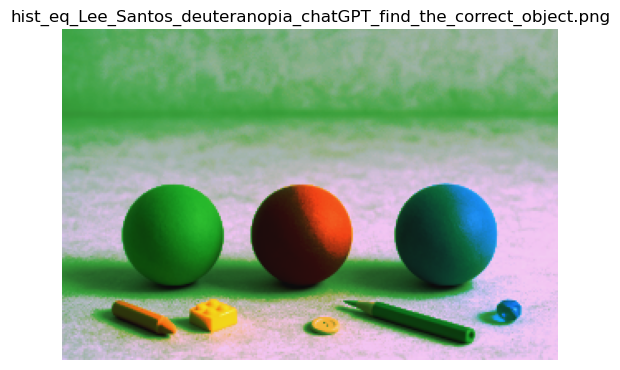

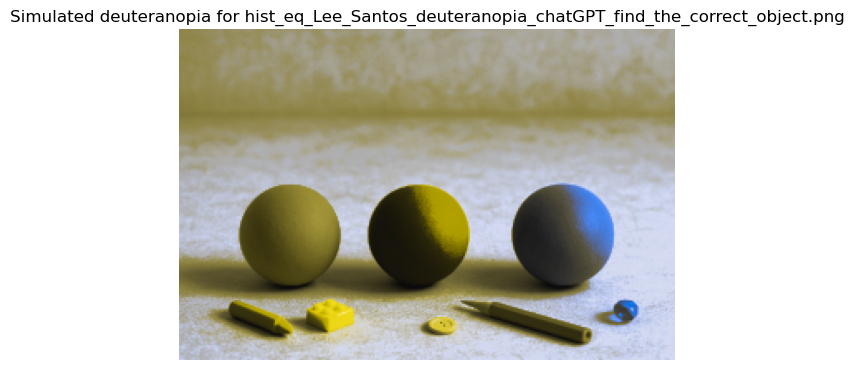

In [272]:
dantonize_Brettel_1997("deuteranopia", "./image_outputs/hist_eq_Lee_Santos_deuteranopia_chatGPT_find_the_correct_object.png", vischeck=True)

L Channel Std Dev - Simulated Original:  16.32
L Channel Std Dev - Simulated Corrected: 20.26
✅ Contrast increased after correction.


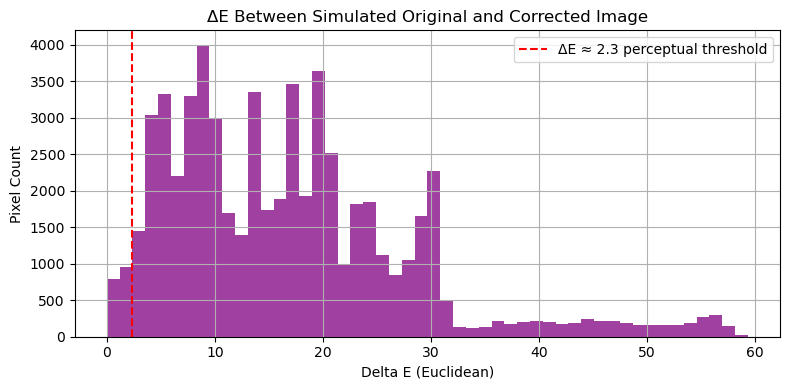

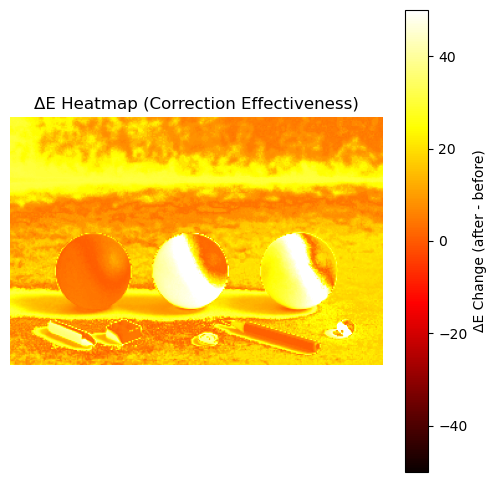

In [298]:
analyze_correction_effectiveness("./image_outputs/deuteranopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/deuteranopia_True_hist_eq_Lee_Santos_deuteranopia_chatGPT_find_the_correct_object.png")

Most perceptual difference has been achieved for the red and blue ball. However, when looking at the final corrected result, they seem very black. This is because the histogram equalization effects seem to have been very strong, thus, making the shadows too dark. Therefore, it is now unclear whether the red and green balls are the same colour or not, as the difference may be attributed simply to shadowing.

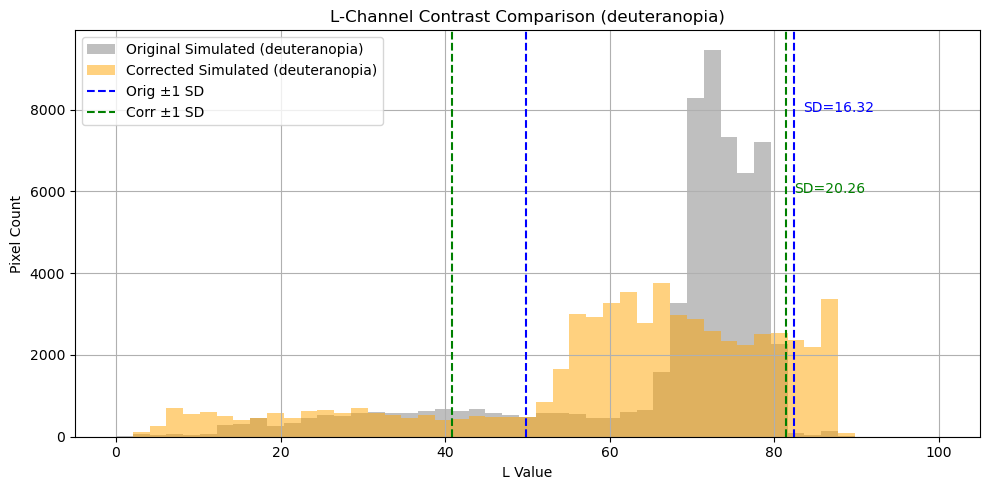

In [309]:
plot_l_channel_histograms("./image_outputs/deuteranopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/deuteranopia_True_hist_eq_Lee_Santos_deuteranopia_chatGPT_find_the_correct_object.png", cvd_type="deuteranopia")

We have achieved much lower $L^{*}$ values, which confirms the previous observation that shadows have gone much darker.

Chroma Std Dev - Simulated Original:  14.84
Chroma Std Dev - Simulated Corrected: 14.27
⚠️ No chroma contrast improvement.


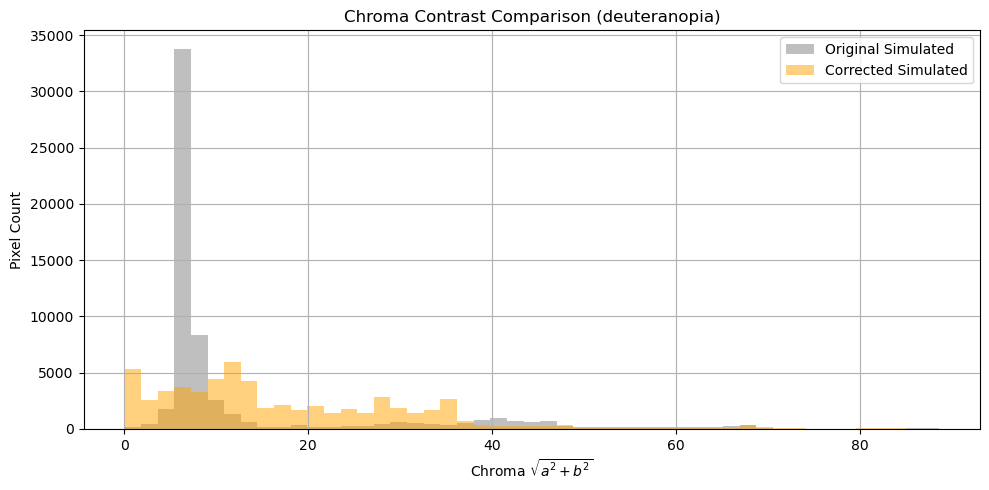

In [310]:
analyze_chroma_contrast("./image_outputs/deuteranopia_True_chatGPT_find_the_correct_object.png", "./image_outputs/deuteranopia_True_hist_eq_Lee_Santos_deuteranopia_chatGPT_find_the_correct_object.png", cvd_type="deuteranopia")

Chroma contrast did not improve - it is not much more spread out, so we have not added additional tints and colours to the picture. Some values are now tending to $0$ which signifies loss in saturation for some pixels. 

Overall, we have had much less success with the balls picture than with the flower, and we cannot distinguish the red from the green ball in the resulting simulated image.

Let's finally see if we would be able to see the five on Ishihara plate $6$.

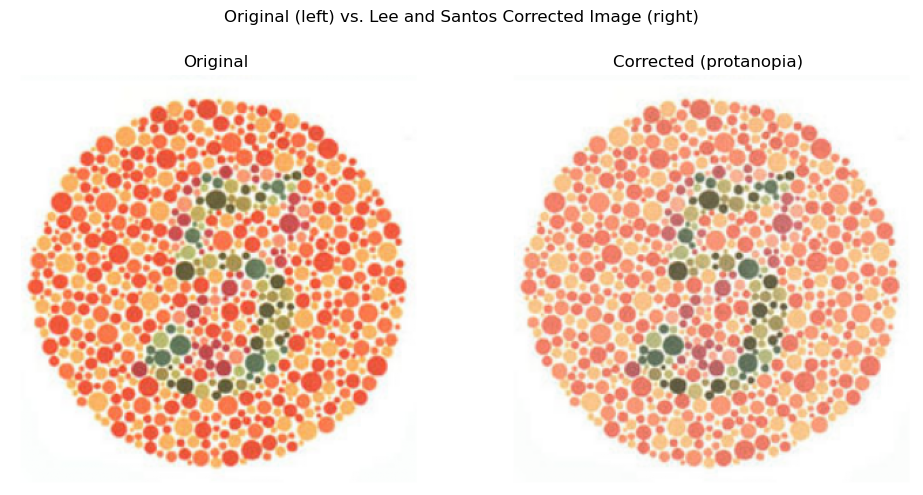

In [312]:
Lee_and_Santos_correction("./image_inputs/Ishihara_plate_6.png", "protanopia")

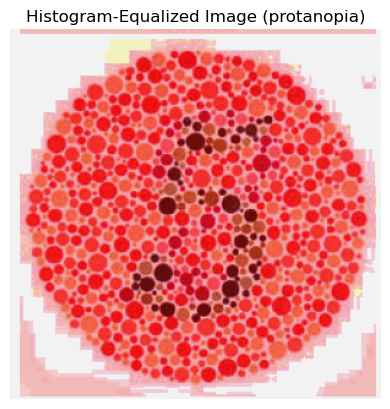

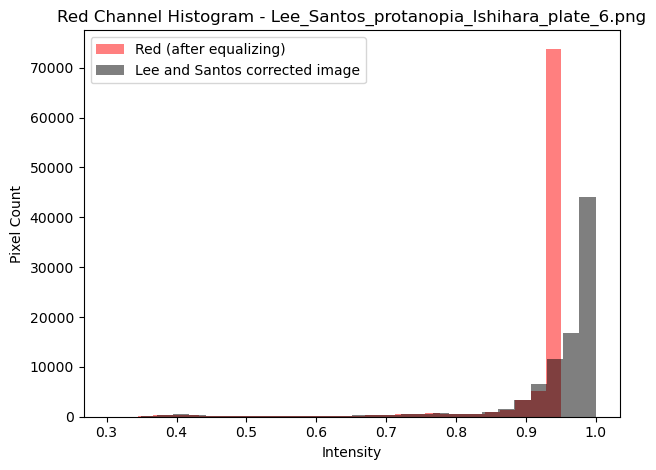

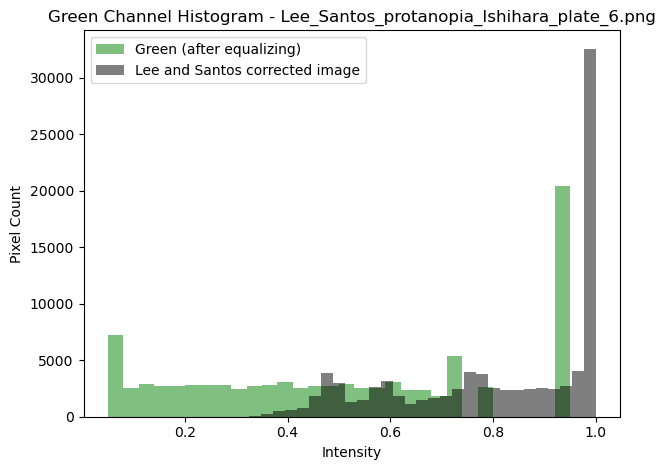

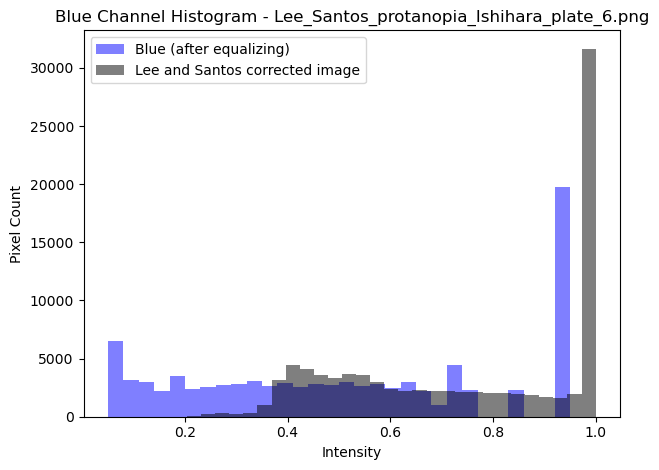

In [313]:
equalize_non_cvd_channels("./image_outputs/Lee_Santos_protanopia_Ishihara_plate_6.png", "protanopia")

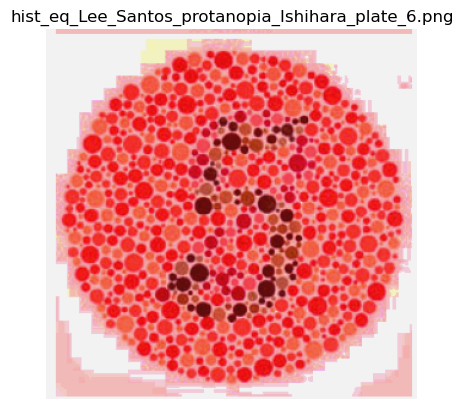

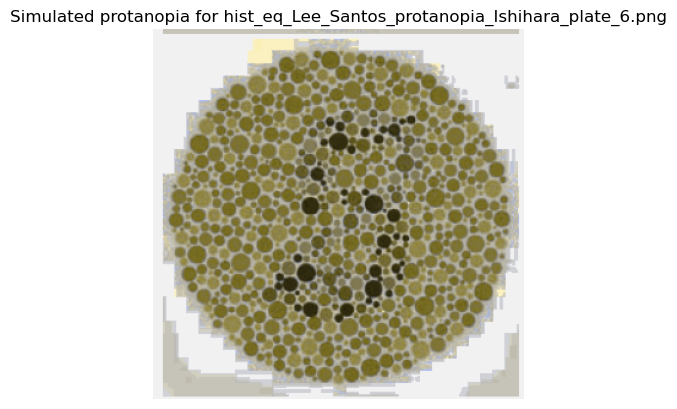

In [314]:
dantonize_Brettel_1997("protanopia", "./image_outputs/hist_eq_Lee_Santos_protanopia_Ishihara_plate_6.png", vischeck=True)

L Channel Std Dev - Simulated Original:  17.79
L Channel Std Dev - Simulated Corrected: 20.02
✅ Contrast increased after correction.


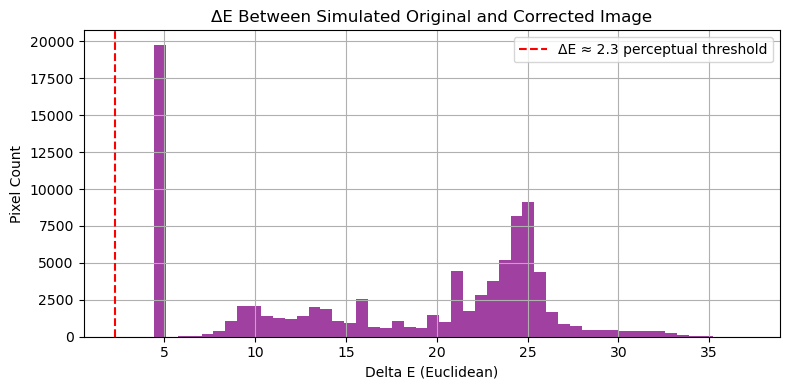

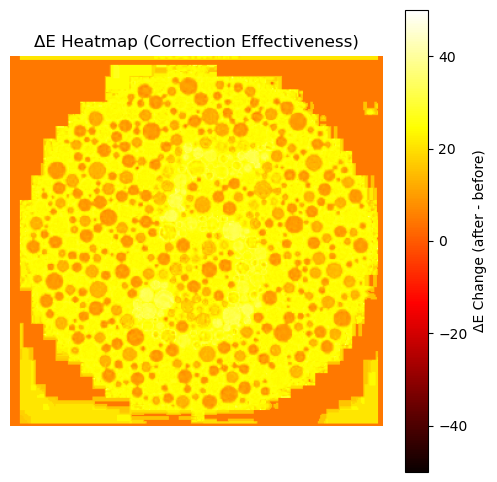

In [315]:
analyze_correction_effectiveness("./image_outputs/protanopia_True_Ishihara_plate_6.png", "./image_outputs/protanopia_True_hist_eq_Lee_Santos_protanopia_Ishihara_plate_6.png")

We see that there is a lot of perceptual difference added where the number five is, and for most of the background. Also evidently from the simulated picture itself, we are now able to see the number five relatively clearly. 

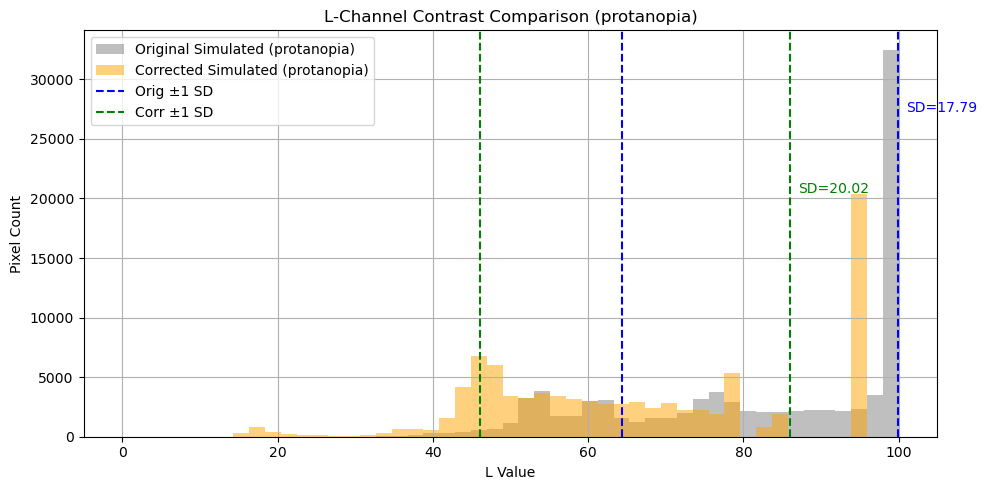

In [316]:
plot_l_channel_histograms("./image_outputs/protanopia_True_Ishihara_plate_6.png", "./image_outputs/protanopia_True_hist_eq_Lee_Santos_protanopia_Ishihara_plate_6.png", cvd_type="protanopia")

The resulting simulated image is much darker, and this is evident from the L-channel contrast histogram. The values are on average lower, and the standard deviation remained relatively the same.

Chroma Std Dev - Simulated Original:  16.41
Chroma Std Dev - Simulated Corrected: 14.16
⚠️ No chroma contrast improvement.


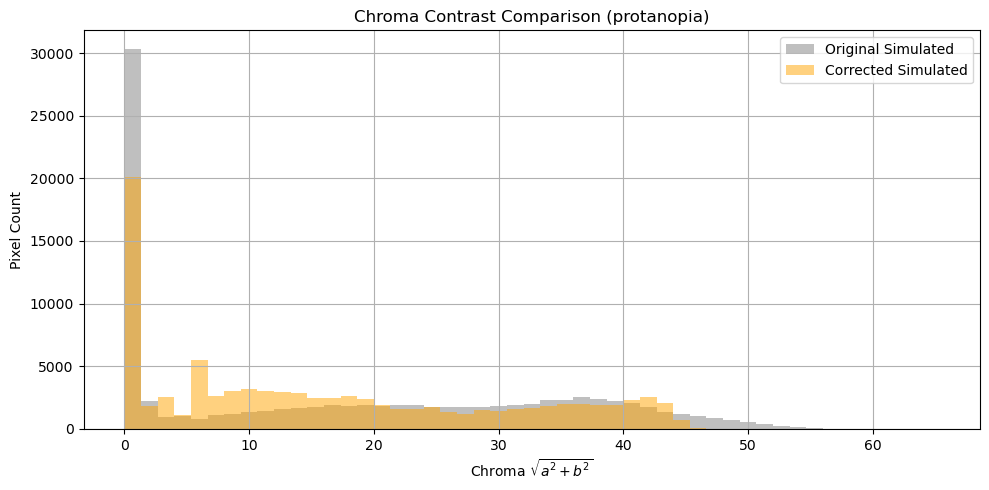

In [317]:
analyze_chroma_contrast("./image_outputs/protanopia_True_Ishihara_plate_6.png", "./image_outputs/protanopia_True_hist_eq_Lee_Santos_protanopia_Ishihara_plate_6.png", cvd_type="protanopia")

Chroma contrast did not improve, as we have not changed the shape of the distribution much. The simulated picture has similar colours as the original Brettel CVD simulation. The only difference is the fact that we now see the five more clearly.

**TODO remove cvd_type input from functions. Change Lee and santos correction function name**

### 5.3. Summary of results

So, do we find that the Santos and Lee (2010) correction works better than the k-means clustering one? Not sure. 

For the flower picture, it produced good results, added more colours to the end simulated result, and produced a very visually pleasing end result. 

For the balls picture, on the contrary, we got shadows that are way too dark, no additional colours, and a worse looking result (while still unable to tell apart the green and the red ball). 

Finally, for Ishihara plate $6$, we ended up being able to differentiate the correct number on the plate, even if the resulting simulated picture was too dark, and the colours relatively similar to the once from the Brettel result.

Verdict? The two corrections could be used situationally, as we cannot firmly tell one produces a better result than the other.

## 6. Concluding remarks

This project set out to explore the simulation and correction of color vision deficiency (CVD), focusing on perceptual models and practical image processing techniques. Through an in-depth study of color spaces, CVD simulation via the Viénot-Brettel model, and two different correction strategies—one using k-means clustering in Lab space, the other inspired by Lee and Santos—we achieved compelling visual and analytical results. While challenges arose in color modeling and perceptual analysis, the outcome demonstrates the potential of accessible, perceptually-informed correction methods to improve image distinguishability for users with CVD.

### 6.1. What went well 

Several aspects of the project succeeded beyond initial expectations. First and foremost, the CVD simulation closely followed the Viénot et al. model, and its implementation produced reliable and perceptually accurate simulations for protanopia, deuteranopia, and tritanopia. The use of LMS space and spectral projection made the simulation results visually plausible and consistent with literature and online tools.

Both correction methods—the k-means color clustering approach and the Lee and Santos delta-E maximization strategy—also worked well. The k-means method offered an intuitive and interpretable way to shift confused clusters, while the Lee and Santos correction provided a more continuous and perceptually driven enhancement. The visual difference and perceptual heatmaps confirmed that both strategies resulted in color redistributions that could aid distinguishability.

Moreover, incorporating perceptual color metrics like Delta E, chroma, and hue angle offered strong insights into the qualitative nature of corrections. Visualizations such as histograms, scatter plots, and heatmaps enriched the analysis and confirmed perceptual improvement in many corrected cases.

### 6.2. What didn't go well 

Not all components of the project worked seamlessly. One of the key challenges was interpreting color similarity under CVD conditions, especially when comparing original and corrected images. Although Delta E provides a perceptual metric, it does not always perfectly correspond to subjective improvements in color differentiation—especially in simulated vision spaces.

Another difficulty was maintaining color naturalness and aesthetic integrity. Some corrected images, especially from the k-means method, introduced blue tints or color shifts that, while technically distinguishable, could feel artificial. Tuning the correction strength to balance visibility and realism was a persistent issue.

Additionally, working with one-dimensional clustering (e.g., only on a or b channels) introduced edge cases and less stable results when image content lacked dominant hues. In such cases, cluster assignments became less meaningful, leading to weaker correction.

### 6.3. What could have gone better 

The project could have benefitted from more robust validation beyond visual inspection and basic perceptual metrics. User testing or simulated color distinguishability tasks (e.g., object detection with CVD filters) could have provided stronger empirical support for the effectiveness of each correction strategy.

A more flexible or adaptive clustering strategy—for example, using adaptive k or clustering in joint color-space and spatial domains—might have improved the k-means-based correction, reducing artifacts and overcorrection.

Also, while the current correction pipeline uses perceptual color space (Lab), future work could explore constrained optimization directly in LMS or JzAzBz space, which may offer better uniformity and performance in edge cases. The use of edge-aware filters or local contrast enhancement could also complement global corrections to preserve detail.

### 6.4. What did I learn along the way 

This project was a deep dive into the intersection of human vision, perceptual modeling, and image processing. A major takeaway was understanding the richness of color representation and how it can be transformed for accessibility purposes. Learning about the LMS vision system, color appearance models, and non-Euclidean color spaces provided valuable insight into how color is perceived and measured.

I also developed strong skills in color space conversions, custom clustering algorithms, and visualization of perceptual metrics. More importantly, I gained an appreciation for the subjective and contextual nature of color perception—something not easily captured by purely mathematical models.

Finally, this project showed how computational tools can make a real difference in accessibility. By tailoring color representations for CVD users, even small algorithmic changes can have meaningful impact. It’s a reminder that inclusive design is not just a technical challenge, but a human one as well.

[1] This

## Works cited:

### Written sources

Enchroma website, 2025 https://enchroma.com/pages/types-of-color-blindness

NHS website, 2025 https://www.nhs.uk/conditions/colour-vision-deficiency/

Colour blind awareness https://www.colourblindawareness.org/colour-blindness/causes-of-colour-blindness/inherited-colour-vision-deficiency/

Colour spaces 

https://en.wikipedia.org/wiki/Color_space 

https://photo.stackexchange.com/questions/48984/what-is-the-difference-or-relation-between-a-color-model-and-a-color-space

list https://en.wikipedia.org/wiki/List_of_color_spaces_and_their_uses 

https://www.pantone.com/articles/color-fundamentals/color-models-explained

### Pictures

Fig 1. https://my.clevelandclinic.org/health/body/photoreceptors-rods-and-cones

Fig 2(a)(b)(c) https://cambiocteach.com/accessibility/colourblind/ 

Fig 3(a)(b)(c)(d)(e) https://challengetb.org/publications/tools/country/Ishihara_Tests.pdf 

Fig 3(f) https://www.reddit.com/r/ColorBlind/comments/yqzurv/hi_me_again_with_another_set_of_tritan_plates_ive/

Table 1. Kolb et al (1995) https://www.ncbi.nlm.nih.gov/books/NBK11538/table/ch28kallcolor.T1/

Brettel, H., Viénot, F., Mollon, J.D., 1997. Computerized simulation of color appearance for dichromats. J. Opt. Soc. Am. A 14, 2647. https://doi.org/10.1364/JOSAA.14.002647
Color space, 2025. . Wikipedia.

Colour Blindness - CamBioc Teaching, 2021. URL https://cambiocteach.com/accessibility/colourblind/ (accessed 5.2.25).

Colour vision deficiency (colour blindness) [WWW Document], 2017. . nhs.uk. URL https://www.nhs.uk/conditions/colour-vision-deficiency/ (accessed 5.2.25).

Common Types of Color Blindness | Types of Color Vision [WWW Document], n.d. . EnChroma. URL https://enchroma.com/pages/types-of-color-blindness (accessed 5.2.25).

Cross product, 2025. . Wikipedia.

Haugene, T., 2014. What is the difference or relation between a Color Model and a Color Space? Photography Stack Exchange.

Henderson, A.J., 2014. Answer to “What is the difference or relation between a Color Model and a Color Space?” Photography Stack Exchange.

Inherited Colour Vision Deficiency, n.d. . Colour Blind Awareness. URL https://www.colourblindawareness.org/colour-blindness/causes-of-colour-blindness/inherited-colour-vision-deficiency/ (accessed 5.2.25).

Julian, 2014. Answer to “What is the difference or relation between a Color Model and a Color Space?” Photography Stack Exchange.

Klecker, H., 2014. Answer to “What is the difference or relation between a Color Model and a Color Space?” Photography Stack Exchange.

List of color spaces and their uses, 2025. . Wikipedia.

Nothingtoseehere, 2014. Answer to “What is the difference or relation between a Color Model and a Color Space?” Photography Stack Exchange.

Pantone, n.d. What are the Different Color Models? [WWW Document]. Pantone. URL https://www.pantone.com/articles/color-fundamentals/color-models-explained (accessed 5.2.25).

Sanguerine, 2022. Hi, me again, with another set of tritan plates. I’ve been mostly testing colors so far and here are samples from my intended final project, although it is far from completed. I used less bright scheme this time. All feedback welcome, please refer to my comment for results and some additional info. r/ColorBlind.

Shaping Up What You See: Understanding Rod & Cone Photoreceptors [WWW Document], n.d. . Cleveland Clinic. URL https://my.clevelandclinic.org/health/body/photoreceptors-rods-and-cones (accessed 5.2.25).

Understanding LMS-based Color Blindness Simulations [WWW Document], 2021. . DaltonLens. URL https://daltonlens.org/understanding-cvd-simulation/ (accessed 5.2.25).
